# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [4]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [5]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [6]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [7]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [8]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)
    
    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = ((1 - gradient_norm.mean())**2).mean()
    #### END CODE HERE ####
    return penalty

In [9]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -crit_fake_pred.mean()
    #### END CODE HERE ####
    return gen_loss

In [11]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [15]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + (c_lambda * gp)
    #### END CODE HERE ####
    return crit_loss

In [16]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: 0.0045140814036130905, critic loss: 0.5856291832998396


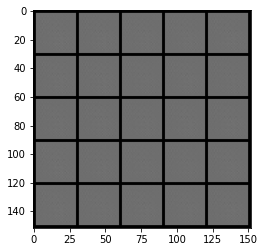

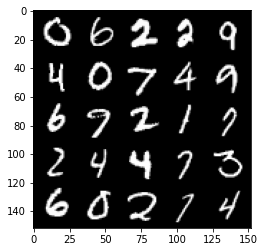

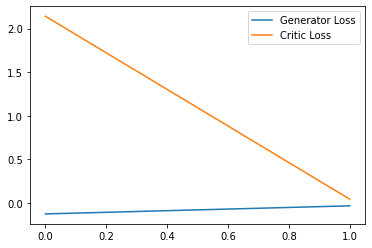

Step 100: Generator loss: 2.248120295703411, critic loss: -4.388126683115959


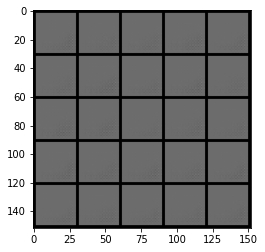

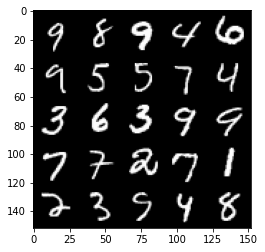

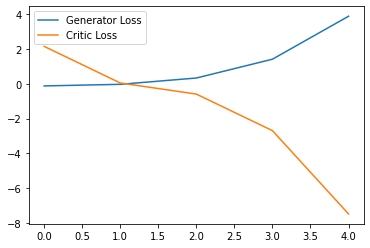

Step 150: Generator loss: 2.5141372585296633, critic loss: -15.649388679504392


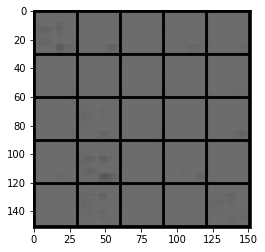

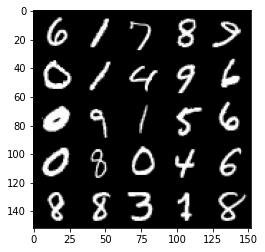

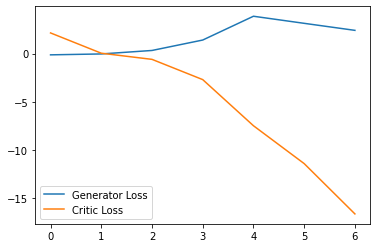

Step 200: Generator loss: -0.42690526857972144, critic loss: -32.683597908020026


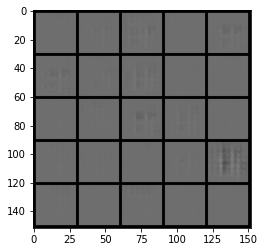

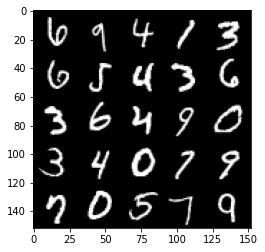

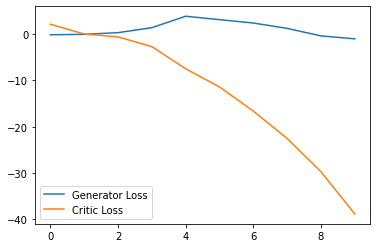

Step 250: Generator loss: -0.6917673423886299, critic loss: -61.44408628845215


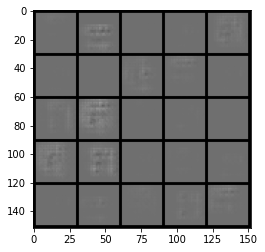

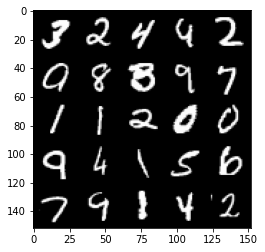

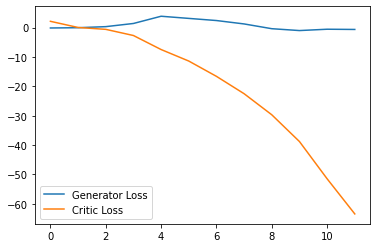

Step 300: Generator loss: -1.6145063352584839, critic loss: -100.31954196166991


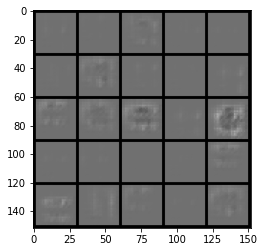

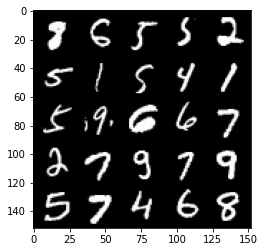

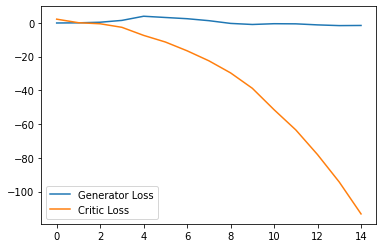

Step 350: Generator loss: -0.4175006542354822, critic loss: -148.76129232788085


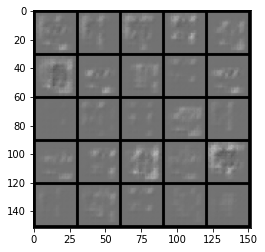

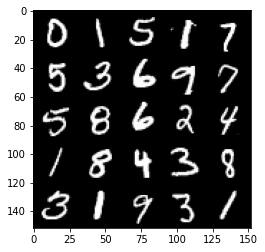

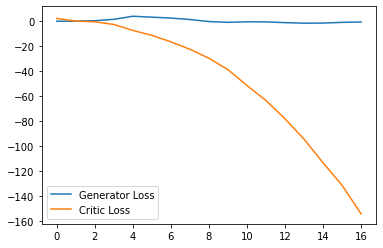

Step 400: Generator loss: 3.4618378615379335, critic loss: -195.01975311279293


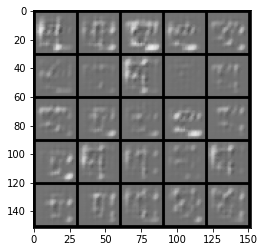

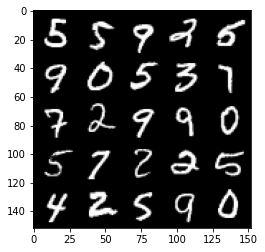

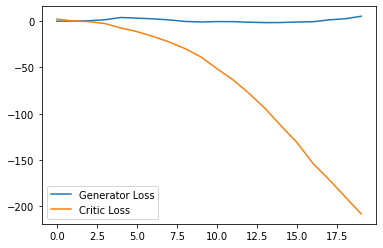

Step 450: Generator loss: -7.176444988250733, critic loss: -211.50834194946293


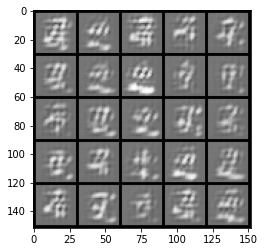

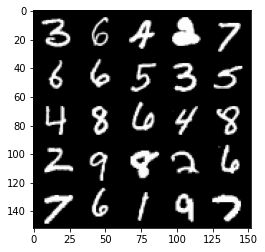

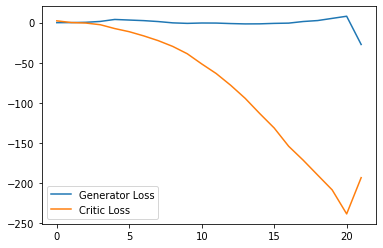

Step 500: Generator loss: -12.787547278404237, critic loss: -202.46317160034175


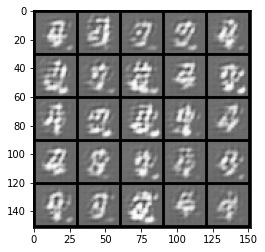

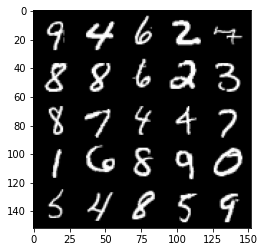

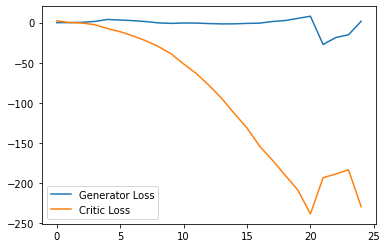

Step 550: Generator loss: 4.68405430316925, critic loss: -325.09335900878904


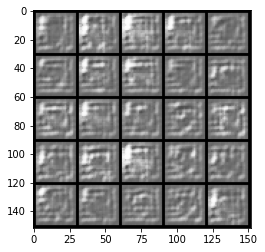

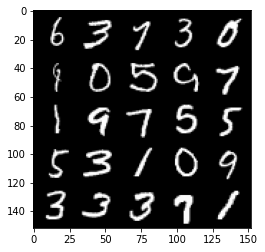

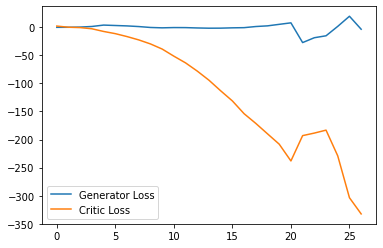

Step 600: Generator loss: -1.018129470348358, critic loss: -385.1157425537109


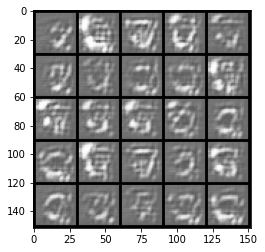

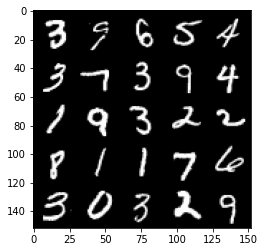

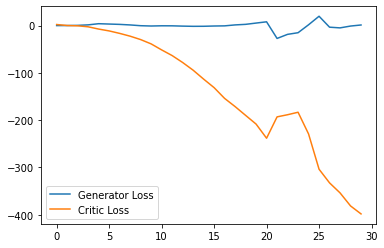

Step 650: Generator loss: -11.904547892808914, critic loss: -370.42537088012693


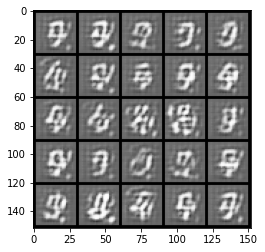

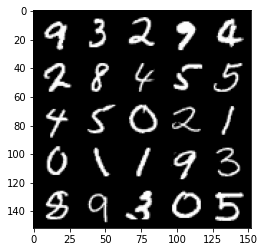

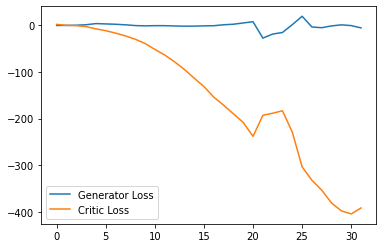

Step 700: Generator loss: -23.569290266036987, critic loss: -288.12523553466787


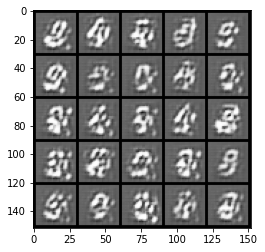

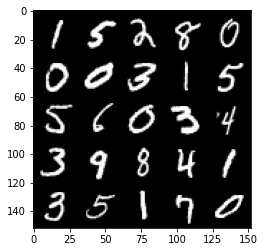

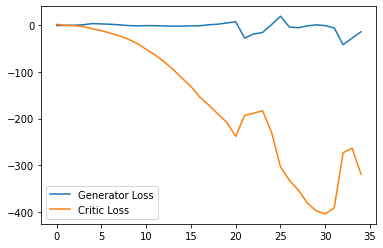

Step 750: Generator loss: -30.926305692195893, critic loss: -247.42085623168947


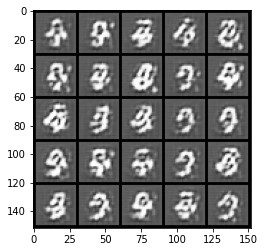

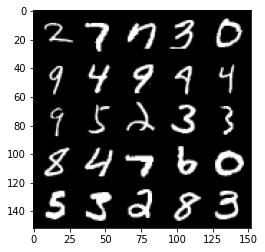

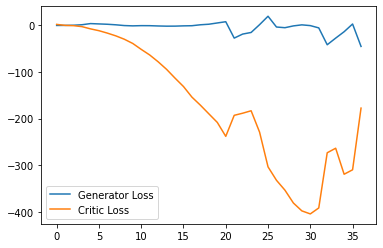

Step 800: Generator loss: -41.43499209403992, critic loss: -146.46718681335457


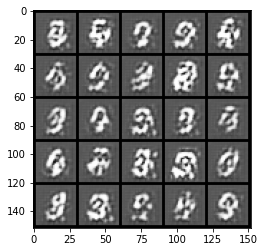

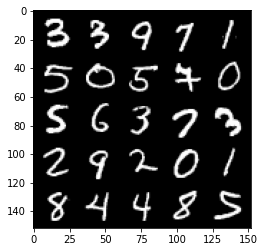

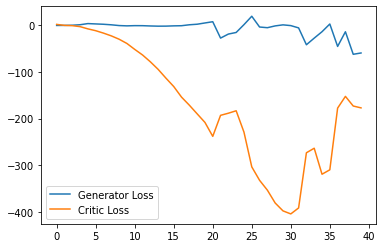

Step 850: Generator loss: -78.640141248703, critic loss: -169.6967791137695


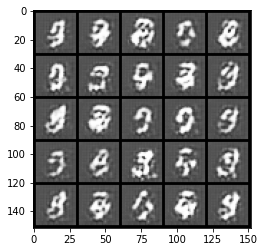

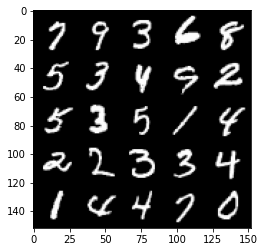

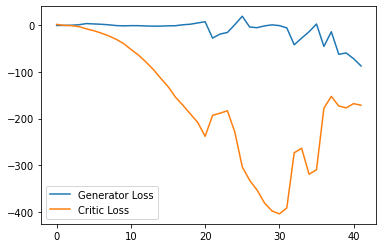

Step 900: Generator loss: -20.375180945396423, critic loss: -215.45628686523446


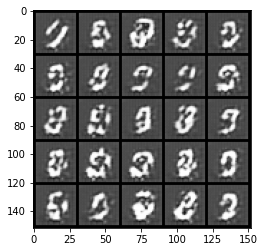

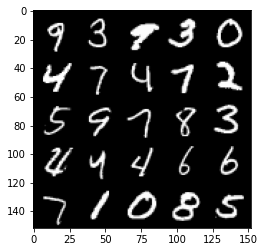

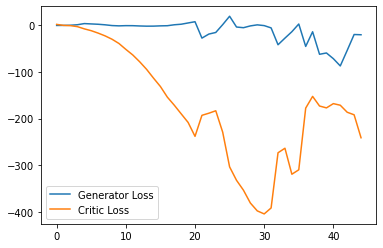

Step 950: Generator loss: -40.74849710464478, critic loss: -135.276967124939


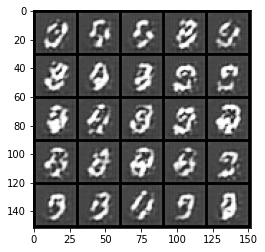

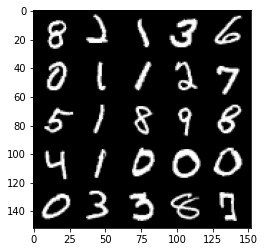

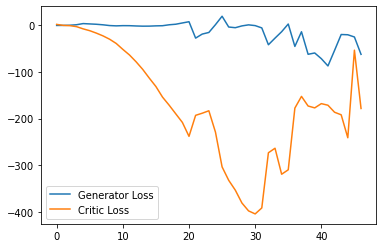

Step 1000: Generator loss: -35.51662492513657, critic loss: -139.32117950439454


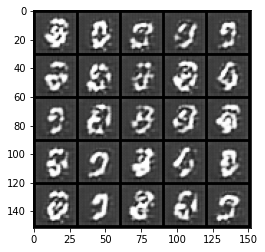

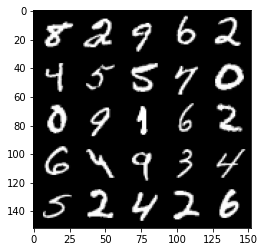

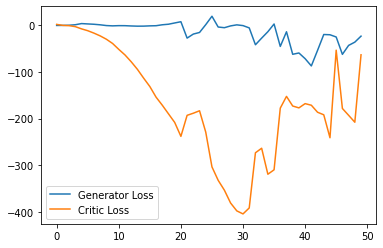

Step 1050: Generator loss: -53.645496057271956, critic loss: -154.9030154724121


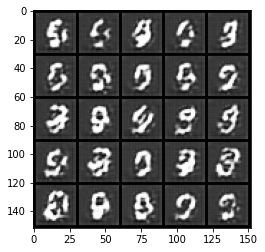

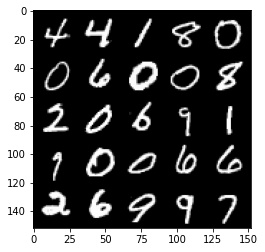

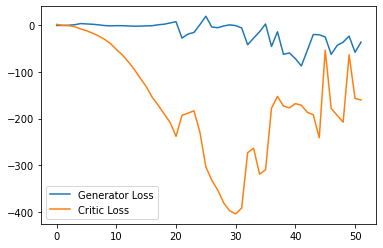

Step 1100: Generator loss: -62.6025382232666, critic loss: -97.93520215606688


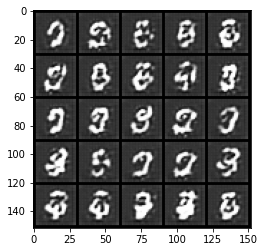

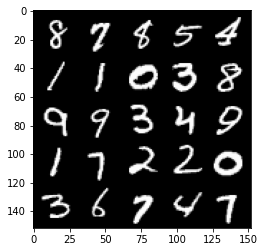

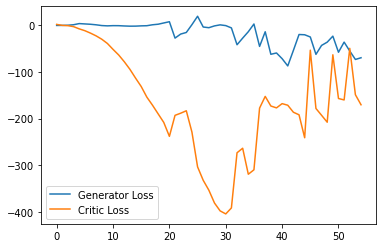

Step 1150: Generator loss: -21.900653953552247, critic loss: 24.06409678268432


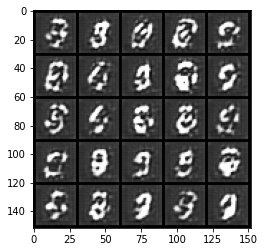

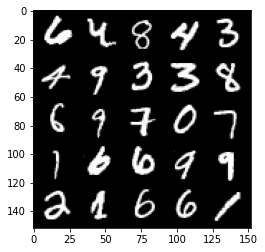

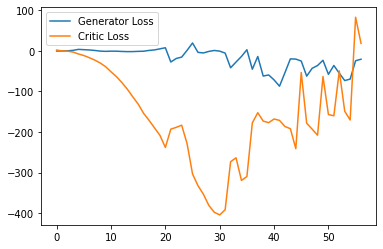

Step 1200: Generator loss: -23.53665771484375, critic loss: 7.286387119293215


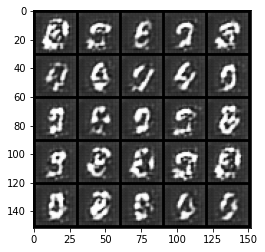

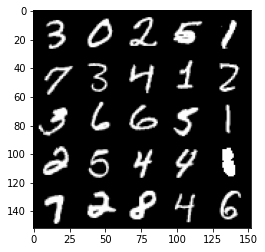

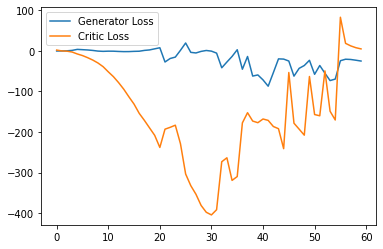

Step 1250: Generator loss: -27.090008201599122, critic loss: 2.278122074127197


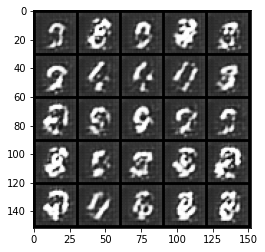

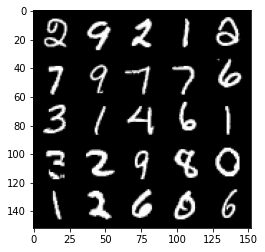

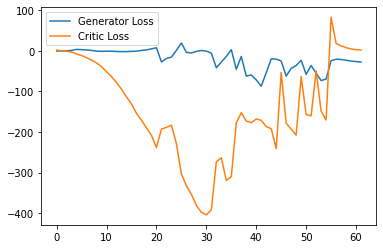

Step 1300: Generator loss: -30.38691394805908, critic loss: 0.04719507026672362


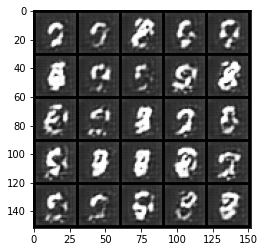

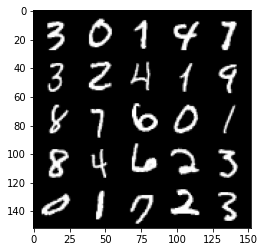

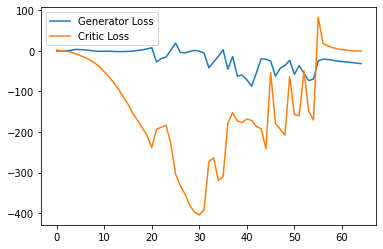

Step 1350: Generator loss: -34.03059913635254, critic loss: 0.1580783920288086


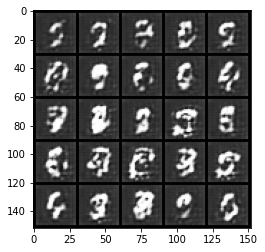

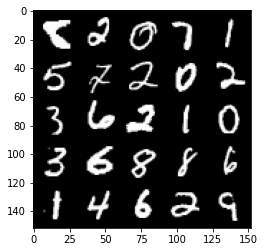

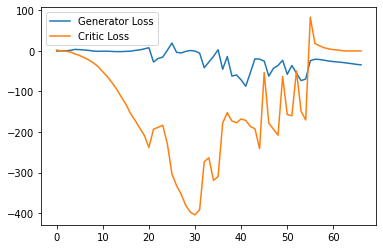

Step 1400: Generator loss: -36.97676773071289, critic loss: 0.5332757949829102


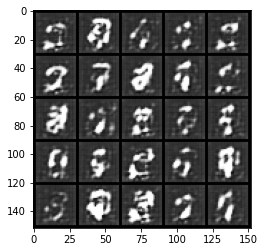

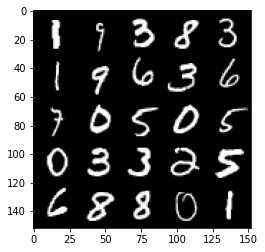

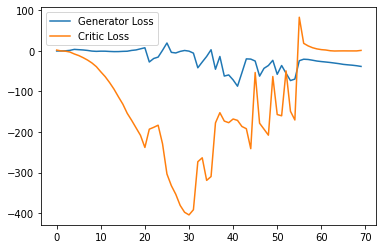

Step 1450: Generator loss: -39.14646476745605, critic loss: 0.13686319065093988


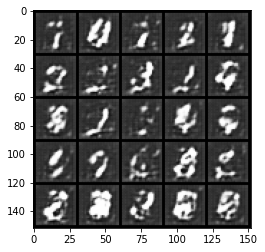

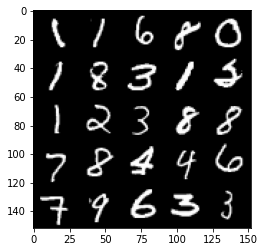

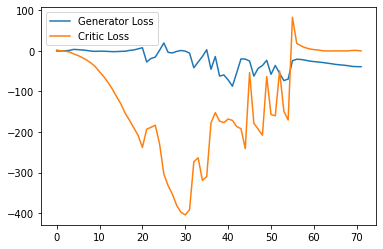

Step 1500: Generator loss: -42.105091934204104, critic loss: -7.713814317703245


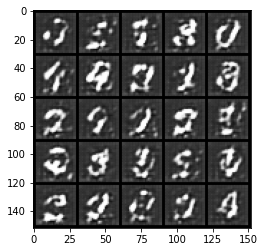

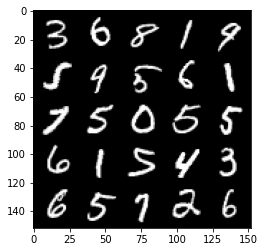

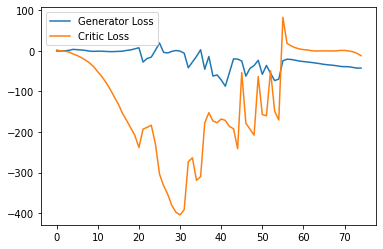

Step 1550: Generator loss: -42.84298683166504, critic loss: -15.754651483535765


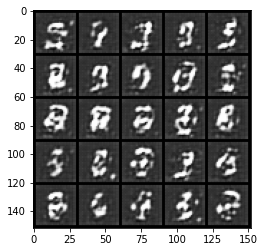

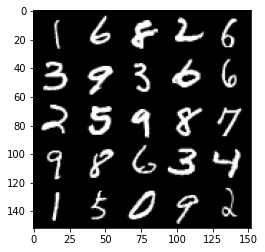

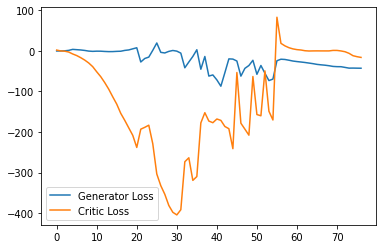

Step 1600: Generator loss: -41.83214973449707, critic loss: -21.883380578994753


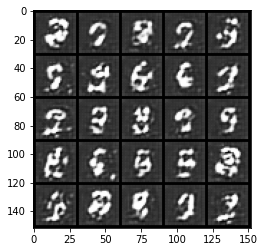

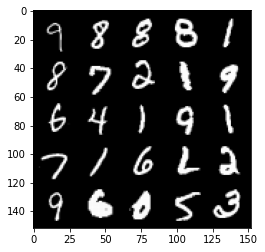

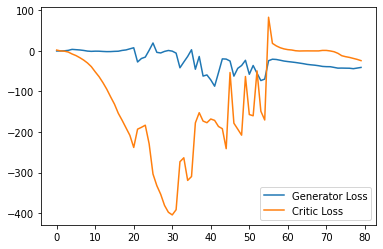

Step 1650: Generator loss: -35.28077281951904, critic loss: -32.36368201446533


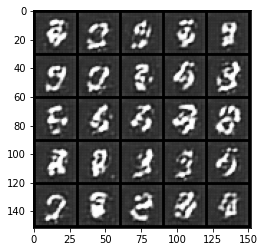

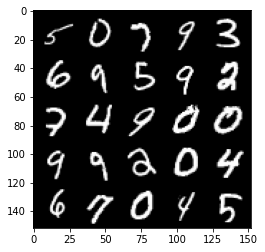

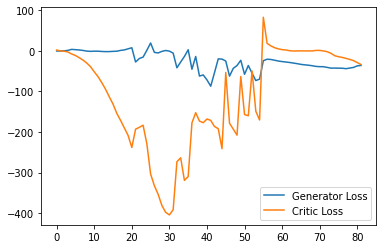

Step 1700: Generator loss: -35.56245334625244, critic loss: -33.54445698928832


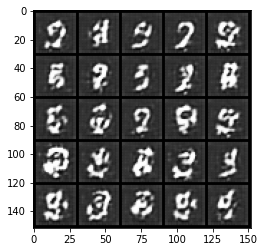

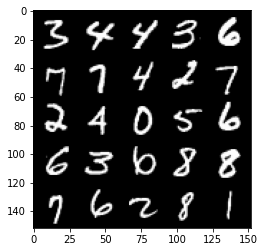

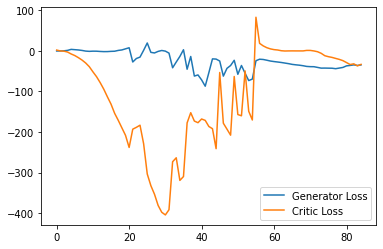

Step 1750: Generator loss: -39.82425754547119, critic loss: -43.53160527038573


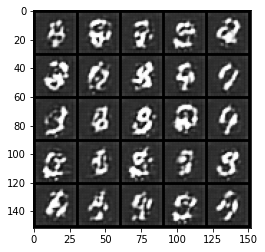

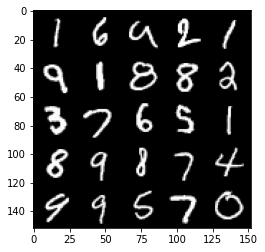

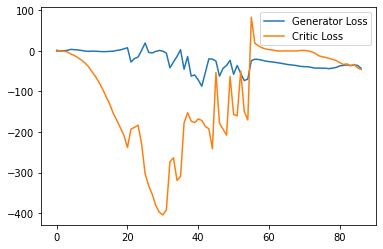

Step 1800: Generator loss: -38.22357471466064, critic loss: -46.07554705047606


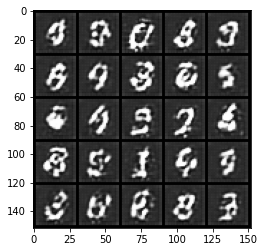

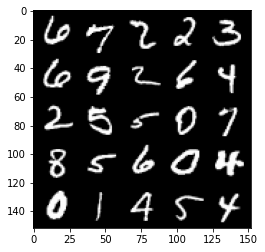

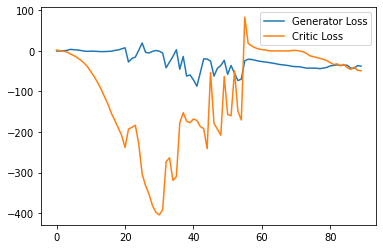

Step 1850: Generator loss: -38.50069581627846, critic loss: -32.20531767082214


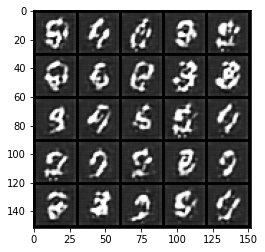

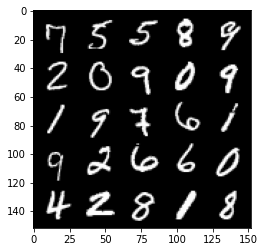

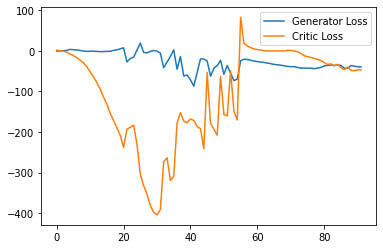

Step 1900: Generator loss: -42.169098472595216, critic loss: -24.104570199966425


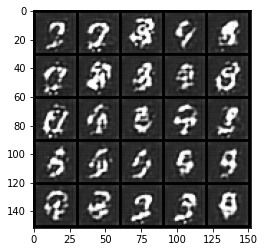

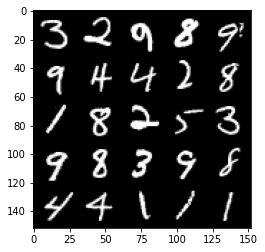

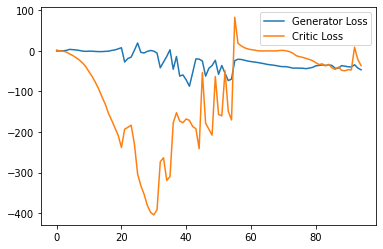

Step 1950: Generator loss: -41.478498973846435, critic loss: -40.08746178436279


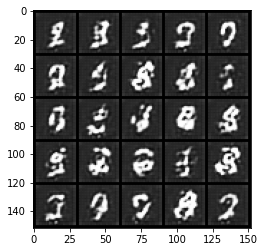

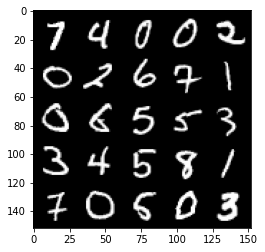

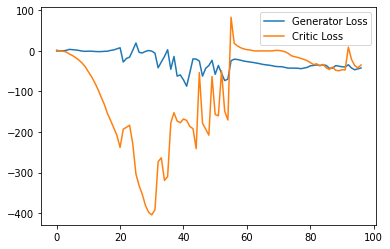

Step 2000: Generator loss: -40.117600765228275, critic loss: -28.1946747303009


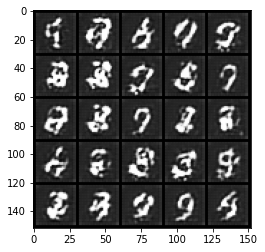

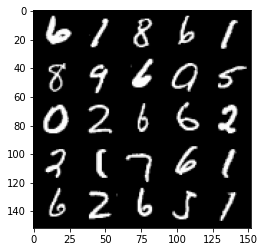

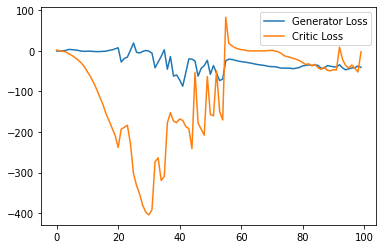

Step 2050: Generator loss: -41.057892417907716, critic loss: -18.23827887535095


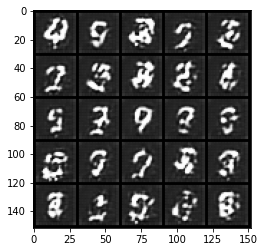

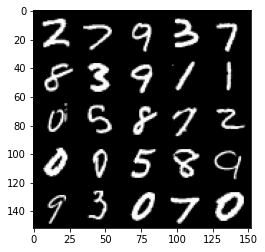

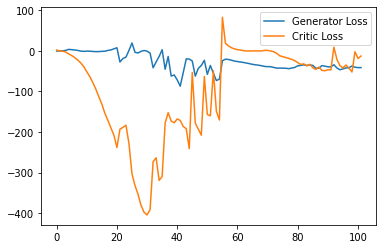

Step 2100: Generator loss: -39.75797433137894, critic loss: -21.662843190193186


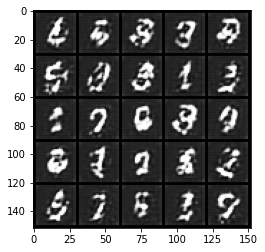

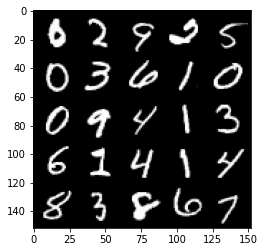

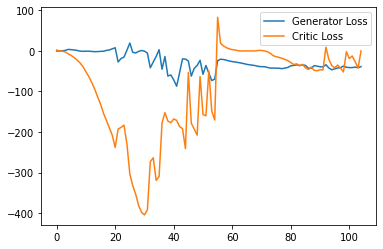

Step 2150: Generator loss: -32.288527946472165, critic loss: -1.780747547149658


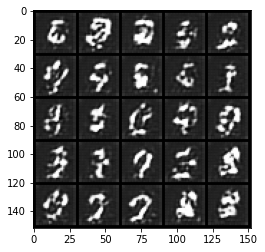

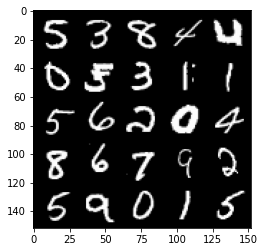

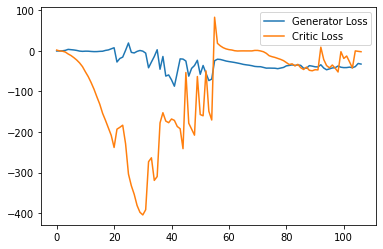

Step 2200: Generator loss: -43.62886363983154, critic loss: -26.34164106845856


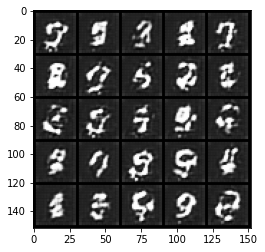

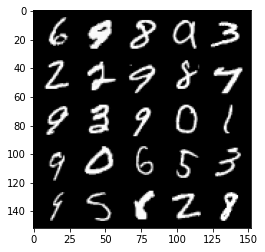

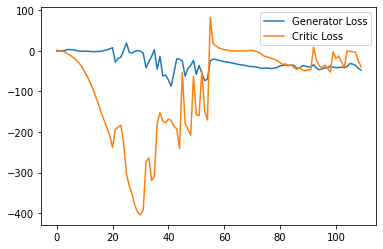

Step 2250: Generator loss: -37.64001390457153, critic loss: -20.789656415939334


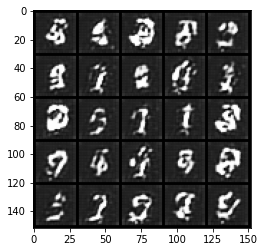

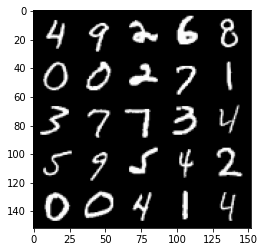

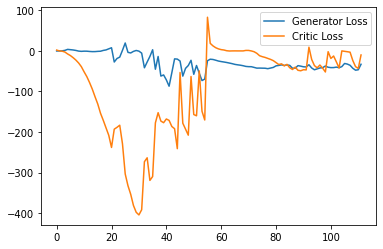

Step 2300: Generator loss: -32.779471740722656, critic loss: -5.908839604377747


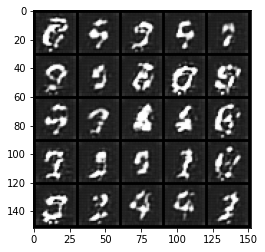

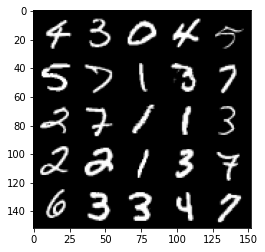

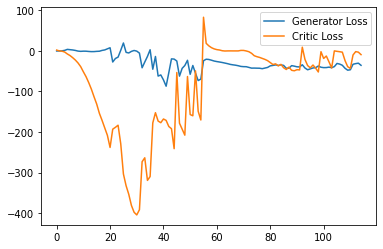

Step 2350: Generator loss: -45.21652446746826, critic loss: -36.49878397369385


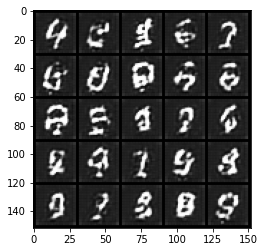

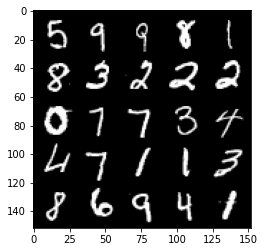

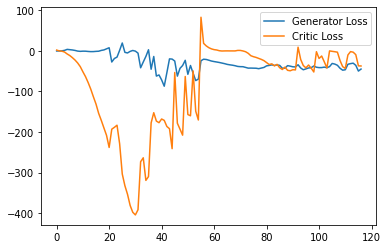

Step 2400: Generator loss: -34.824037876129154, critic loss: -32.283316112518314


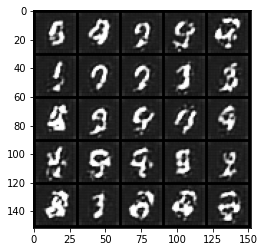

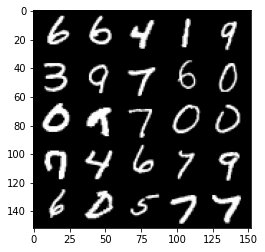

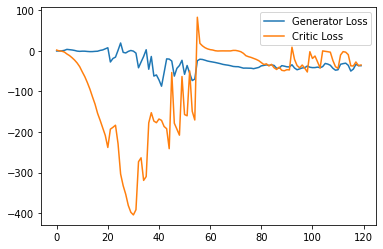

Step 2450: Generator loss: -35.49961907744407, critic loss: -39.287381397247316


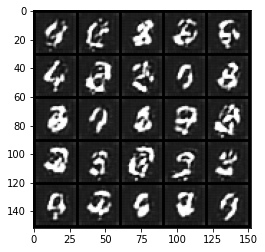

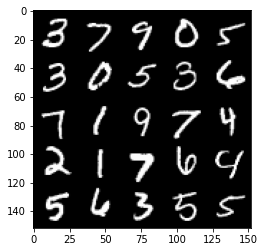

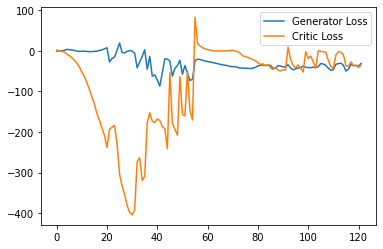

Step 2500: Generator loss: -33.52196773529053, critic loss: -9.775536524772647


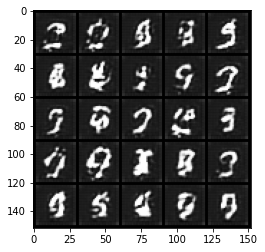

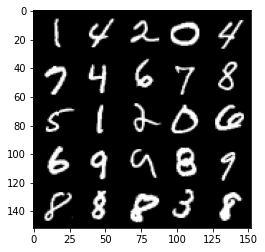

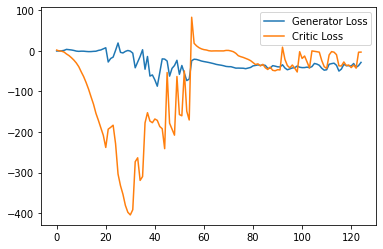

Step 2550: Generator loss: -26.76268054962158, critic loss: -3.0696153306961054


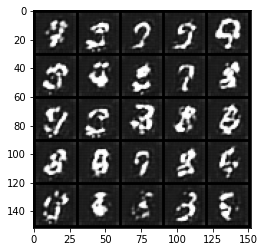

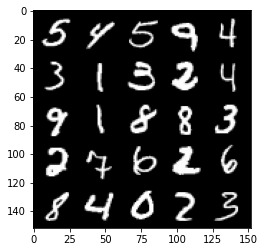

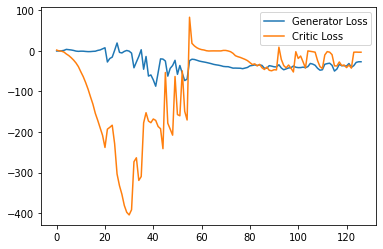

Step 2600: Generator loss: -27.85949909210205, critic loss: -3.0212664470672608


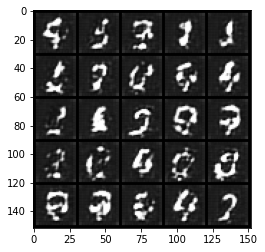

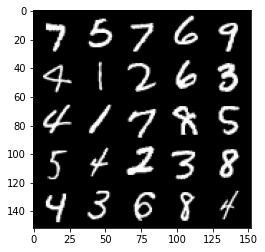

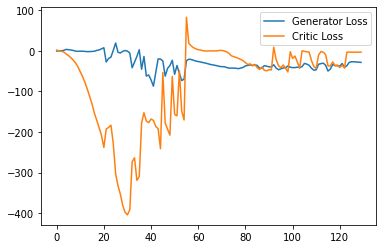

Step 2650: Generator loss: -29.895589752197267, critic loss: -3.8955266733169562


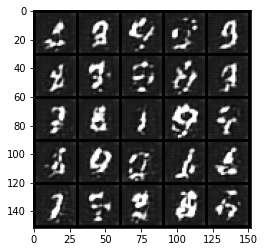

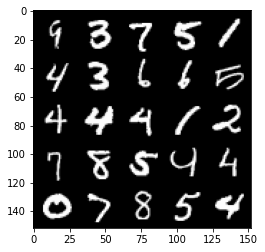

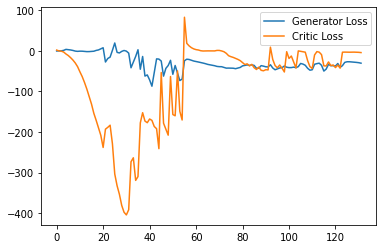

Step 2700: Generator loss: -35.67761276245117, critic loss: -14.06872045993805


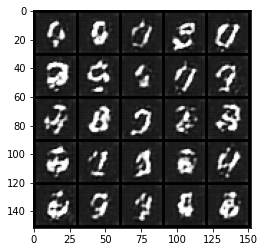

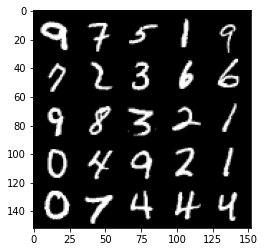

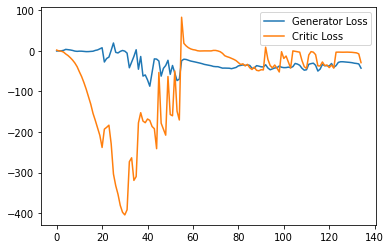

Step 2750: Generator loss: -41.27757328033447, critic loss: -28.653951285362247


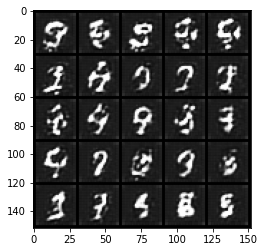

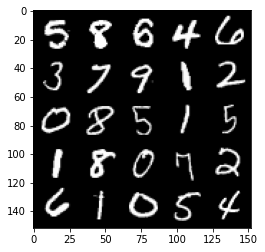

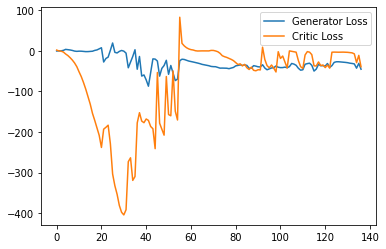

Step 2800: Generator loss: -45.32836730957031, critic loss: -35.034994340896596


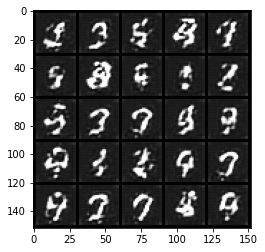

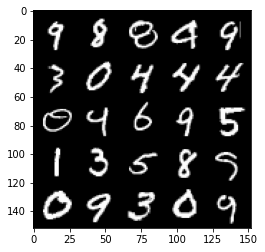

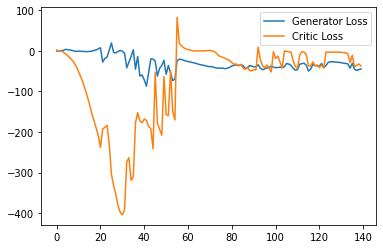

Step 2850: Generator loss: -28.310934467315676, critic loss: -7.132866243362426


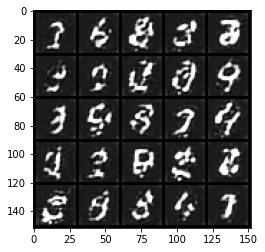

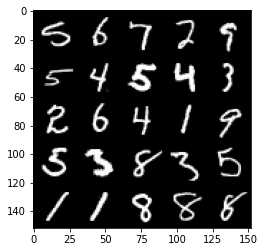

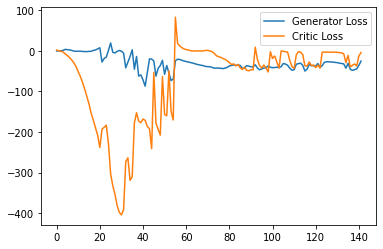

Step 2900: Generator loss: -35.822507019042966, critic loss: -20.023235073089605


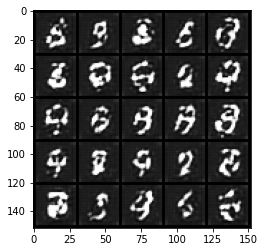

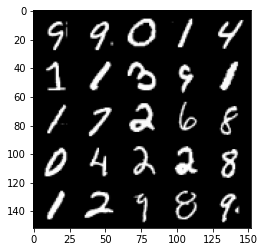

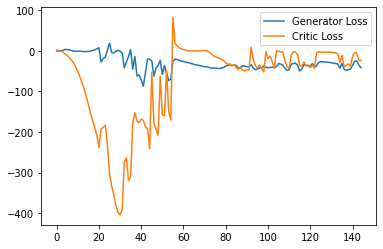

Step 2950: Generator loss: -34.37243577003479, critic loss: -26.673405332565302


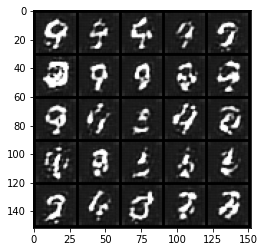

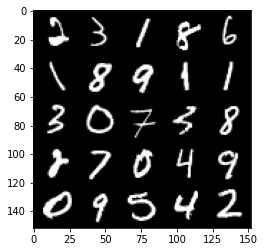

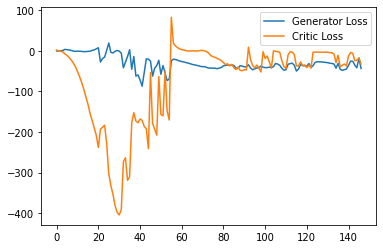

Step 3000: Generator loss: -40.30748954772949, critic loss: -21.19322291088105


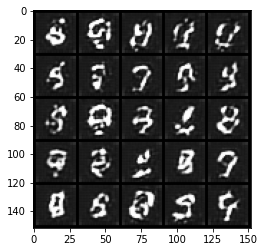

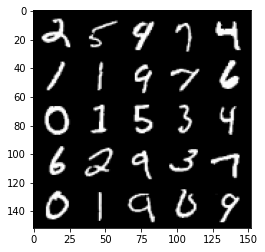

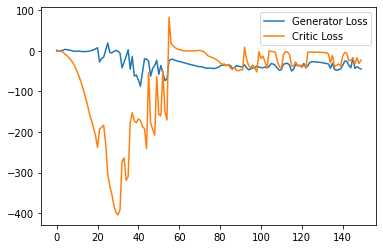

Step 3050: Generator loss: -29.509349517822265, critic loss: -7.482452474594116


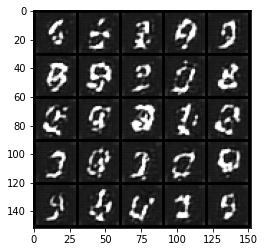

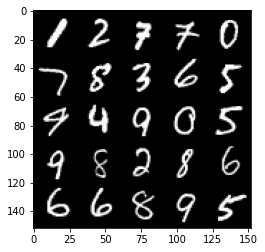

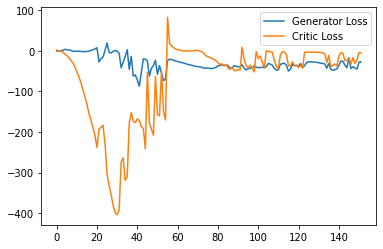

Step 3100: Generator loss: -42.86123935699463, critic loss: -31.21268022155762


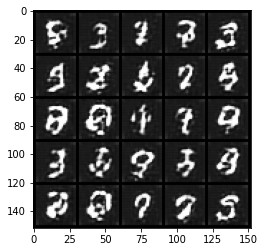

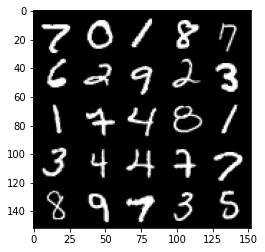

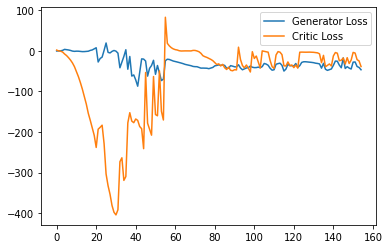

Step 3150: Generator loss: -41.29936309814453, critic loss: -22.746008453369146


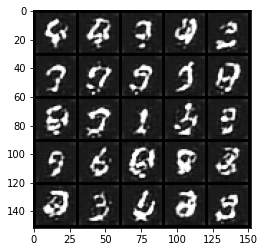

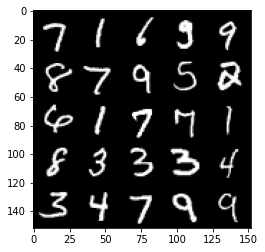

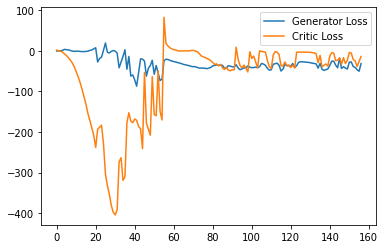

Step 3200: Generator loss: -36.76047523498535, critic loss: -10.060456545829771


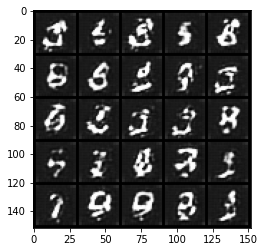

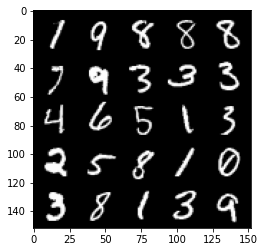

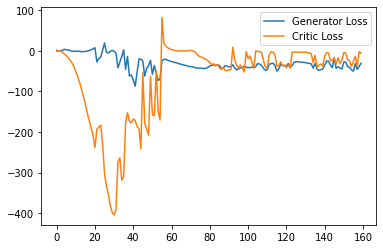

Step 3250: Generator loss: -40.757282962799074, critic loss: -29.95074085712433


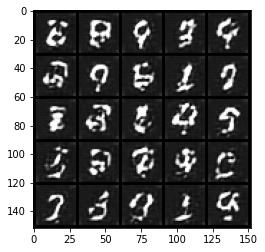

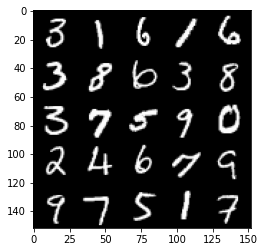

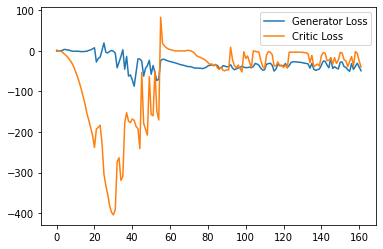

Step 3300: Generator loss: -44.42461288452149, critic loss: -12.681421128749847


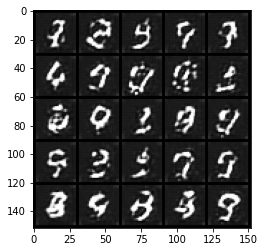

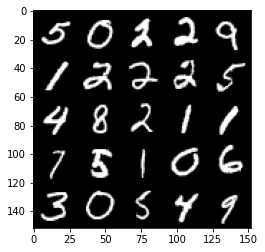

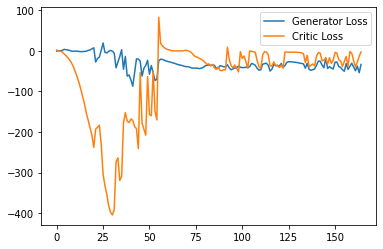

Step 3350: Generator loss: -33.58284408569336, critic loss: -3.0656012806892403


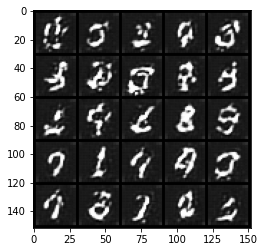

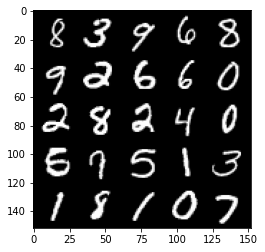

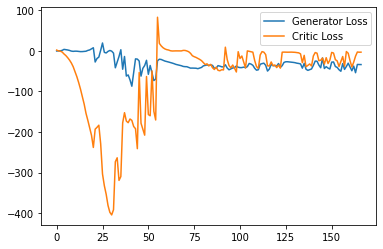

Step 3400: Generator loss: -34.72012596130371, critic loss: -2.9085678739547722


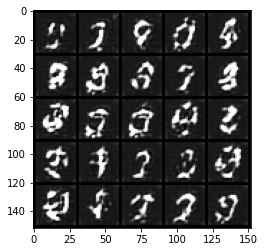

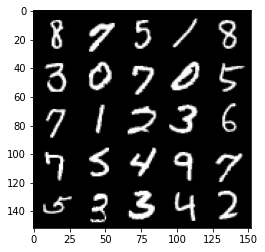

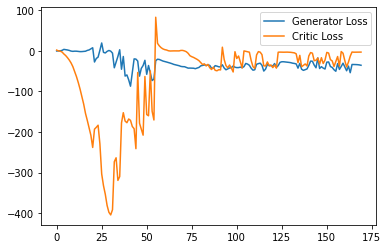

Step 3450: Generator loss: -37.03707717895508, critic loss: -3.92373104763031


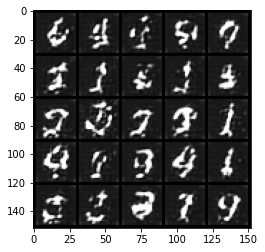

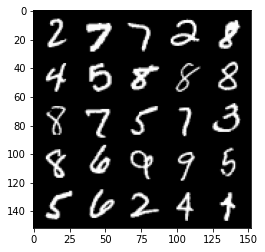

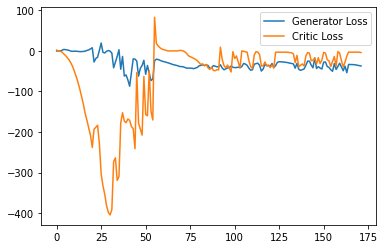

Step 3500: Generator loss: -50.321409683227536, critic loss: -23.862211280822752


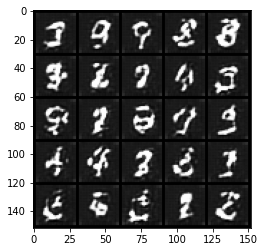

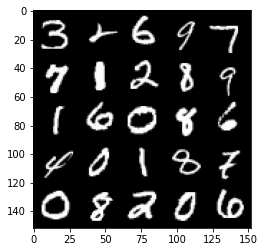

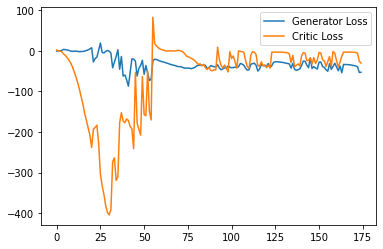

Step 3550: Generator loss: -43.64786975860596, critic loss: -21.275881116867073


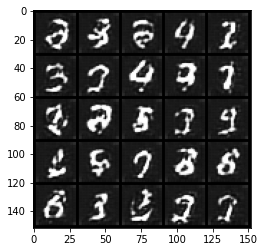

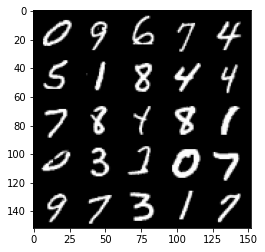

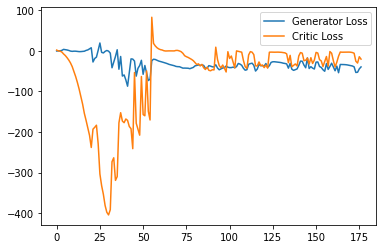

Step 3600: Generator loss: -40.50673509597778, critic loss: -8.56785086297989


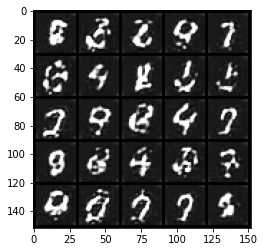

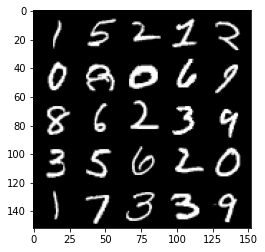

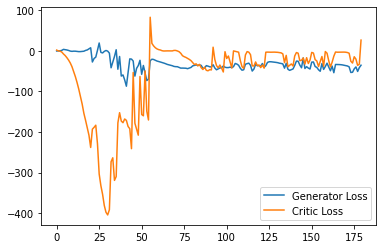

Step 3650: Generator loss: -36.193385467529296, critic loss: -3.4764392232894905


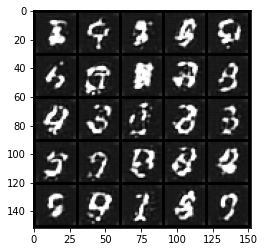

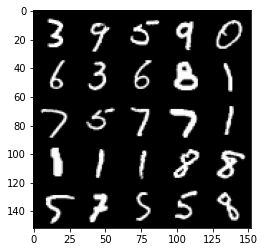

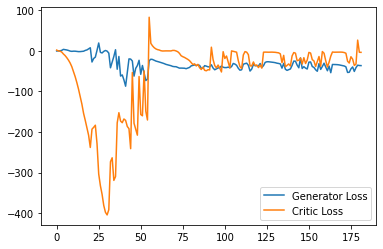

Step 3700: Generator loss: -38.03161460876465, critic loss: -3.838309916496276


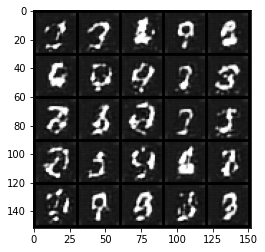

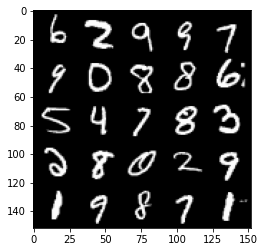

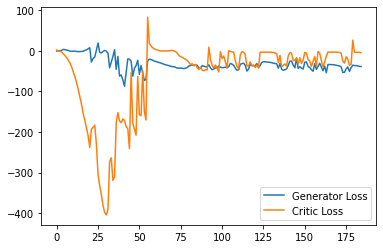

Step 3750: Generator loss: -45.69785846710205, critic loss: -22.3948051700592


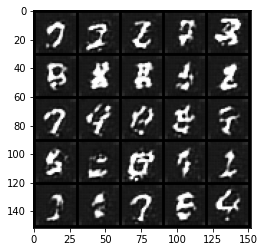

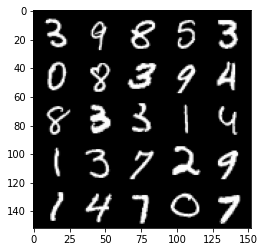

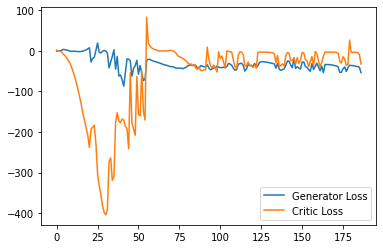

Step 3800: Generator loss: -46.23095729827881, critic loss: -28.1760411939621


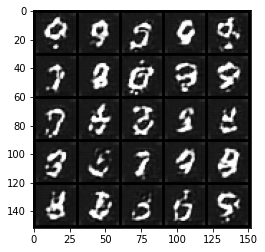

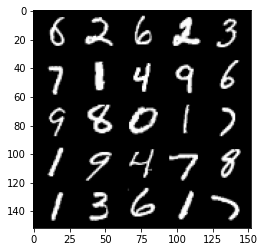

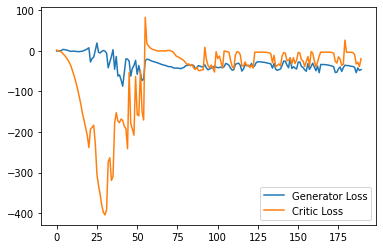

Step 3850: Generator loss: -48.26341094970703, critic loss: -30.773690849304188


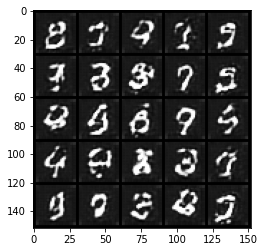

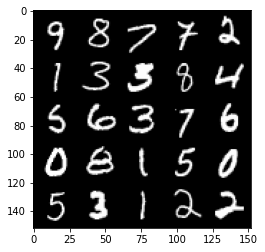

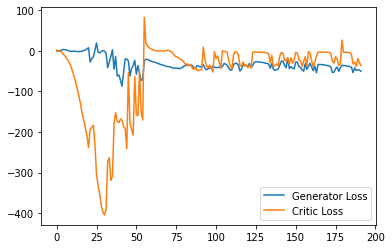

Step 3900: Generator loss: -60.191473159790036, critic loss: -35.985433708190925


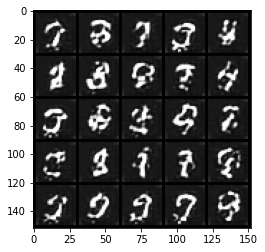

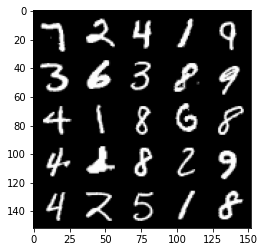

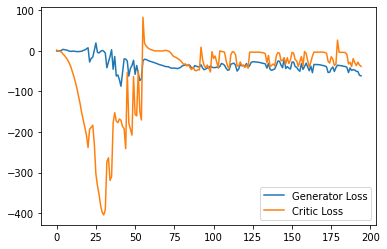

Step 3950: Generator loss: -55.7892374420166, critic loss: -37.134677570343015


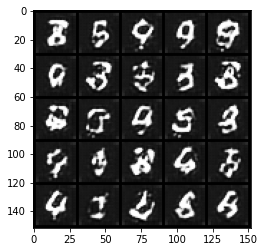

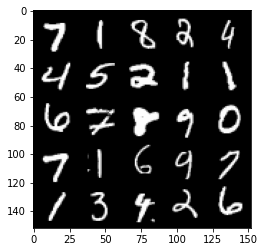

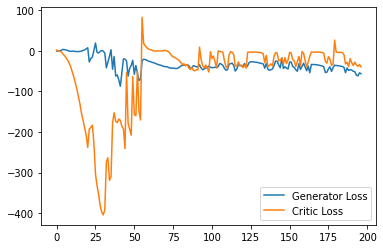

Step 4000: Generator loss: -48.89978973388672, critic loss: -26.26338674926757


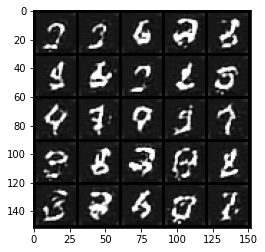

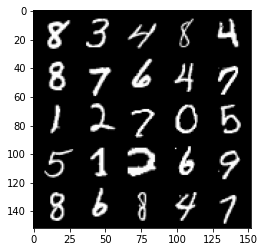

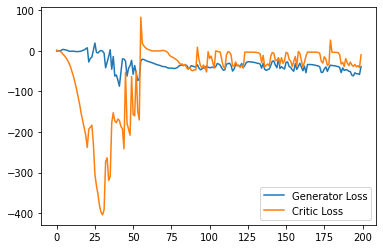

Step 4050: Generator loss: -43.39581302642822, critic loss: -9.564050925254818


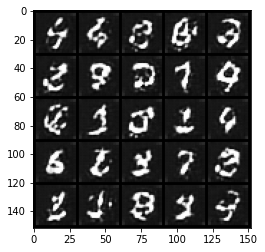

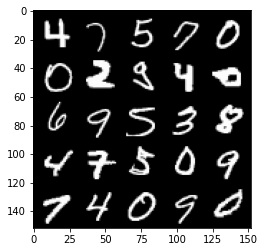

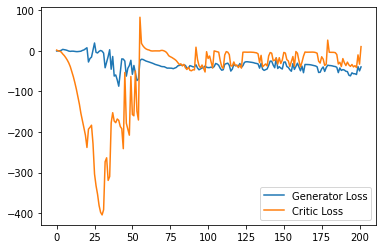

Step 4100: Generator loss: -40.79551277160645, critic loss: -7.067149883270264


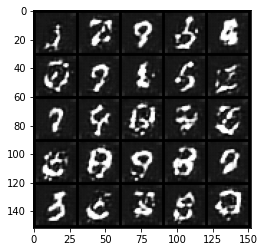

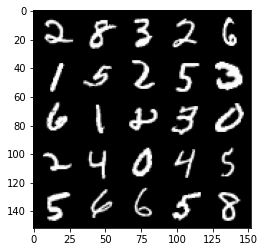

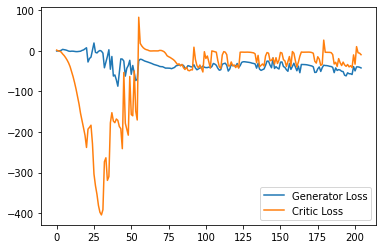

Step 4150: Generator loss: -58.05990478515625, critic loss: -32.59955481433869


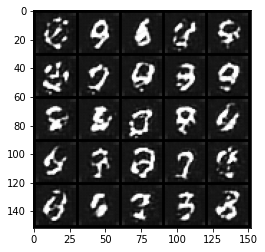

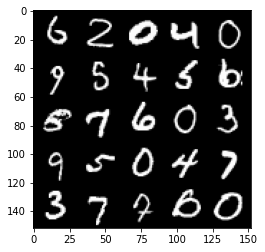

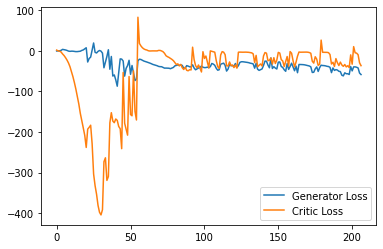

Step 4200: Generator loss: -49.05472801208496, critic loss: -25.640604312896727


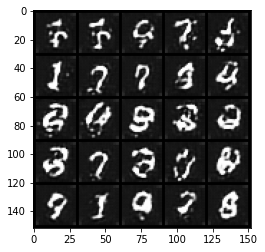

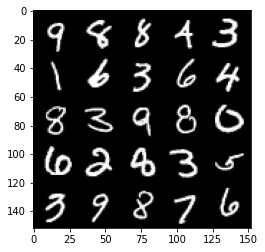

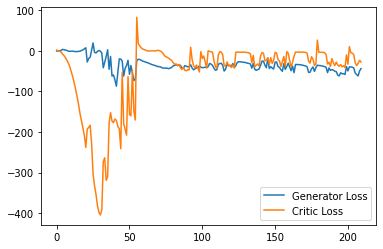

Step 4250: Generator loss: -53.752403564453125, critic loss: -28.89788464260102


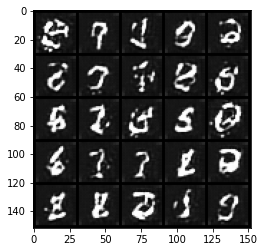

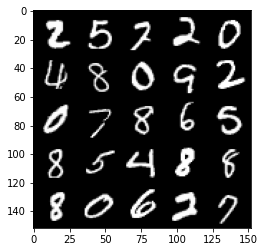

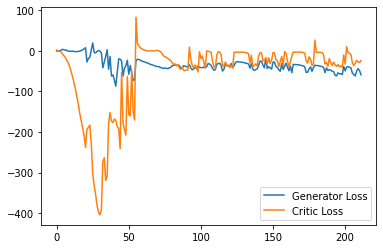

Step 4300: Generator loss: -54.93808578491211, critic loss: -24.805279706954952


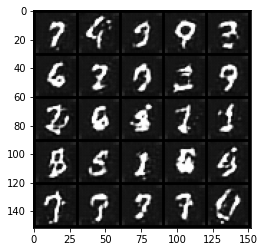

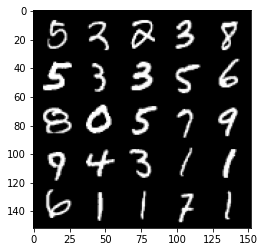

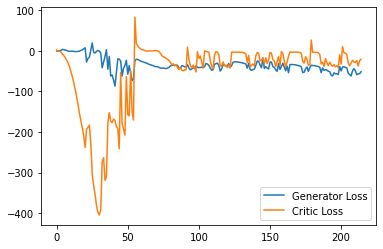

Step 4350: Generator loss: -52.19536415100097, critic loss: -16.118105287551884


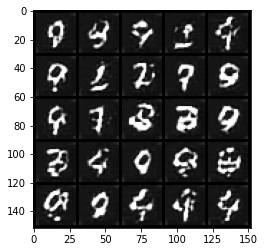

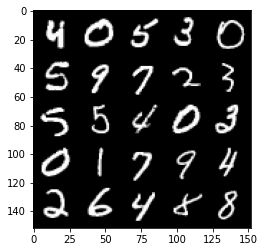

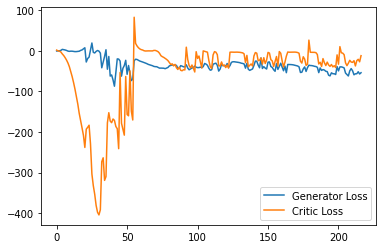

Step 4400: Generator loss: -41.78120475769043, critic loss: -7.39366361618042


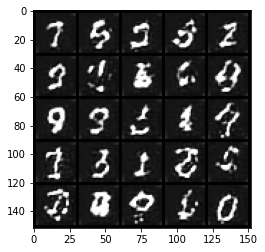

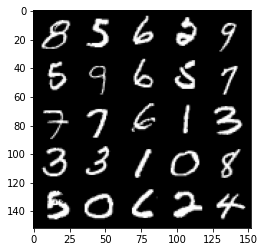

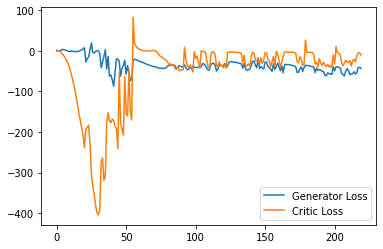

Step 4450: Generator loss: -61.871273040771484, critic loss: -32.80267290496826


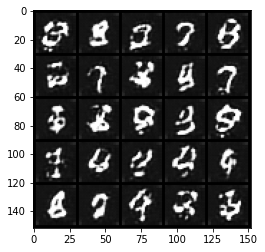

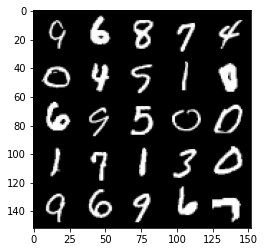

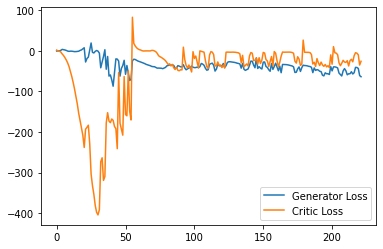

Step 4500: Generator loss: -60.12617218017578, critic loss: -35.95741439819336


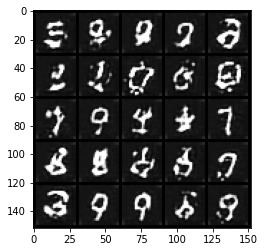

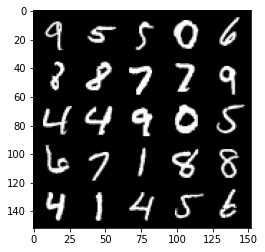

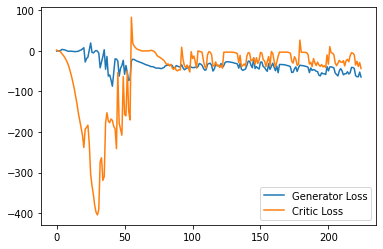

Step 4550: Generator loss: -57.5448412322998, critic loss: -14.989424292564392


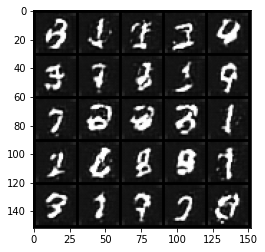

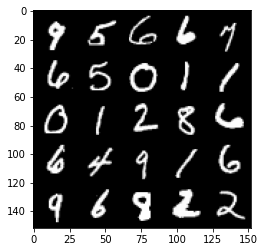

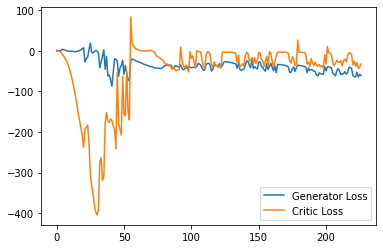

Step 4600: Generator loss: -41.786111984252926, critic loss: -2.5165767202377323


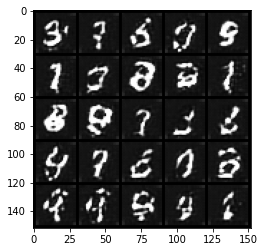

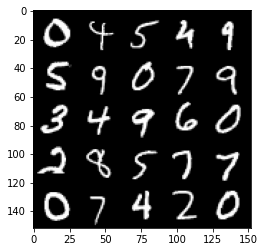

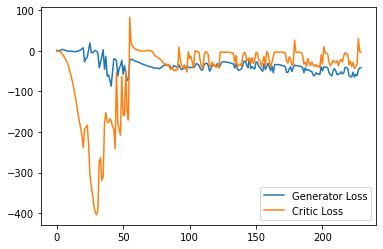

Step 4650: Generator loss: -42.14672904968262, critic loss: -2.7225215234756472


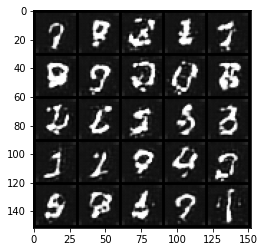

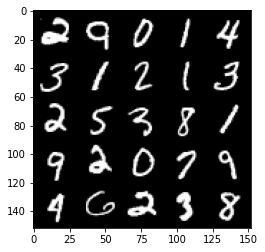

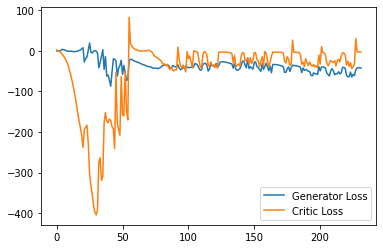

Step 4700: Generator loss: -43.30530014038086, critic loss: -2.8833944873809814


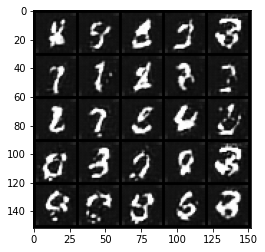

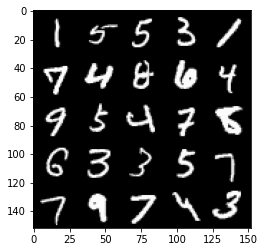

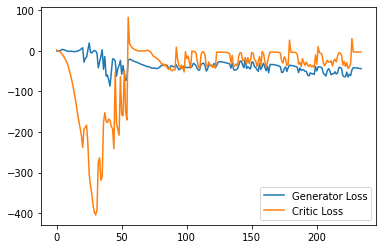

Step 4750: Generator loss: -43.56179008483887, critic loss: -3.1942396297454843


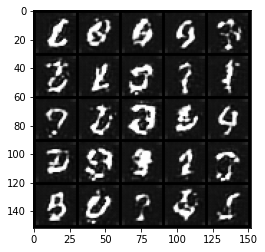

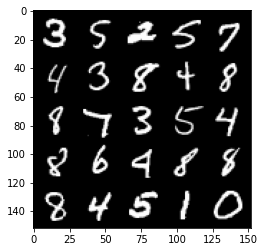

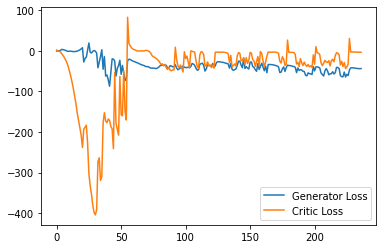

Step 4800: Generator loss: -43.46347755432129, critic loss: -3.450242490768432


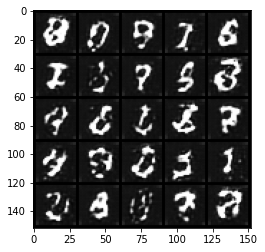

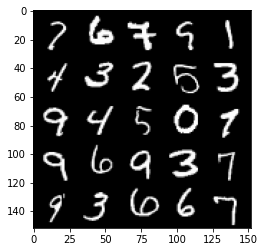

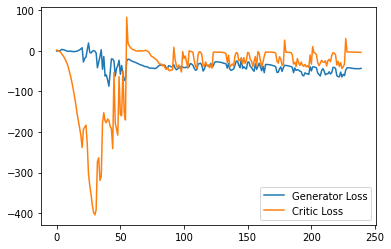

Step 4850: Generator loss: -43.39549919128418, critic loss: -4.169110848426817


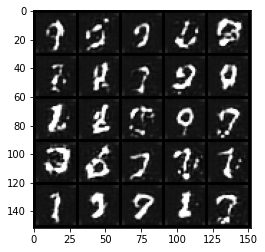

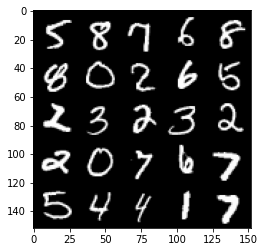

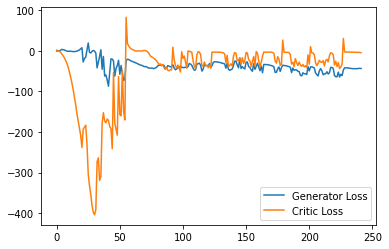

Step 4900: Generator loss: -44.33607131958008, critic loss: -5.622629316329956


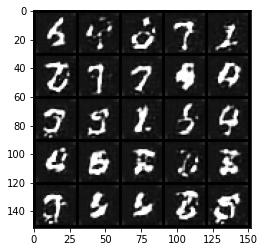

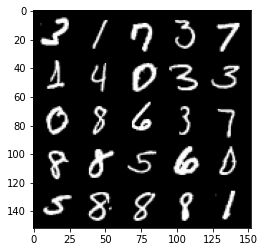

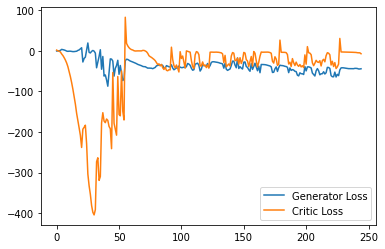

Step 4950: Generator loss: -50.185404510498046, critic loss: -16.76915085315704


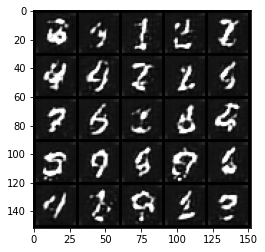

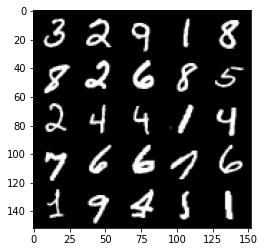

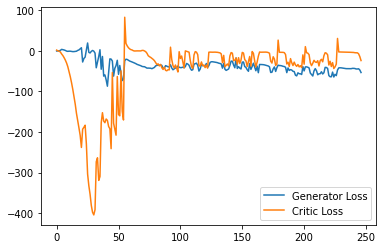

Step 5000: Generator loss: -45.978735275268555, critic loss: -15.557150771141055


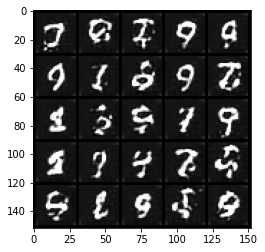

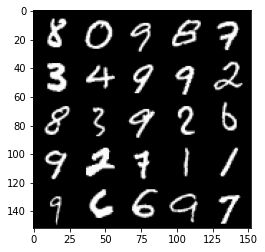

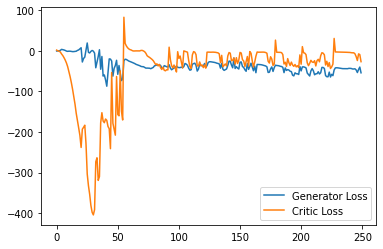

Step 5050: Generator loss: -40.965710144042966, critic loss: -3.235721557617188


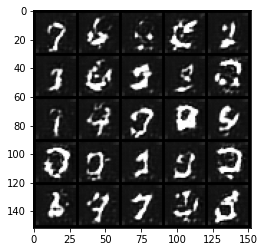

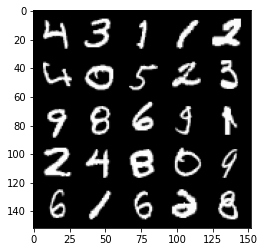

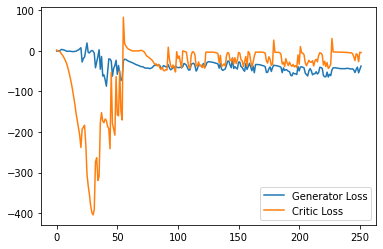

Step 5100: Generator loss: -48.665034713745115, critic loss: -16.256657486915586


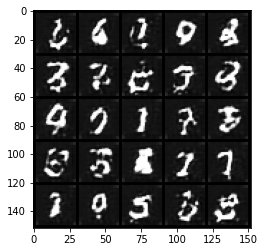

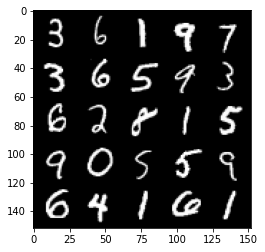

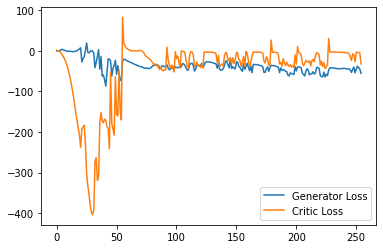

Step 5150: Generator loss: -54.541980590820316, critic loss: -16.92298631095887


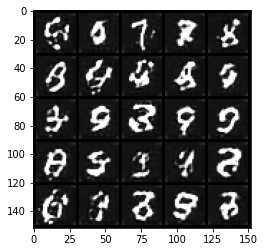

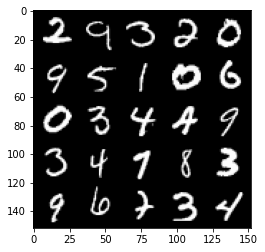

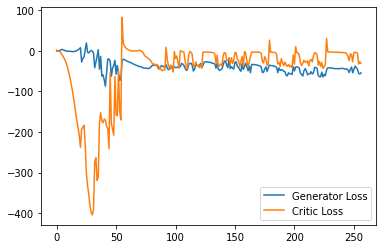

Step 5200: Generator loss: -39.71603271484375, critic loss: -3.852959469795228


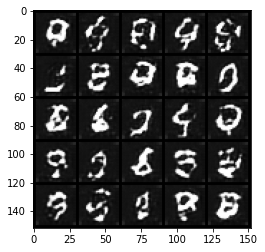

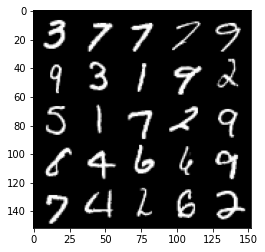

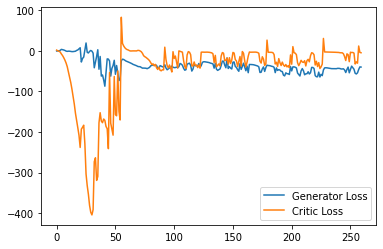

Step 5250: Generator loss: -48.326110916137694, critic loss: -11.822026911258696


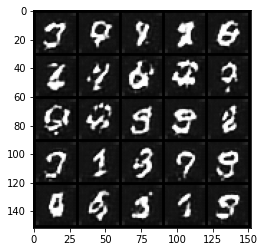

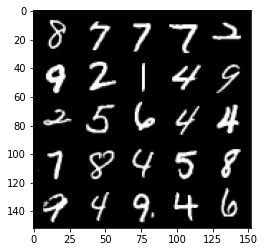

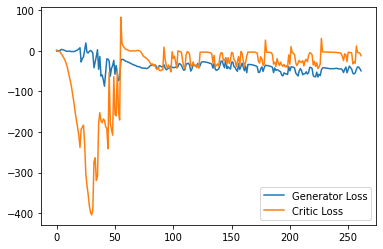

Step 5300: Generator loss: -48.89958301544189, critic loss: -23.258301533699036


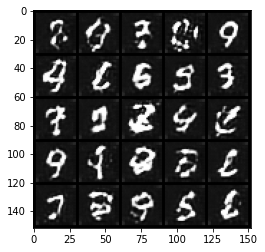

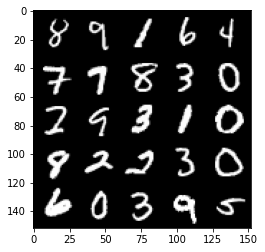

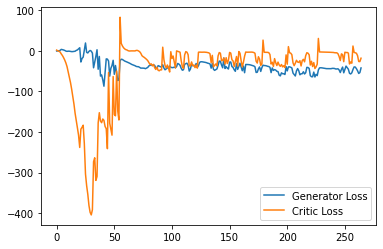

Step 5350: Generator loss: -43.296329193115234, critic loss: 0.5316091189384469


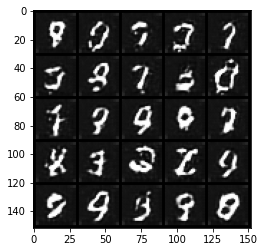

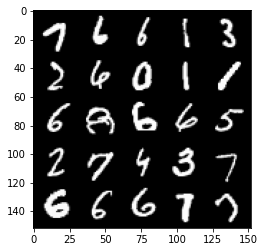

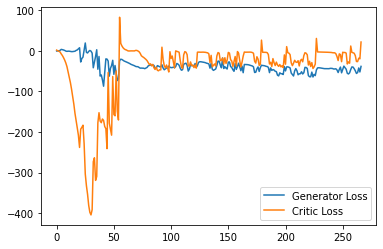

Step 5400: Generator loss: -36.09969696044922, critic loss: -2.929521650314332


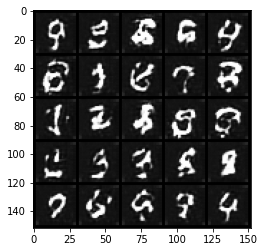

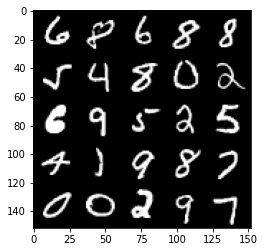

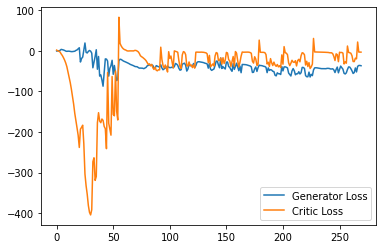

Step 5450: Generator loss: -37.55029815673828, critic loss: -3.079073344230652


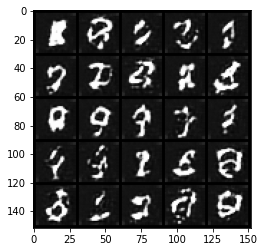

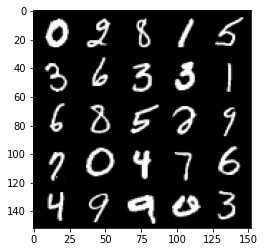

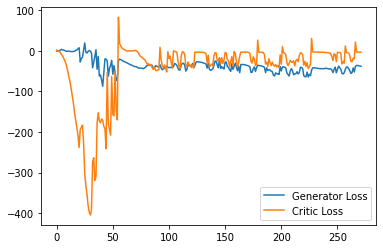

Step 5500: Generator loss: -38.740332717895505, critic loss: -3.338533743858337


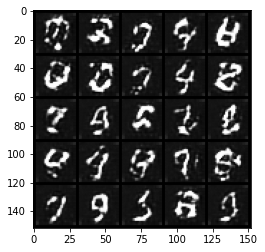

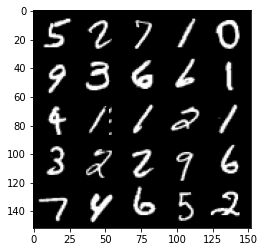

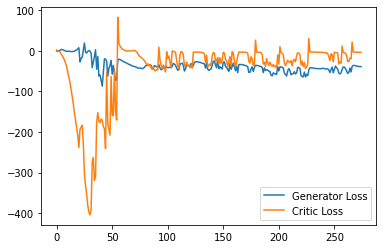

Step 5550: Generator loss: -39.540692825317386, critic loss: -3.811299892425538


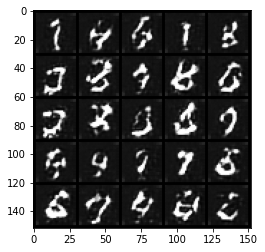

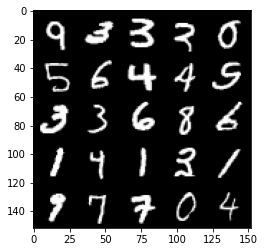

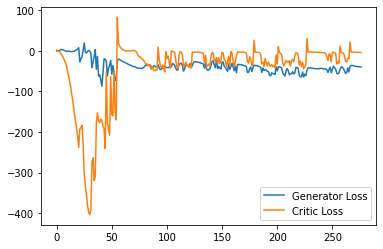

Step 5600: Generator loss: -41.183439865112305, critic loss: -4.605366243362426


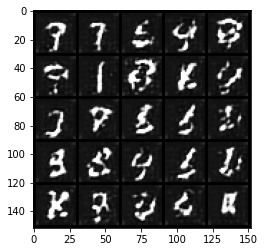

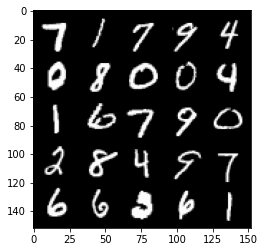

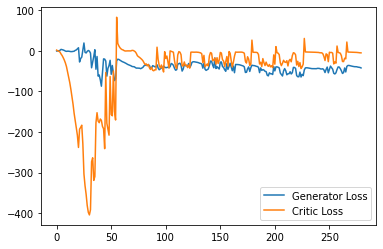

Step 5650: Generator loss: -47.933455352783206, critic loss: -15.169437104225162


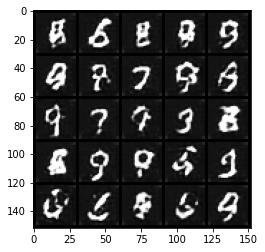

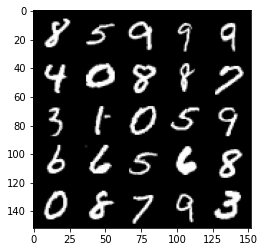

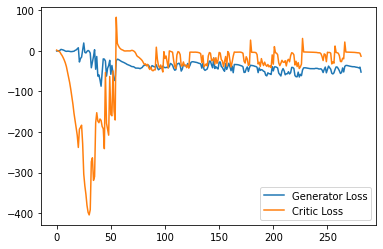

Step 5700: Generator loss: -55.038549156188964, critic loss: -30.331231951236713


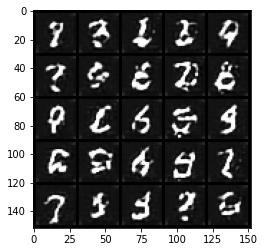

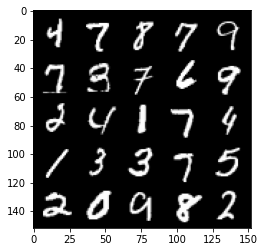

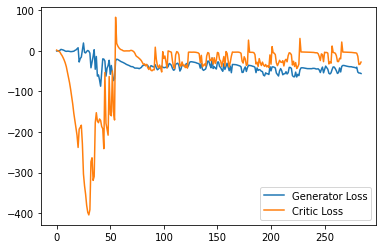

Step 5750: Generator loss: -51.72993324279785, critic loss: -29.00225698852538


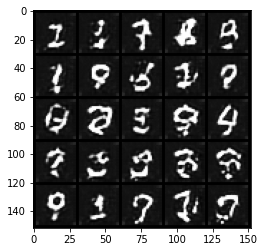

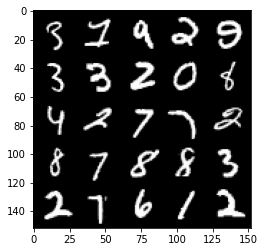

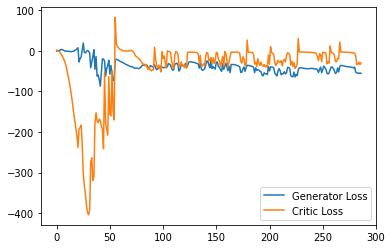

Step 5800: Generator loss: -44.22007255554199, critic loss: -7.530857486724858


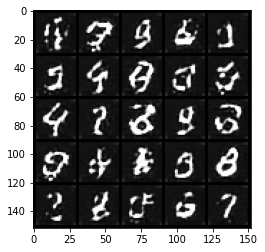

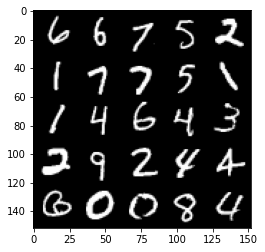

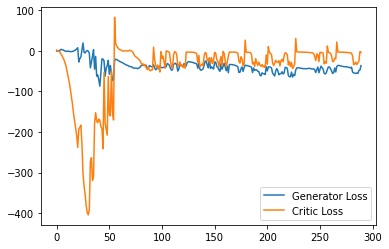

Step 5850: Generator loss: -36.485233764648434, critic loss: -4.393819576263428


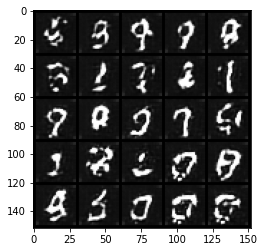

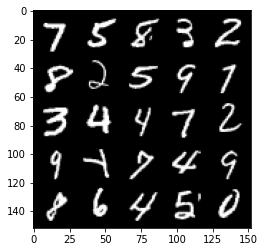

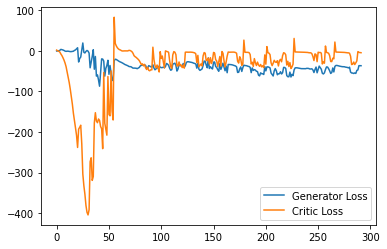

Step 5900: Generator loss: -40.07977058410645, critic loss: -11.134342266082763


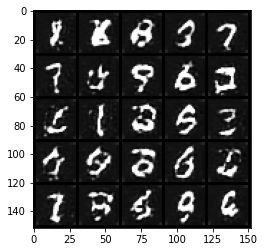

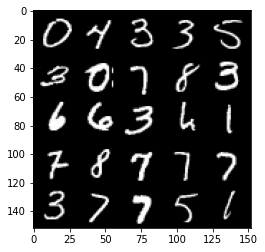

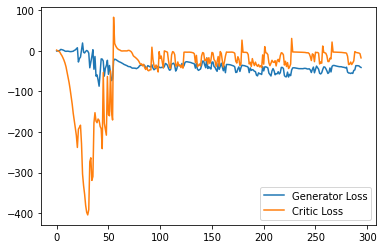

Step 5950: Generator loss: -47.12737229347229, critic loss: -14.004929450035098


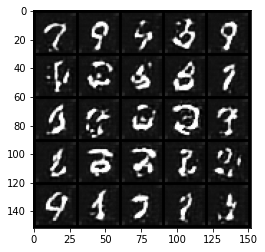

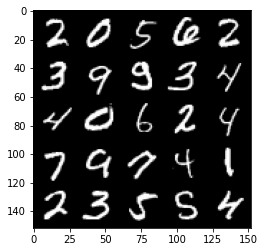

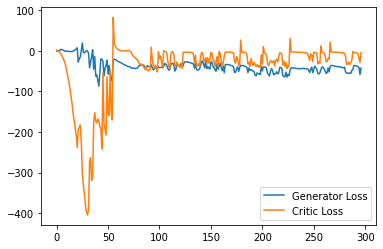

Step 6000: Generator loss: -45.109477310180665, critic loss: -18.30824401521683


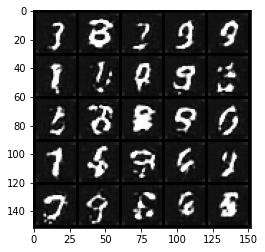

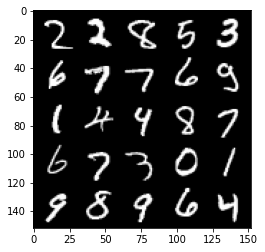

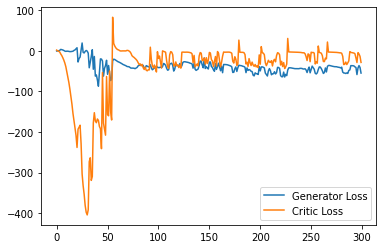

Step 6050: Generator loss: -51.603145866394044, critic loss: -26.492279937744144


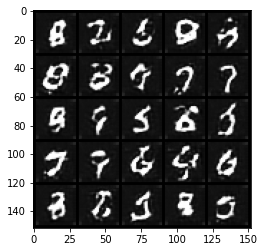

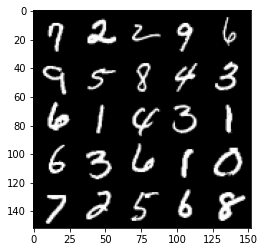

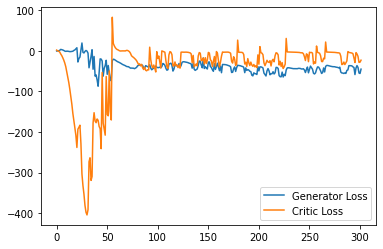

Step 6100: Generator loss: -46.51058609008789, critic loss: -25.98793647480011


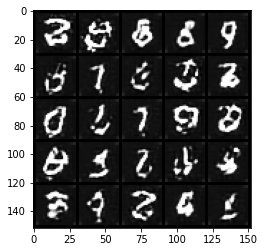

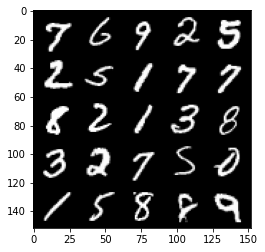

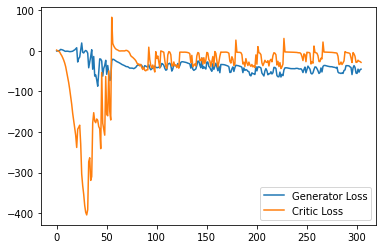

Step 6150: Generator loss: -41.682473754882814, critic loss: -9.04689220190048


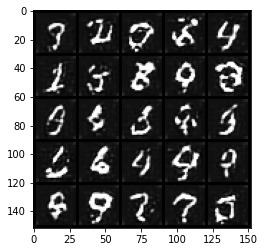

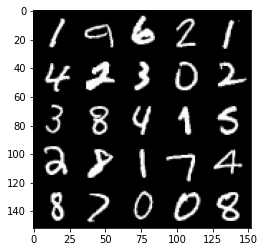

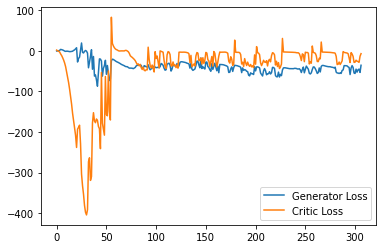

Step 6200: Generator loss: -49.438420639038085, critic loss: -21.85545658636093


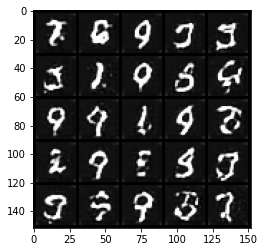

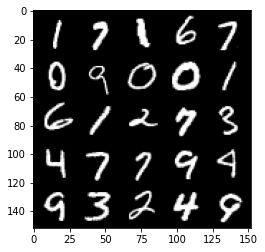

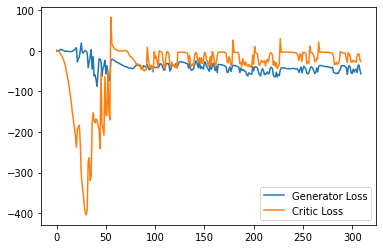

Step 6250: Generator loss: -51.40784656524658, critic loss: -22.86519714689254


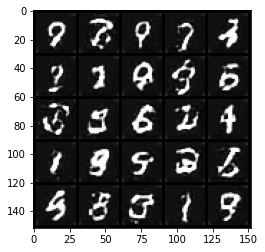

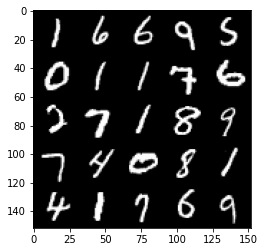

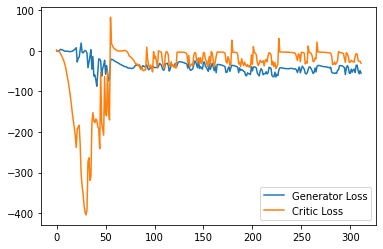

Step 6300: Generator loss: -50.49191871643066, critic loss: -21.56828625679016


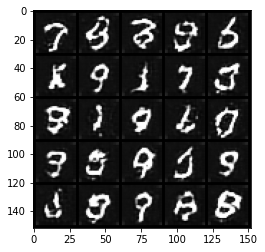

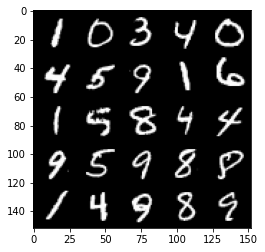

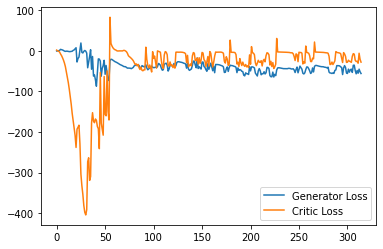

Step 6350: Generator loss: -52.4513510131836, critic loss: -21.99631580352783


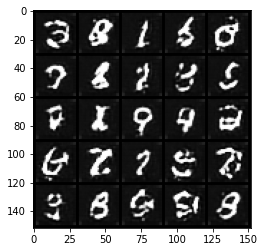

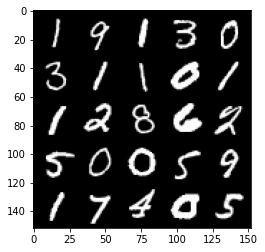

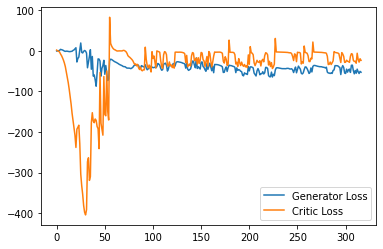

Step 6400: Generator loss: -43.381364765167234, critic loss: -5.833826232433321


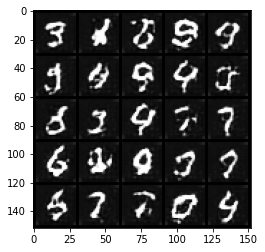

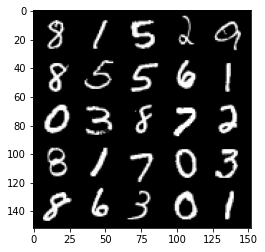

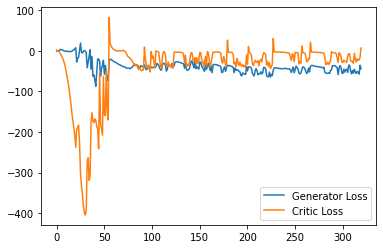

Step 6450: Generator loss: -52.41030403137207, critic loss: -21.972692618846885


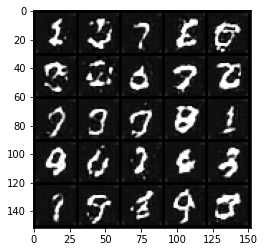

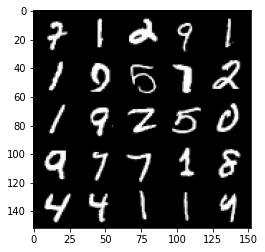

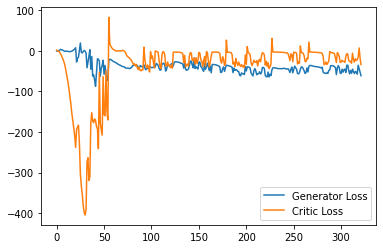

Step 6500: Generator loss: -51.339169387817385, critic loss: -19.950818097114563


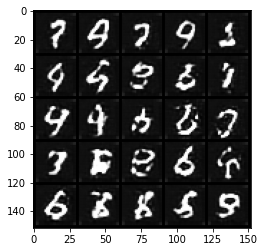

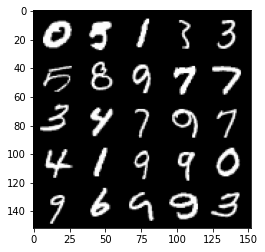

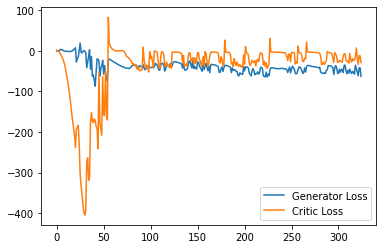

Step 6550: Generator loss: -51.778231105804444, critic loss: -24.233330219268797


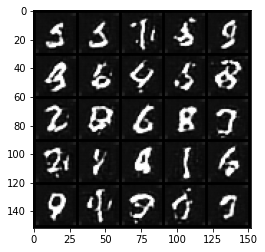

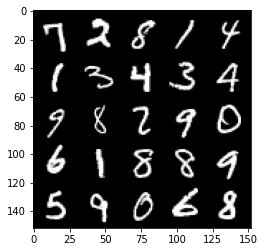

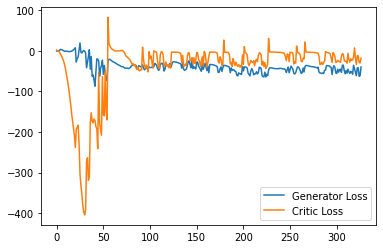

Step 6600: Generator loss: -48.22804962158203, critic loss: -2.372195973396302


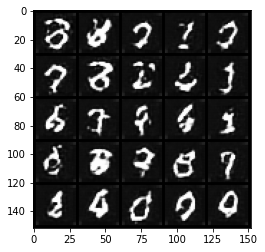

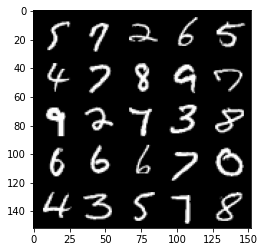

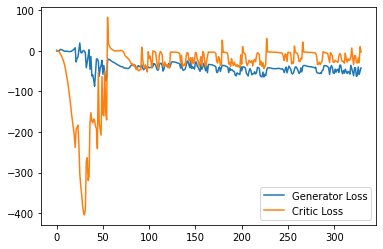

Step 6650: Generator loss: -41.6895938873291, critic loss: -2.626684423446655


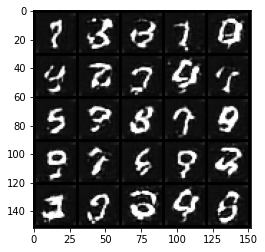

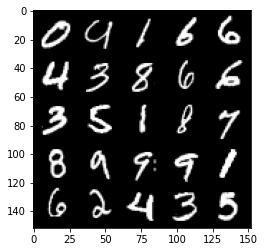

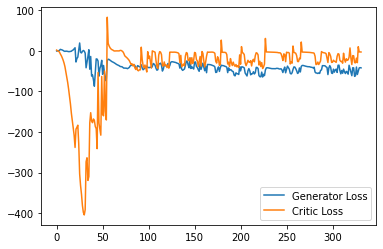

Step 6700: Generator loss: -43.26210067749023, critic loss: -2.9727487907409667


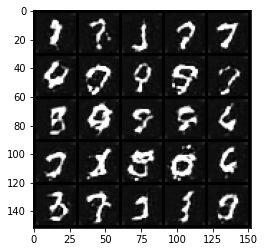

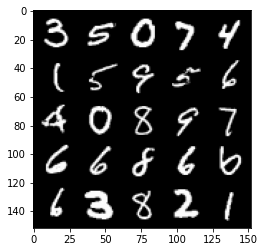

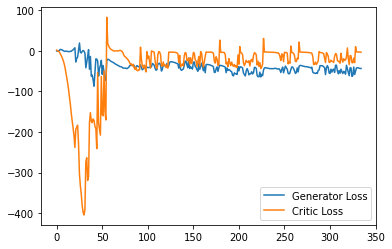

Step 6750: Generator loss: -43.6760285949707, critic loss: -3.5280351181030274


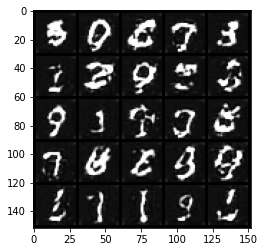

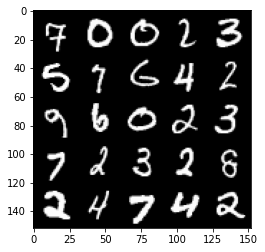

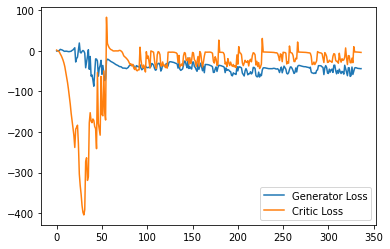

Step 6800: Generator loss: -44.88850555419922, critic loss: -4.302284123420715


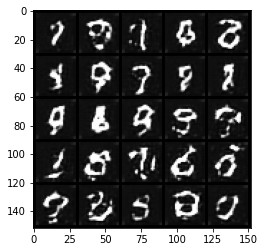

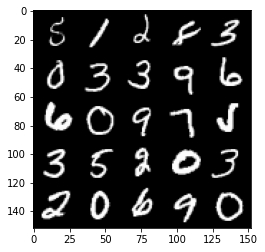

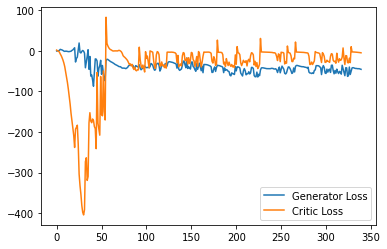

Step 6850: Generator loss: -45.0963737487793, critic loss: -4.5362974328994765


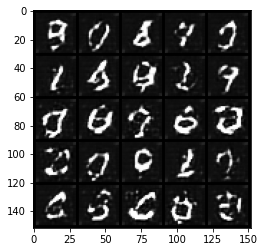

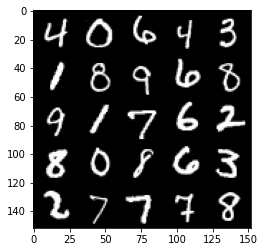

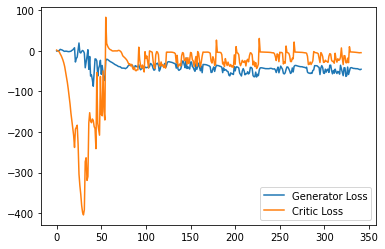

Step 6900: Generator loss: -55.952163238525394, critic loss: -8.63591561508179


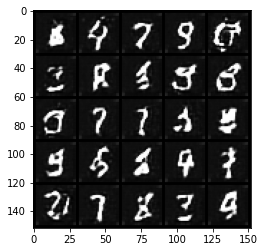

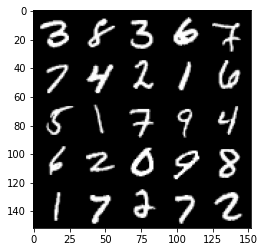

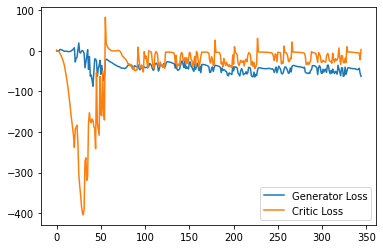

Step 6950: Generator loss: -39.79225723266602, critic loss: -2.5367075681686395


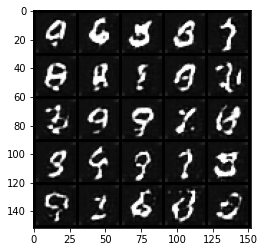

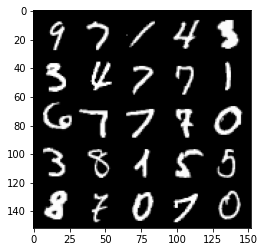

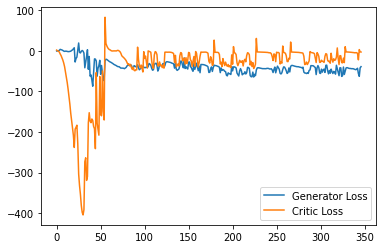

Step 7000: Generator loss: -40.22333106994629, critic loss: -2.712760091781616


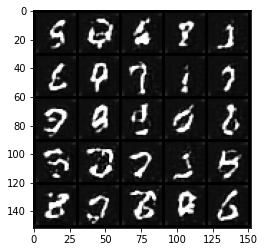

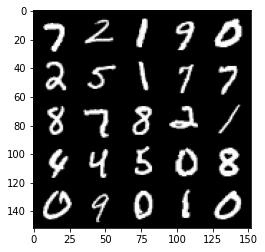

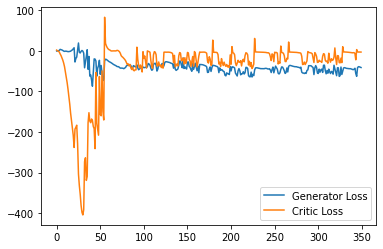

Step 7050: Generator loss: -41.57587348937988, critic loss: -2.873725865364075


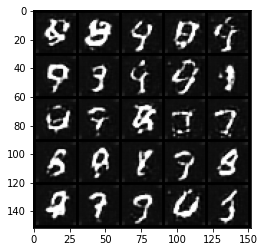

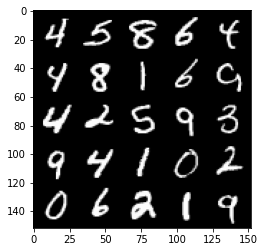

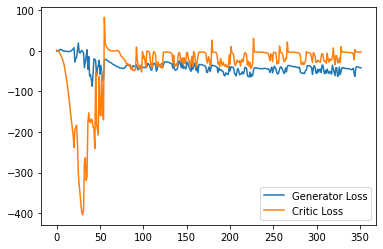

Step 7100: Generator loss: -42.39153266906738, critic loss: -2.9331406459808345


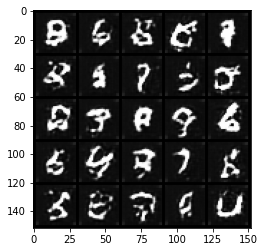

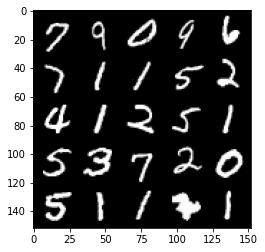

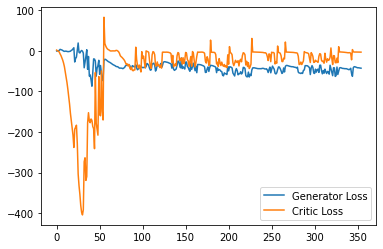

Step 7150: Generator loss: -42.62575225830078, critic loss: -3.104564665794371


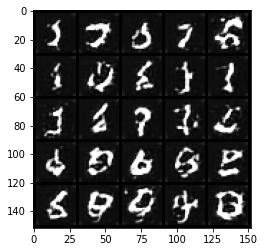

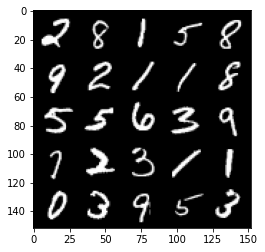

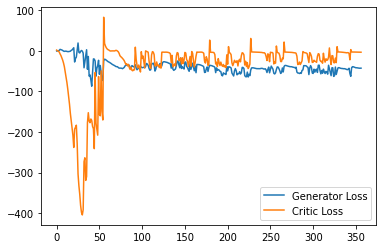

Step 7200: Generator loss: -43.5308251953125, critic loss: -3.3622389411926266


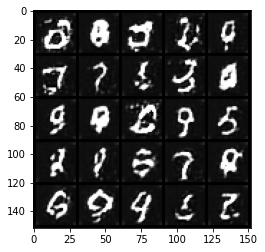

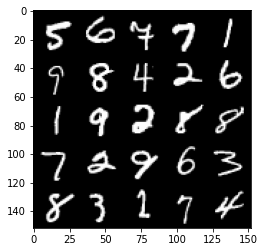

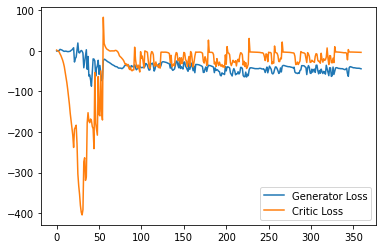

Step 7250: Generator loss: -44.267779159545896, critic loss: -3.948639742851256


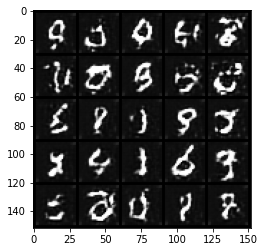

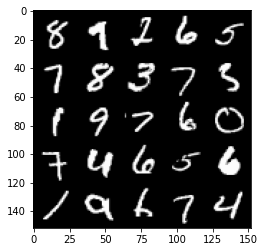

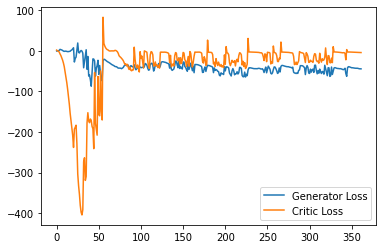

Step 7300: Generator loss: -45.03666603088379, critic loss: -3.852459938049316


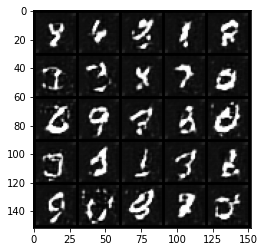

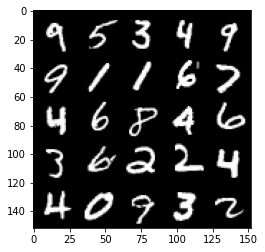

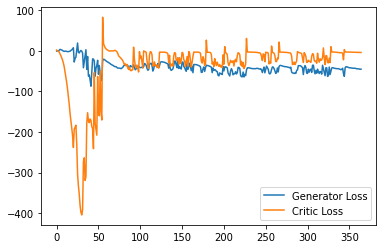

Step 7350: Generator loss: -44.14393104553223, critic loss: -2.0701280050277715


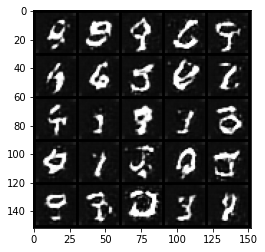

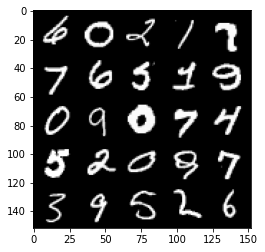

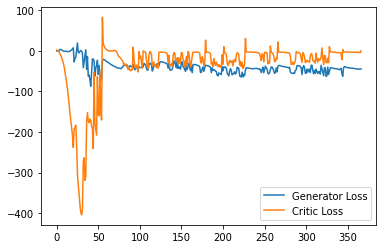

Step 7400: Generator loss: -43.564227447509765, critic loss: -3.0708032770156874


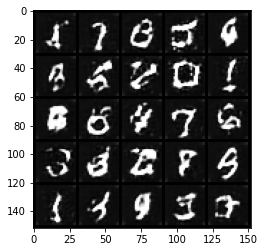

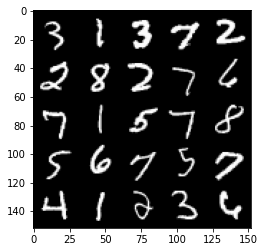

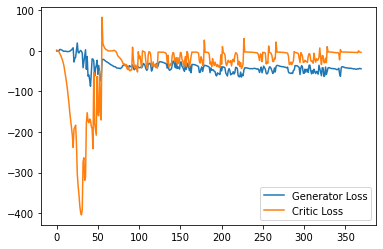

Step 7450: Generator loss: -44.65582595825195, critic loss: -4.64643597316742


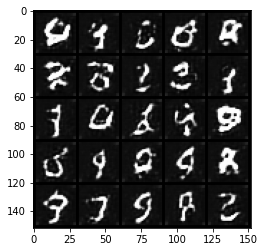

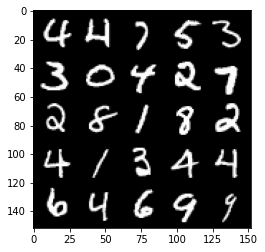

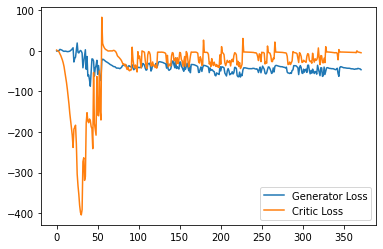

Step 7500: Generator loss: -47.10710075378418, critic loss: -3.1176251764297467


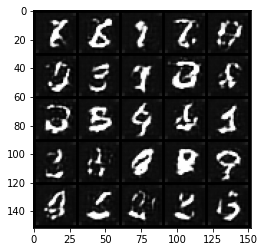

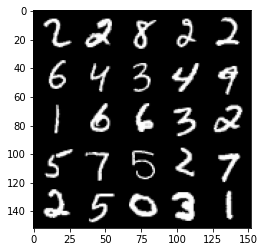

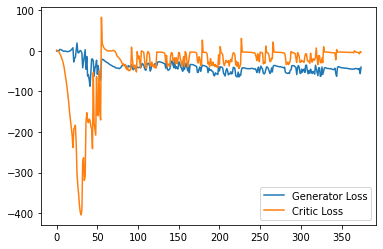

Step 7550: Generator loss: -40.56799980163574, critic loss: -2.6564965319633482


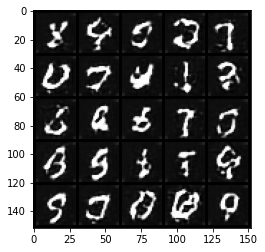

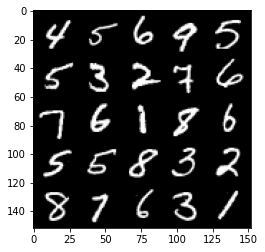

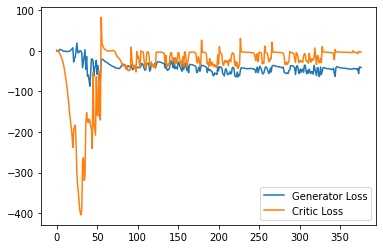

Step 7600: Generator loss: -42.5401490020752, critic loss: -2.928118851661682


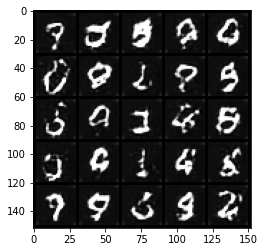

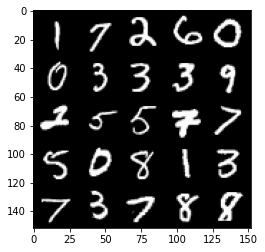

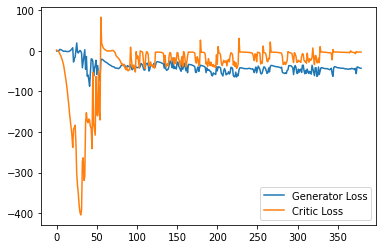

Step 7650: Generator loss: -42.81774749755859, critic loss: -3.217727642059326


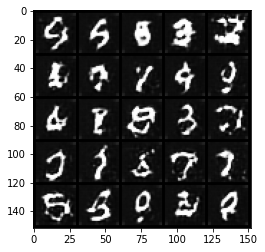

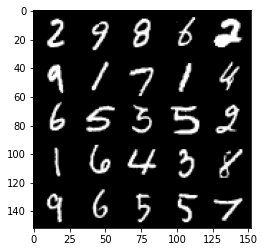

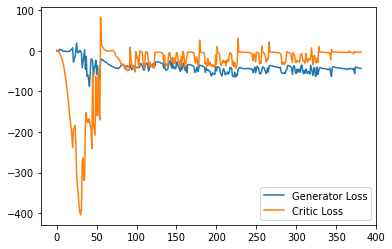

Step 7700: Generator loss: -43.868190155029296, critic loss: -3.7032579822540286


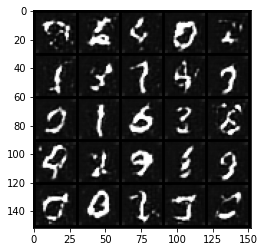

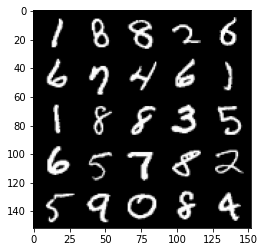

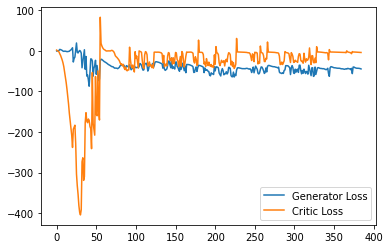

Step 7750: Generator loss: -43.37994400024414, critic loss: -4.003688289642334


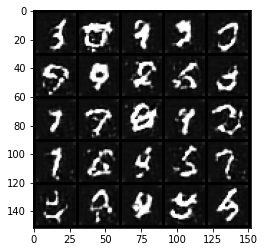

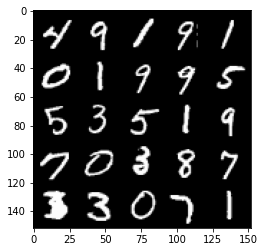

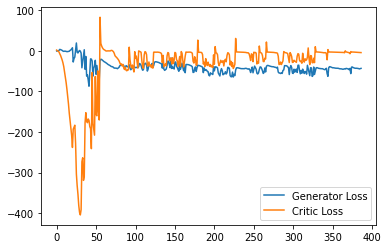

Step 7800: Generator loss: -44.331614303588864, critic loss: -1.8633785772323606


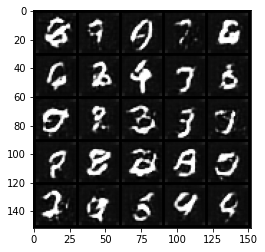

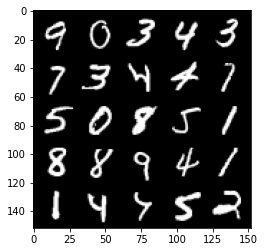

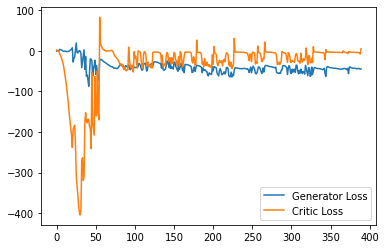

Step 7850: Generator loss: -42.24466400146484, critic loss: -2.3829515900611877


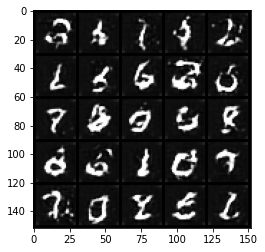

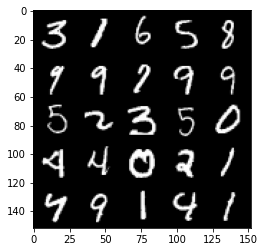

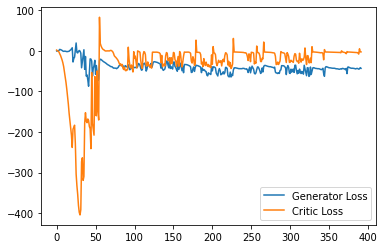

Step 7900: Generator loss: -43.460263366699216, critic loss: -2.7486773185729976


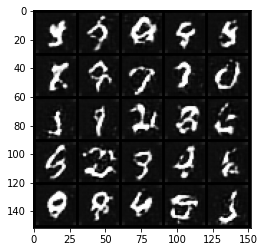

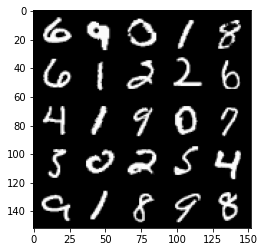

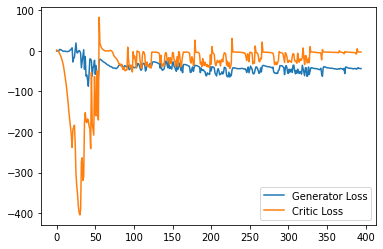

Step 7950: Generator loss: -44.18797813415527, critic loss: -3.476398843765259


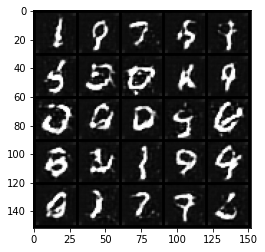

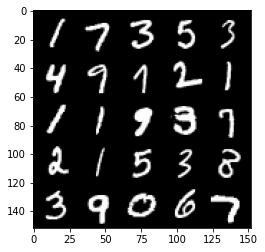

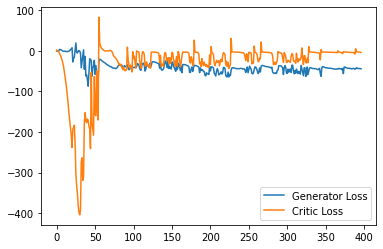

Step 8000: Generator loss: -45.520628128051754, critic loss: -5.415738656997681


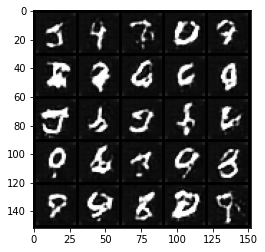

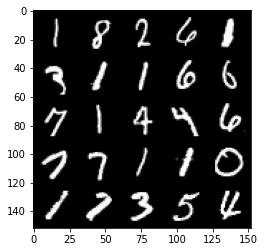

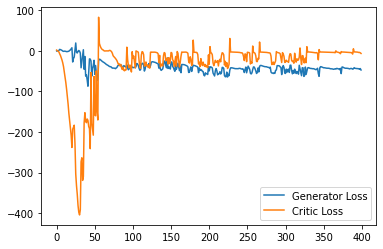

Step 8050: Generator loss: -42.726086120605466, critic loss: 3.268605161666869


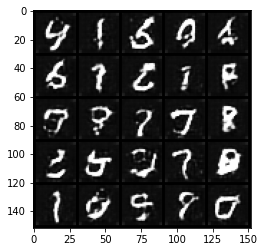

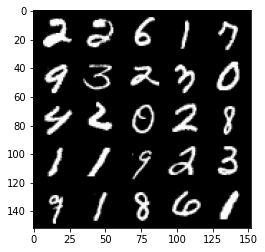

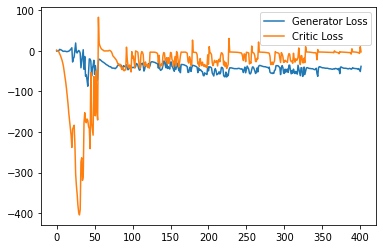

Step 8100: Generator loss: -40.934050750732425, critic loss: -2.120990058898926


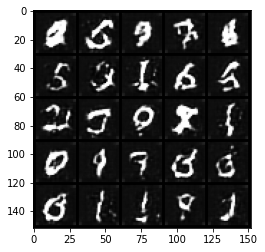

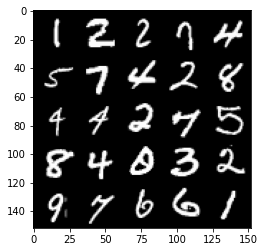

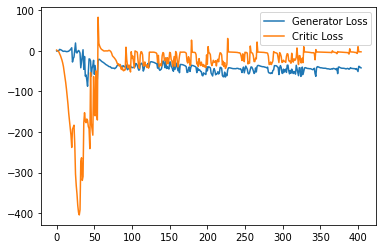

Step 8150: Generator loss: -41.31578620910645, critic loss: -2.3172509517669684


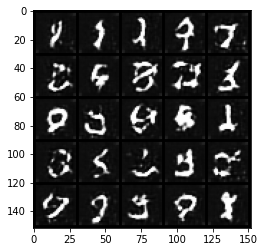

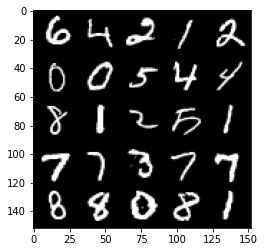

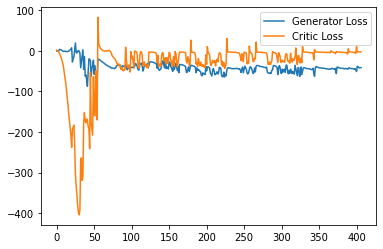

Step 8200: Generator loss: -41.55124412536621, critic loss: -2.453880523681641


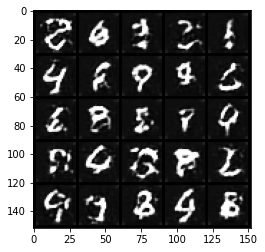

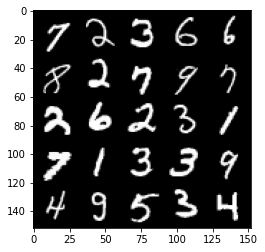

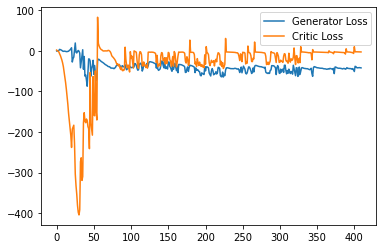

Step 8250: Generator loss: -42.04393249511719, critic loss: -2.600213636398316


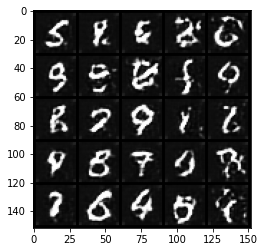

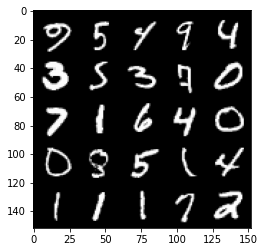

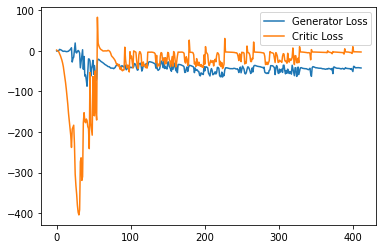

Step 8300: Generator loss: -42.177158432006834, critic loss: -2.752927808761596


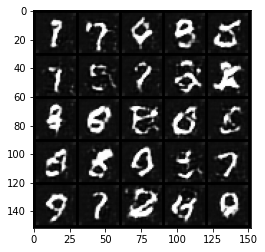

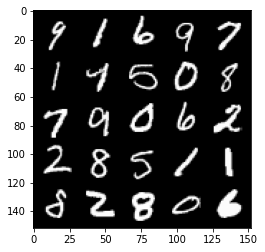

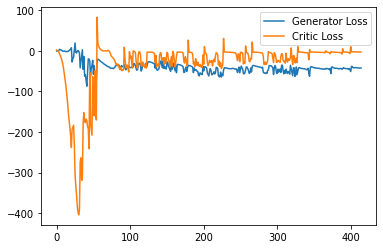

Step 8350: Generator loss: -42.48454811096192, critic loss: -2.8953366193771366


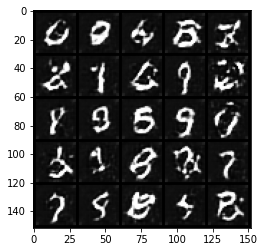

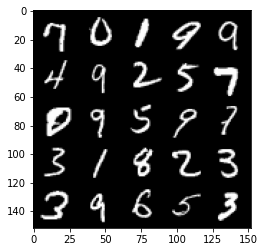

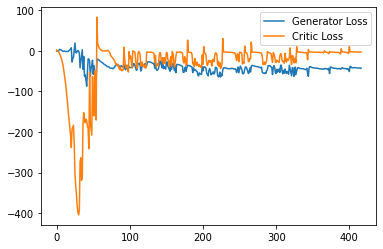

Step 8400: Generator loss: -42.41889419555664, critic loss: -3.0471800146102903


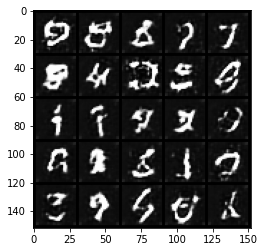

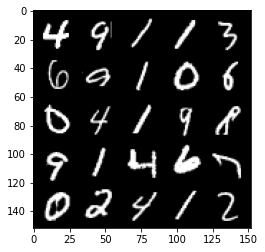

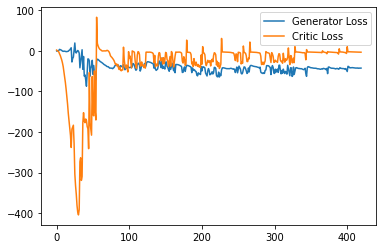

Step 8450: Generator loss: -43.106121139526365, critic loss: -3.5494718074798586


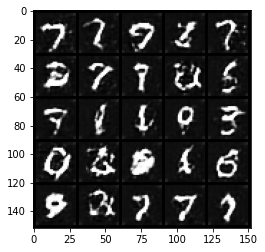

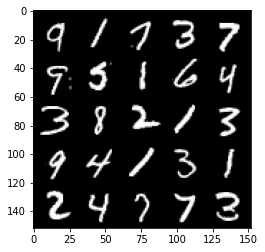

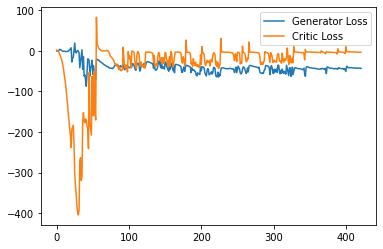

Step 8500: Generator loss: -46.65444953918457, critic loss: -5.073433671474456


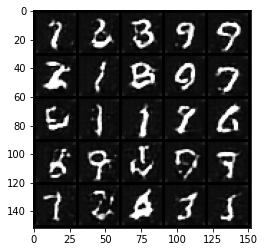

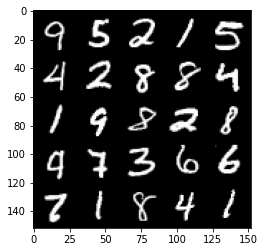

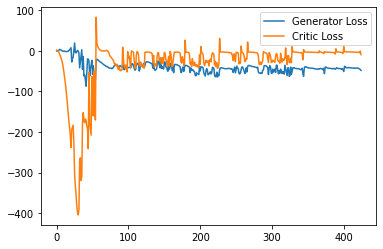

Step 8550: Generator loss: -51.801533966064454, critic loss: -18.239834510803224


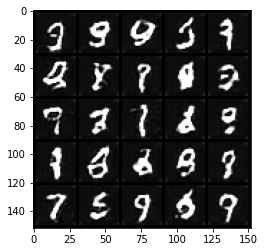

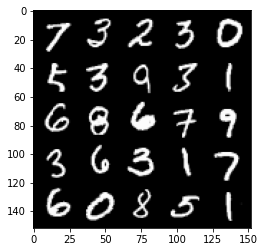

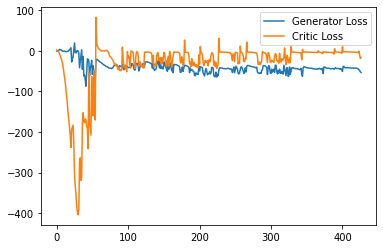

Step 8600: Generator loss: -43.322047271728515, critic loss: -3.8789771509170525


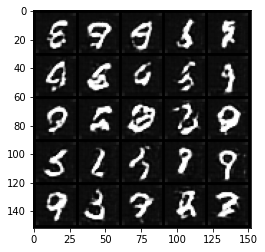

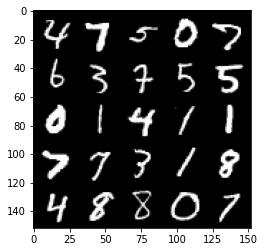

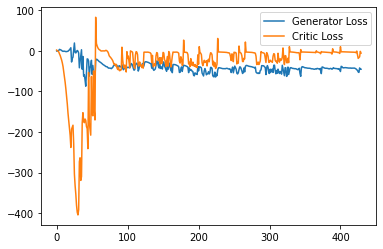

Step 8650: Generator loss: -48.08056171417236, critic loss: -13.55000910663605


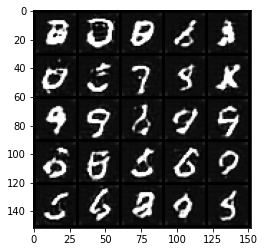

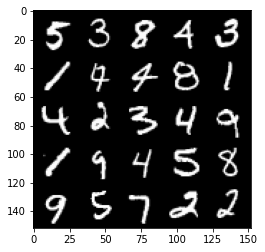

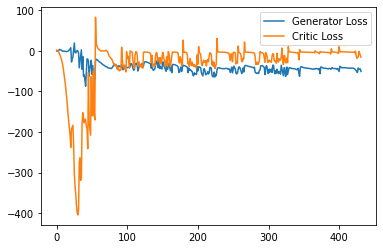

Step 8700: Generator loss: -45.9592554473877, critic loss: -18.896679057598117


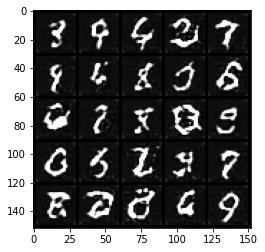

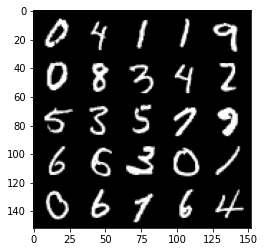

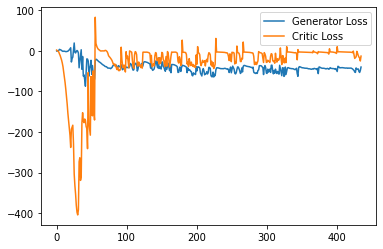

Step 8750: Generator loss: -46.7518989944458, critic loss: -19.081606523275376


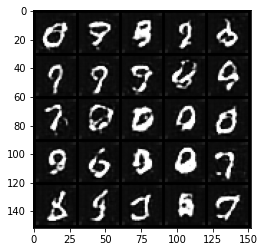

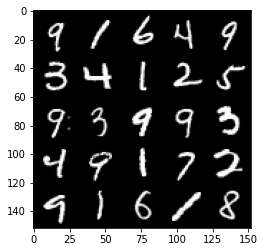

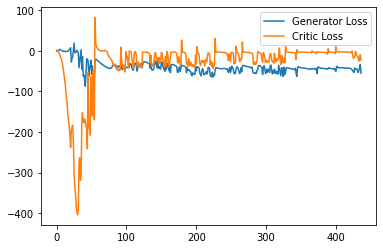

Step 8800: Generator loss: -43.693795166015626, critic loss: -7.661116263151168


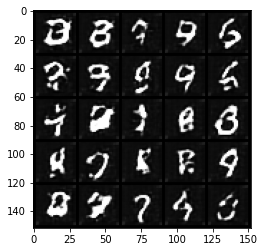

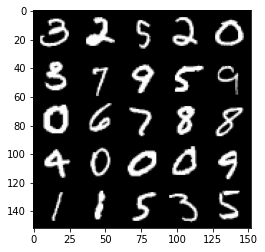

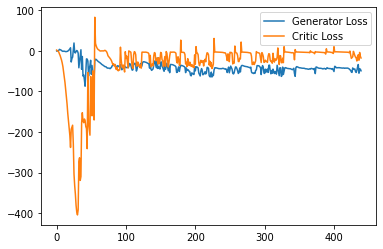

Step 8850: Generator loss: -37.64815093994141, critic loss: -13.5270121819973


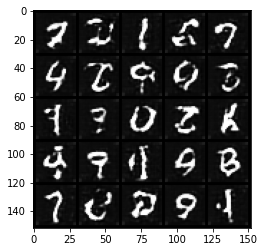

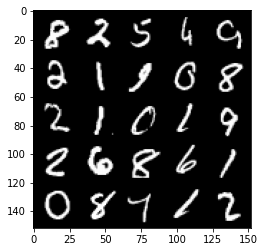

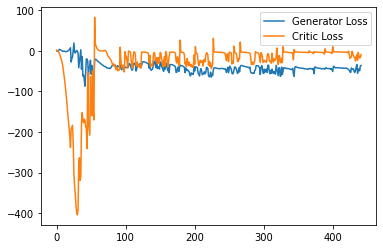

Step 8900: Generator loss: -45.18834087371826, critic loss: -21.08148770141601


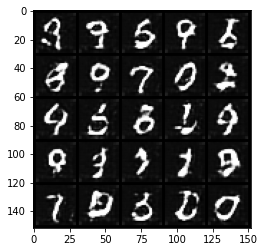

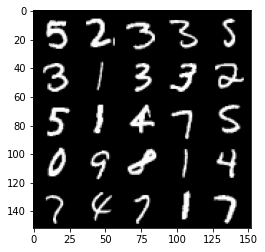

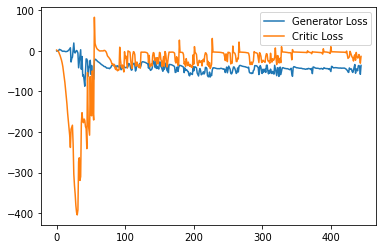

Step 8950: Generator loss: -41.90902069091797, critic loss: -7.139971737384799


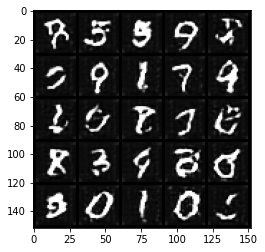

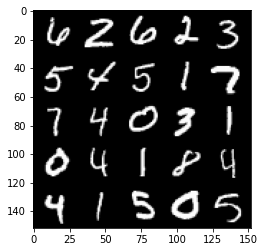

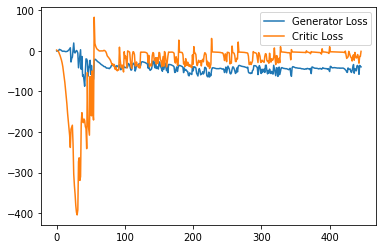

Step 9000: Generator loss: -43.6885520362854, critic loss: -18.476563023090367


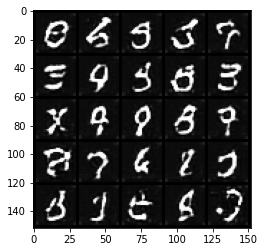

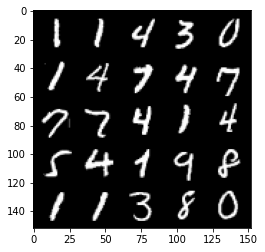

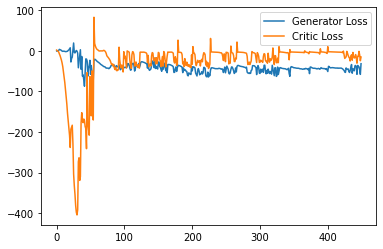

Step 9050: Generator loss: -40.509249982833865, critic loss: -16.17530035972596


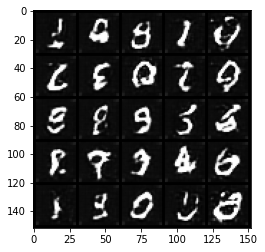

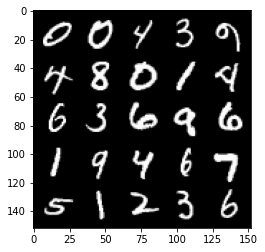

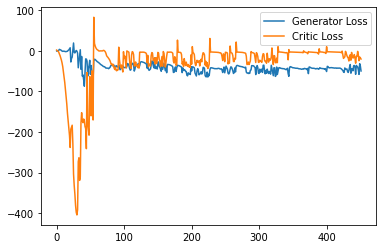

Step 9100: Generator loss: -44.01382621765137, critic loss: -18.28255980873108


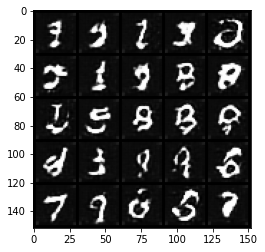

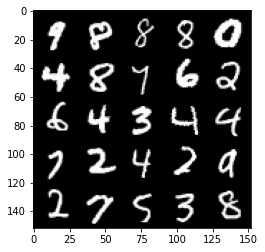

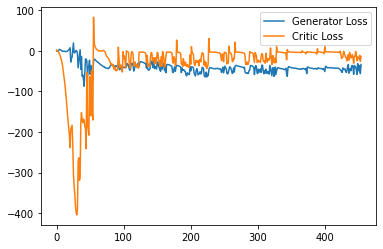

Step 9150: Generator loss: -44.28135383605957, critic loss: -12.070113698005676


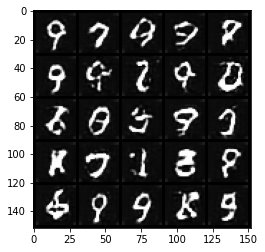

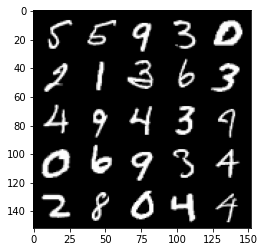

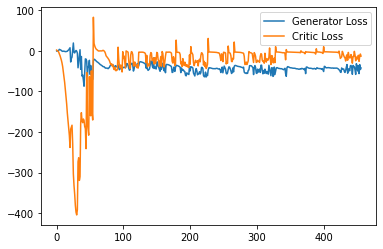

Step 9200: Generator loss: -44.55093681335449, critic loss: -18.982452805519106


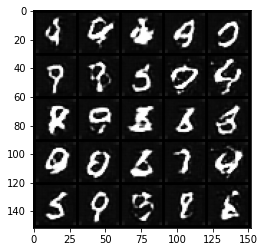

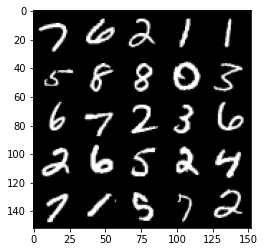

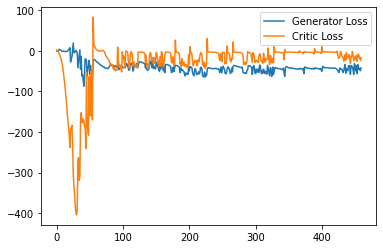

Step 9250: Generator loss: -42.43136444091797, critic loss: -14.311556518554688


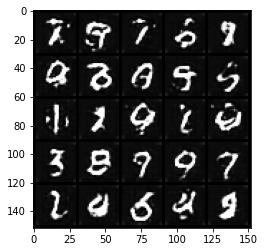

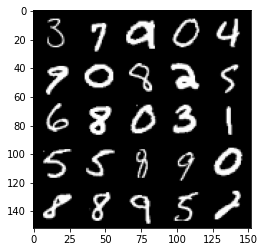

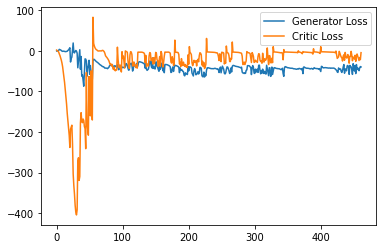

Step 9300: Generator loss: -51.31494777679443, critic loss: -25.98739978313446


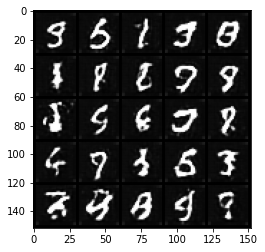

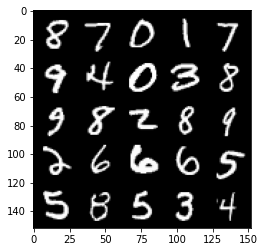

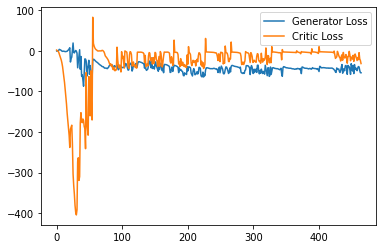

Step 9350: Generator loss: -42.836427459716795, critic loss: -0.7126727991104118


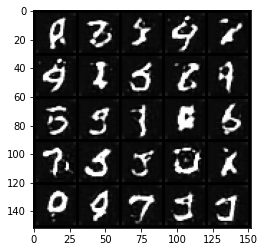

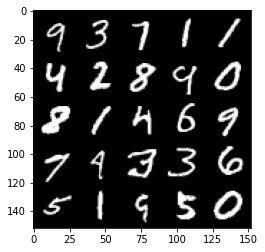

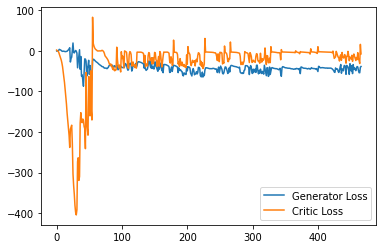

Step 9400: Generator loss: -59.31912010192871, critic loss: -24.47399056577683


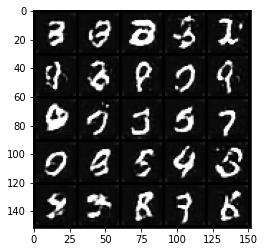

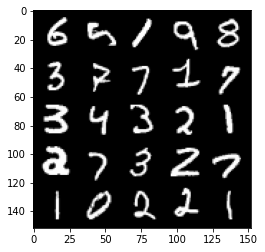

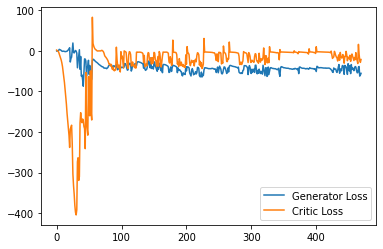

Step 9450: Generator loss: -45.8269393157959, critic loss: -20.137314622879035


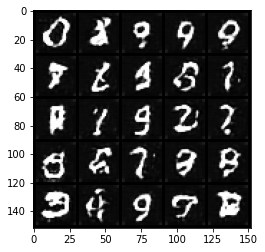

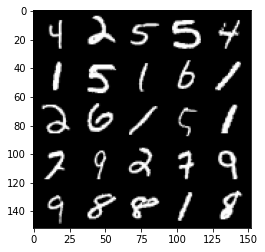

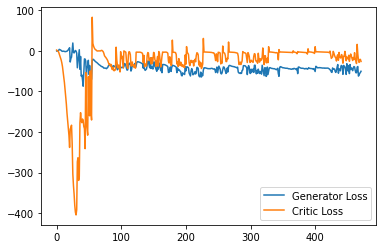

Step 9500: Generator loss: -44.10905418395996, critic loss: -19.36373312187195


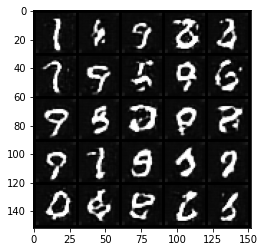

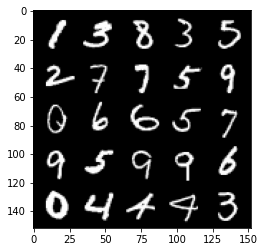

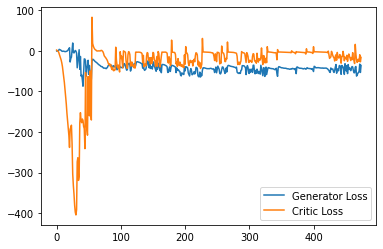

Step 9550: Generator loss: -55.389431953430176, critic loss: -28.636196458816524


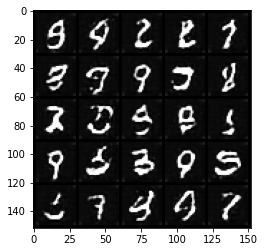

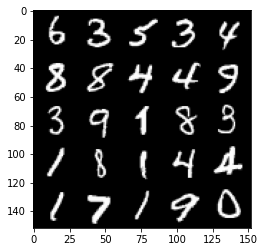

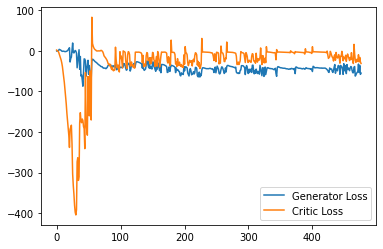

Step 9600: Generator loss: -41.10590606689453, critic loss: -6.764618628501892


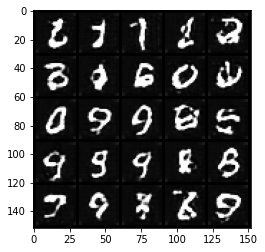

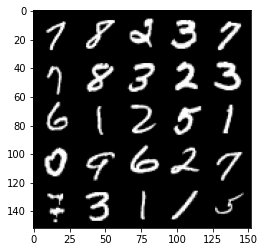

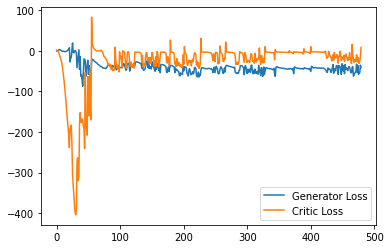

Step 9650: Generator loss: -50.226707191467284, critic loss: -19.057602471828467


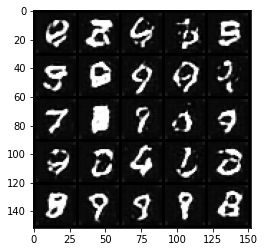

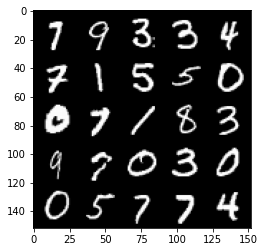

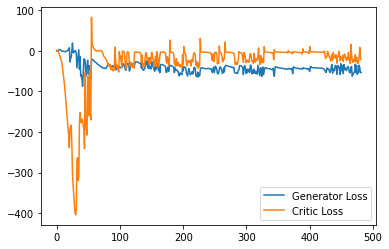

Step 9700: Generator loss: -42.458337059021, critic loss: -19.48777756690979


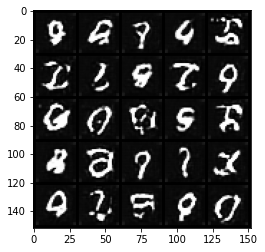

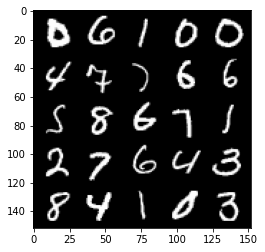

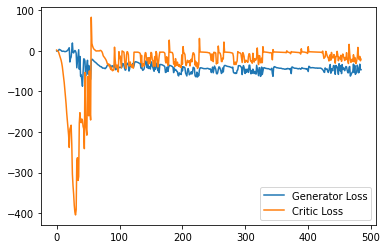

Step 9750: Generator loss: -42.48941213607788, critic loss: -21.41572388458253


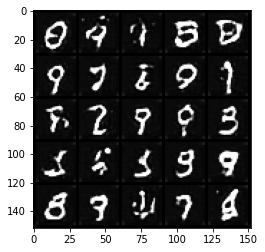

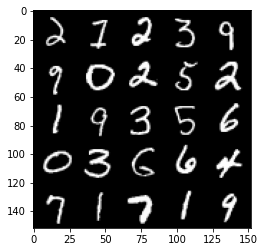

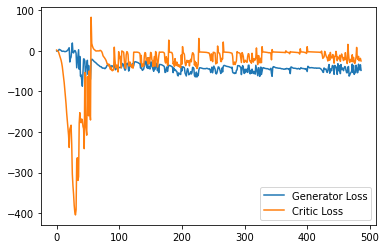

Step 9800: Generator loss: -50.56778388977051, critic loss: -27.512283747196193


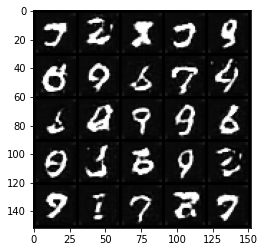

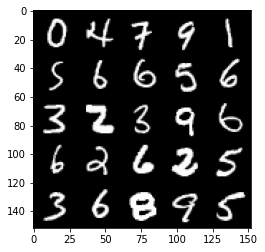

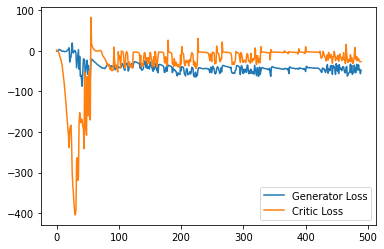

Step 9850: Generator loss: -41.05919813156128, critic loss: -20.200469351768493


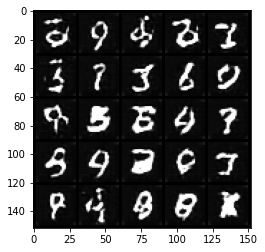

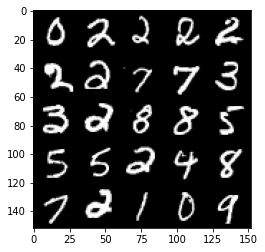

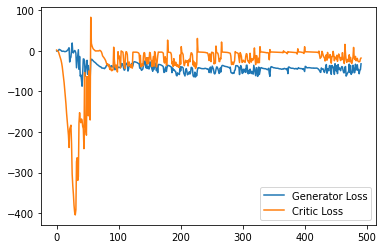

Step 9900: Generator loss: -46.61165866851807, critic loss: -22.849688687324523


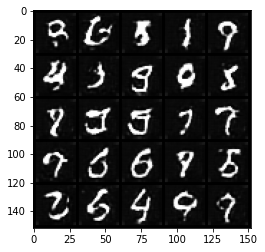

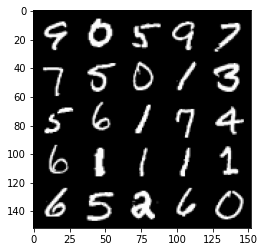

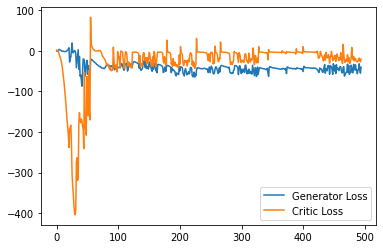

Step 9950: Generator loss: -45.39807598114014, critic loss: -23.0061921248436


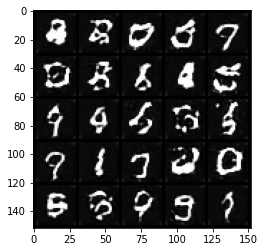

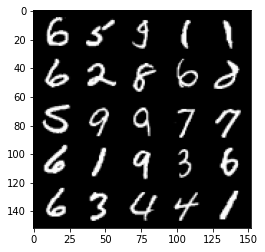

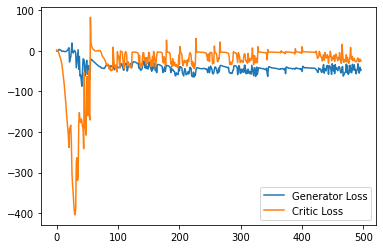

Step 10000: Generator loss: -47.76509300231933, critic loss: -19.19612365555763


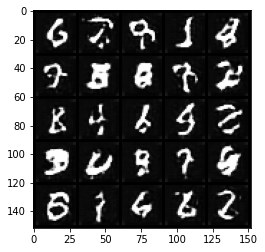

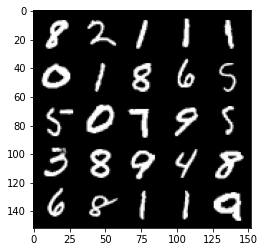

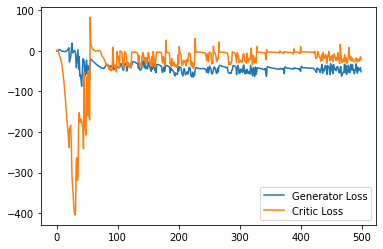

Step 10050: Generator loss: -39.6745450592041, critic loss: 6.544183981895447


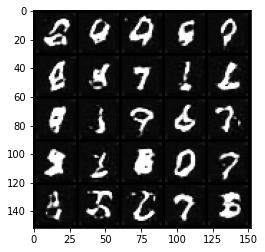

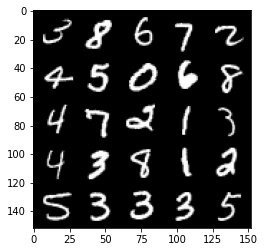

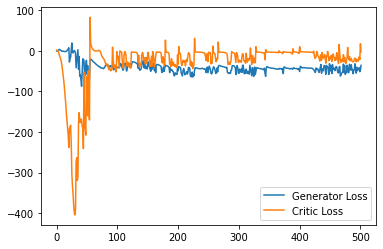

Step 10100: Generator loss: -35.934076385498045, critic loss: -2.09090914106369


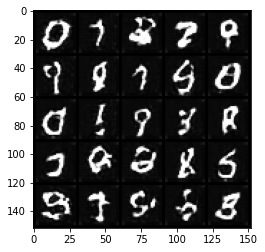

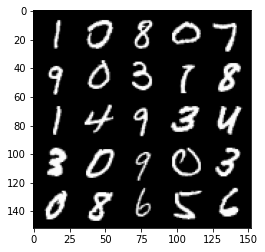

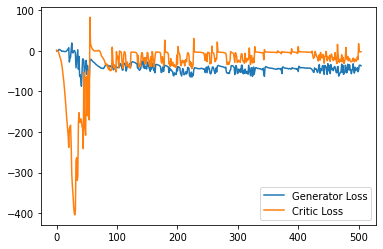

Step 10150: Generator loss: -38.73102149963379, critic loss: -2.3915331110954288


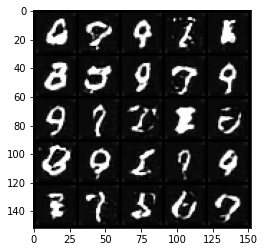

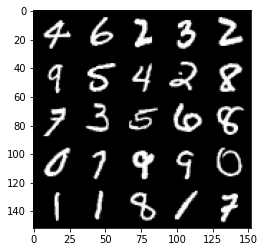

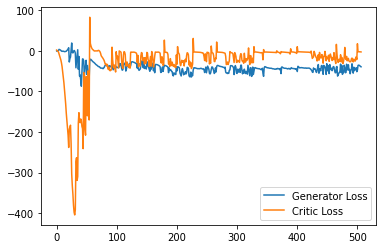

Step 10200: Generator loss: -39.65023536682129, critic loss: -2.9246179189682


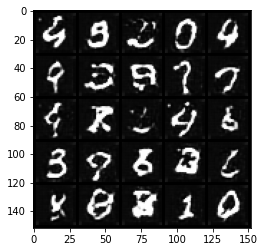

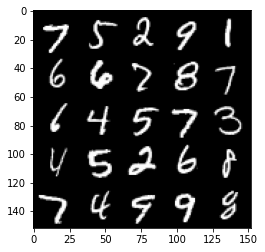

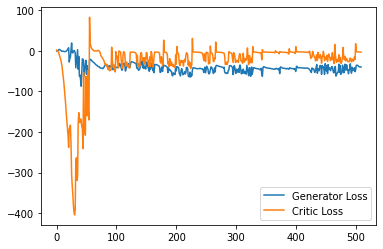

Step 10250: Generator loss: -41.94182083129883, critic loss: -3.845831903934478


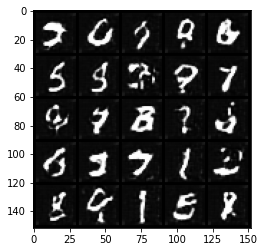

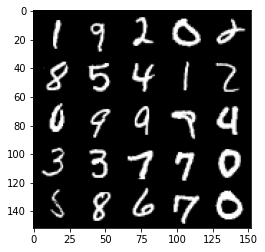

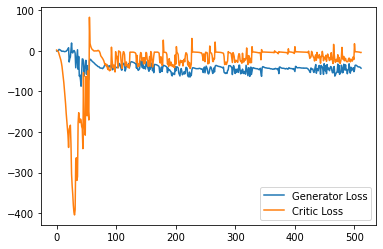

Step 10300: Generator loss: -42.03643226623535, critic loss: -5.148652679920197


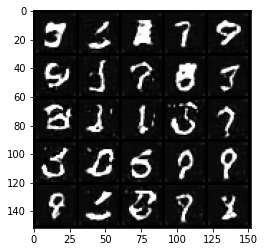

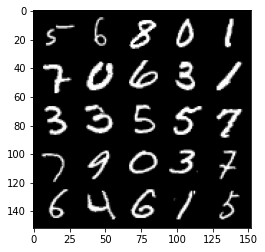

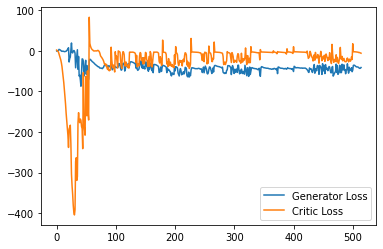

Step 10350: Generator loss: -49.70299877166748, critic loss: -17.888351359844208


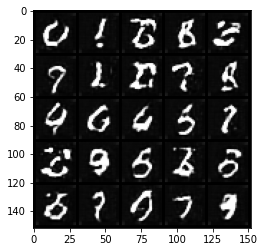

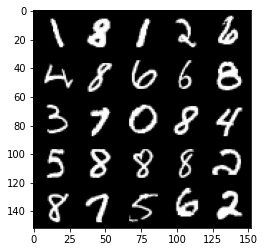

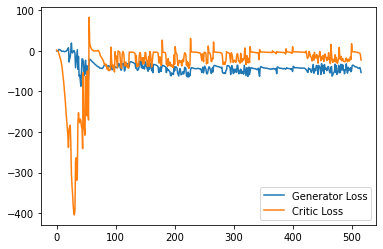

Step 10400: Generator loss: -35.057053546905514, critic loss: -10.402592699289324


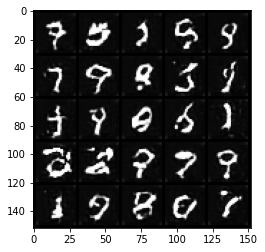

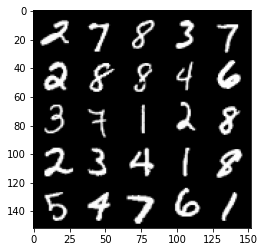

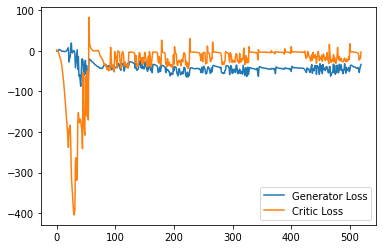

Step 10450: Generator loss: -38.57064001083374, critic loss: -13.982949625849722


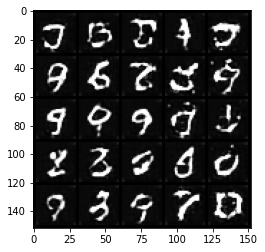

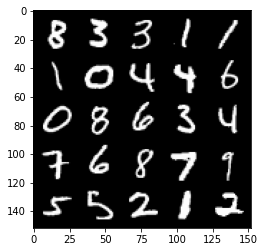

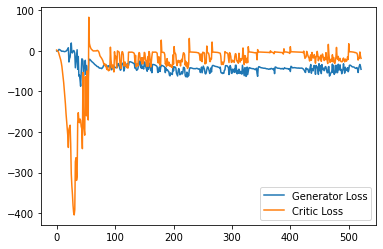

Step 10500: Generator loss: -42.97333024263382, critic loss: -3.8561238844394694


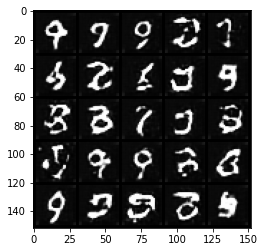

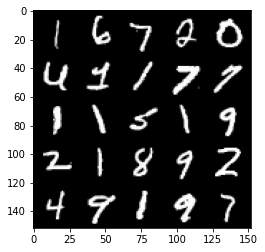

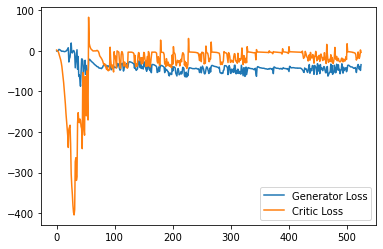

Step 10550: Generator loss: -35.02742088317871, critic loss: -4.291477893829347


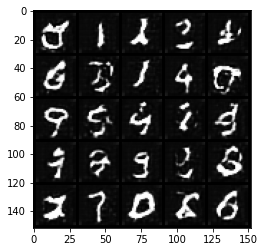

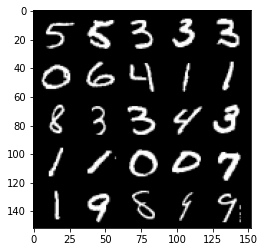

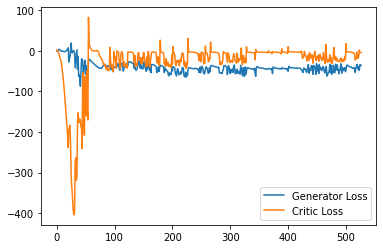

Step 10600: Generator loss: -38.94617279052734, critic loss: -7.4919961991310124


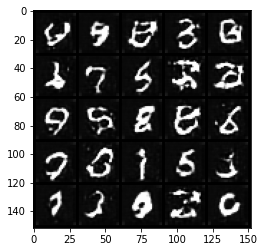

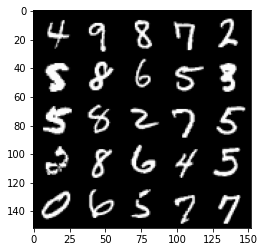

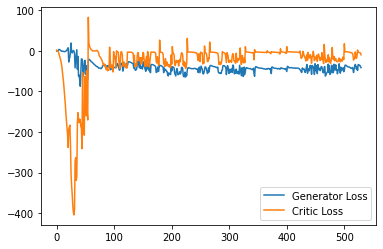

Step 10650: Generator loss: -47.64508903503418, critic loss: -19.318754434108733


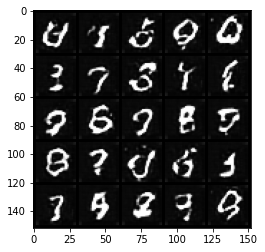

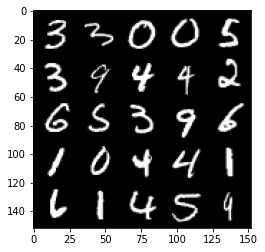

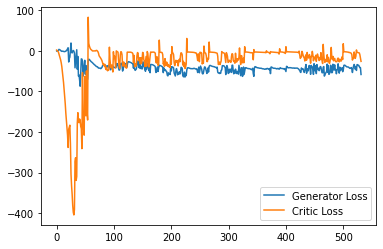

Step 10700: Generator loss: -46.78988868713379, critic loss: -11.34112020254135


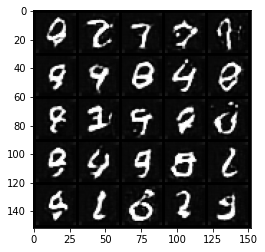

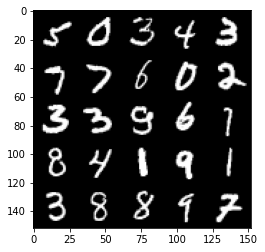

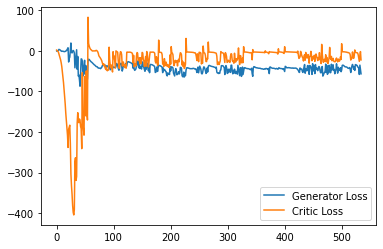

Step 10750: Generator loss: -41.21375150680542, critic loss: -15.830805630683901


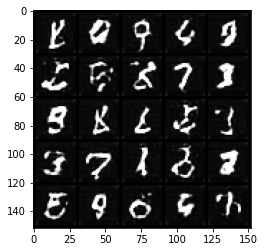

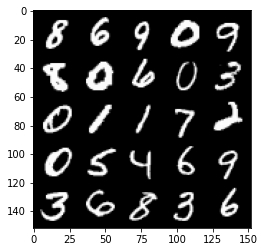

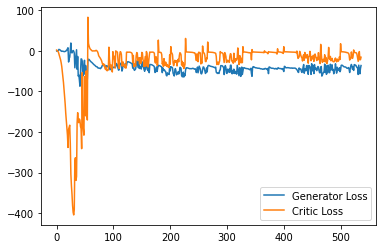

Step 10800: Generator loss: -46.600368919372556, critic loss: -20.97835756039619


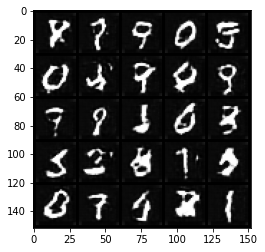

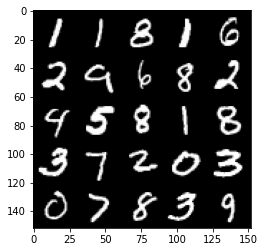

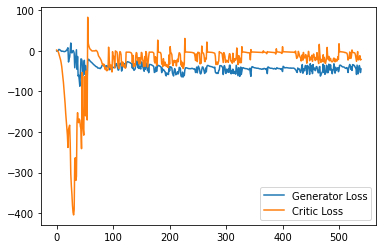

Step 10850: Generator loss: -42.706243896484374, critic loss: -21.776917315244678


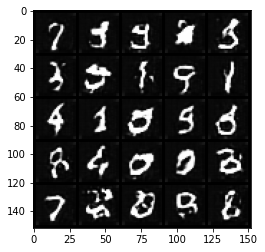

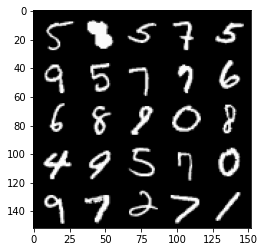

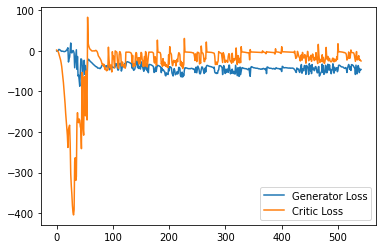

Step 10900: Generator loss: -43.73386270523071, critic loss: -19.460287727832792


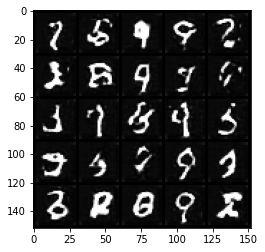

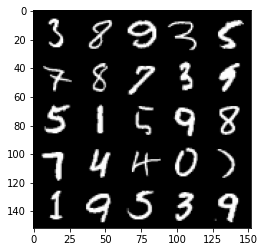

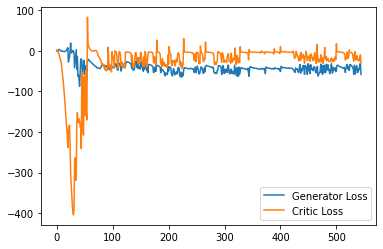

Step 10950: Generator loss: -46.71660794377327, critic loss: -19.857948029994965


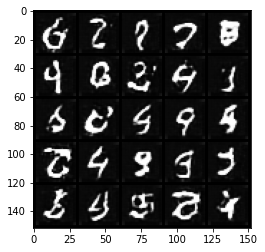

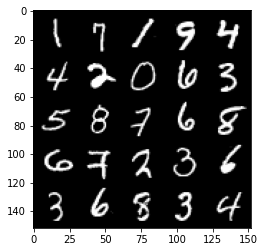

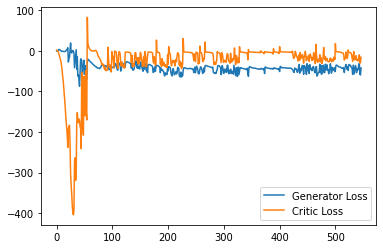

Step 11000: Generator loss: -48.084367694854734, critic loss: -24.04409659528734


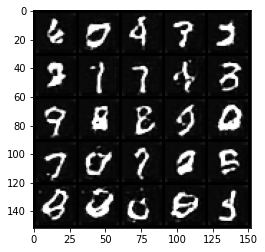

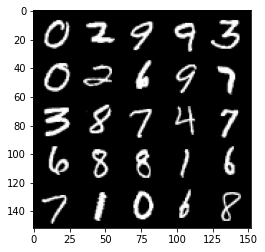

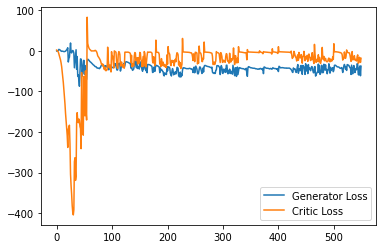

Step 11050: Generator loss: -37.82609149932861, critic loss: 2.743180234670641


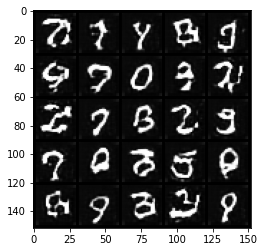

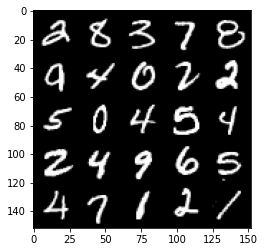

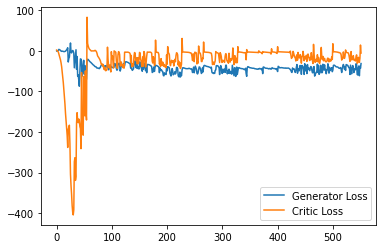

Step 11100: Generator loss: -50.88022254943848, critic loss: -19.273771081447606


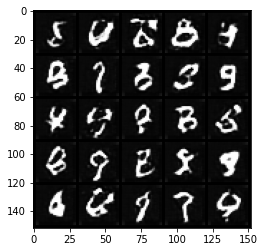

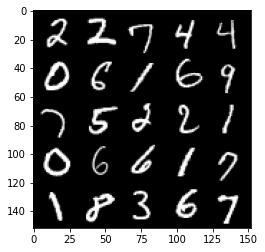

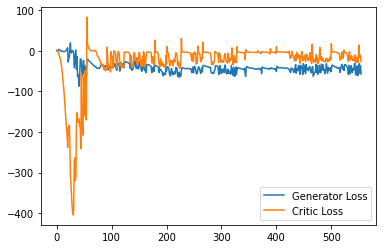

Step 11150: Generator loss: -42.915069313049315, critic loss: -14.105567368745803


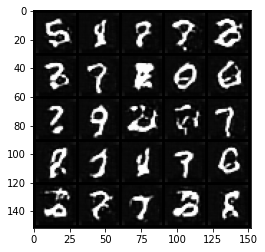

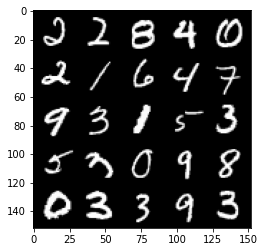

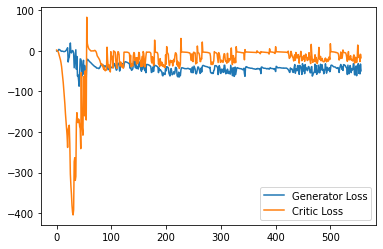

Step 11200: Generator loss: -47.01830535888672, critic loss: -21.761510392189024


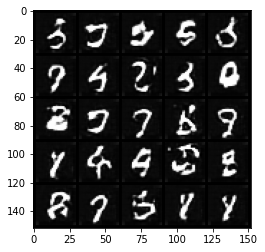

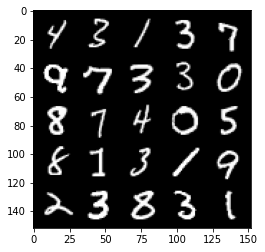

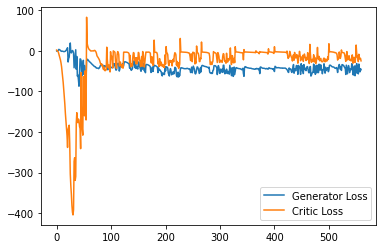

Step 11250: Generator loss: -42.82494571685791, critic loss: -20.3624869017601


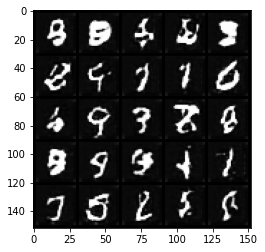

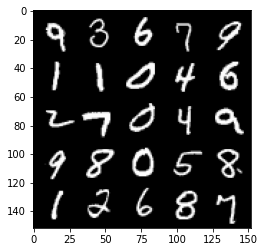

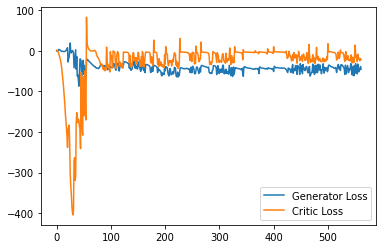

Step 11300: Generator loss: -40.16795153617859, critic loss: -18.436712626218792


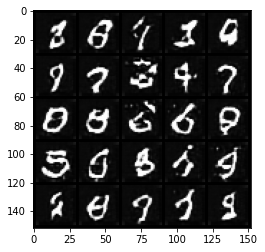

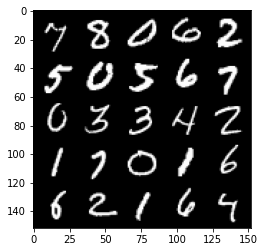

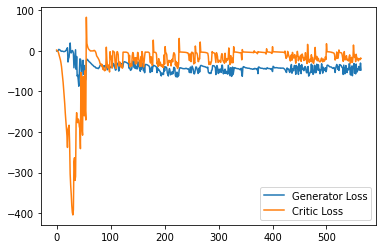

Step 11350: Generator loss: -50.348954610824585, critic loss: -23.87637599992752


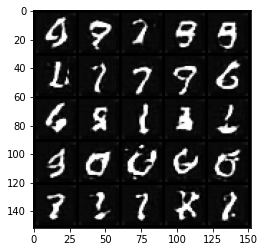

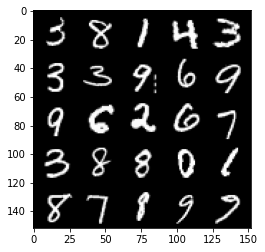

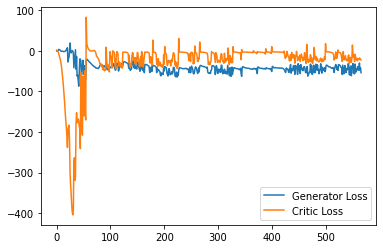

Step 11400: Generator loss: -51.820458984375, critic loss: -15.547458606719973


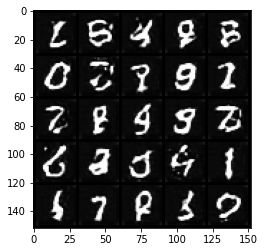

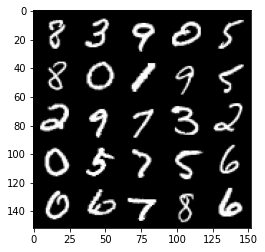

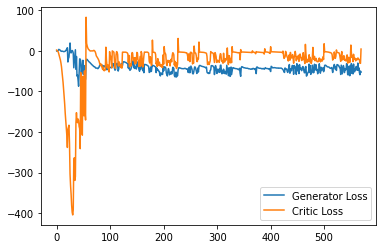

Step 11450: Generator loss: -48.5203498840332, critic loss: -15.214078534603118


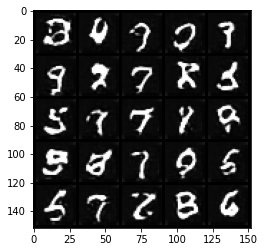

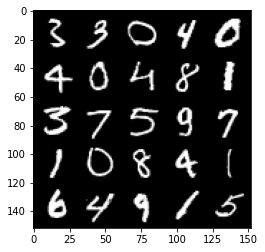

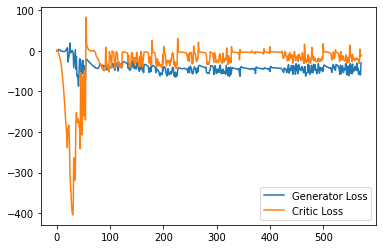

Step 11500: Generator loss: -39.957411950826646, critic loss: -19.697709028244017


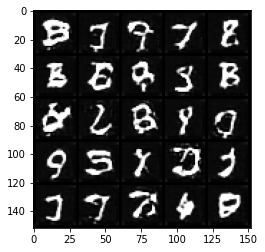

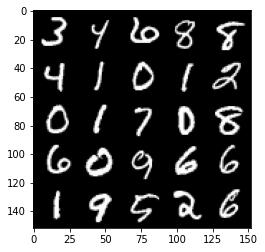

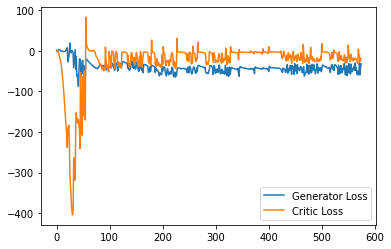

Step 11550: Generator loss: -47.64064525604248, critic loss: -17.861085588455204


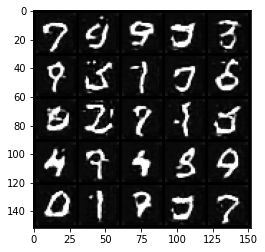

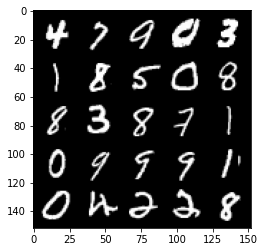

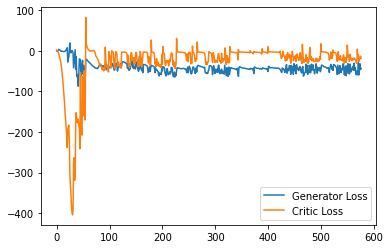

Step 11600: Generator loss: -42.34359691619873, critic loss: -16.410263989925387


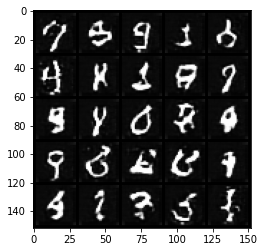

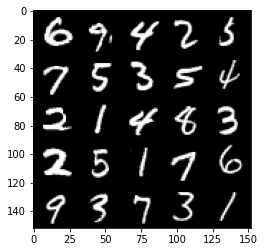

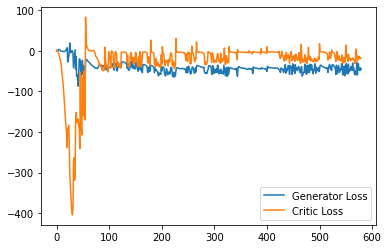

Step 11650: Generator loss: -46.068787574768066, critic loss: -18.505645813941953


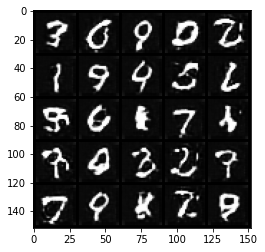

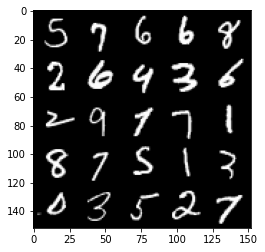

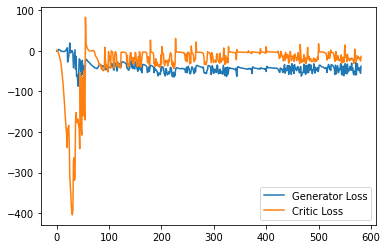

Step 11700: Generator loss: -42.684323673248294, critic loss: -18.924791001319885


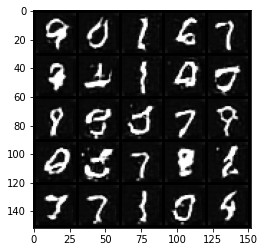

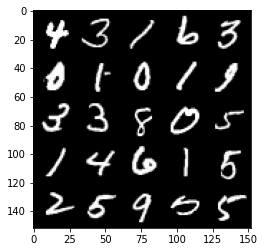

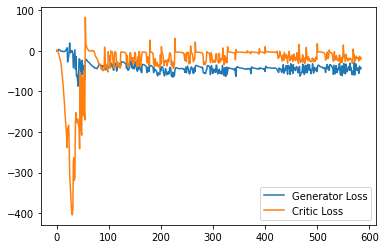

Step 11750: Generator loss: -51.37856494903564, critic loss: -22.60836860966682


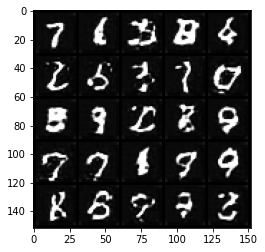

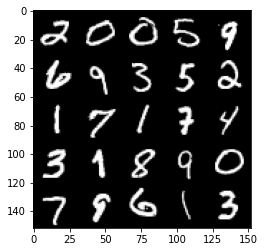

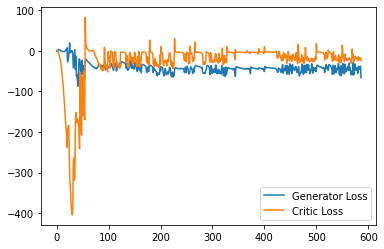

Step 11800: Generator loss: -44.80883548736572, critic loss: -18.03637709283829


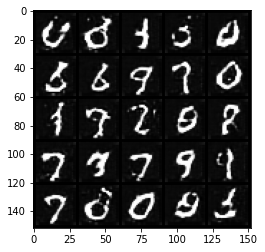

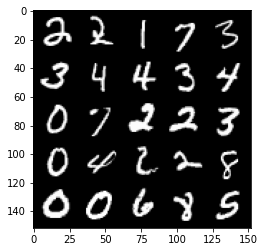

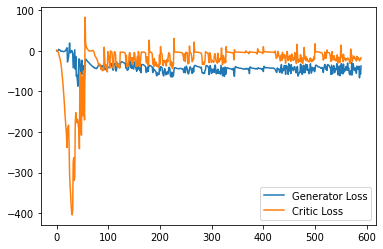

Step 11850: Generator loss: -55.94837291717529, critic loss: -24.084008327484124


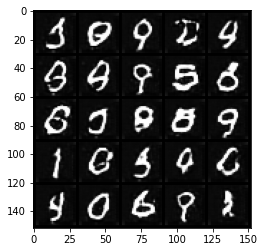

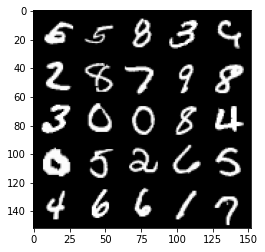

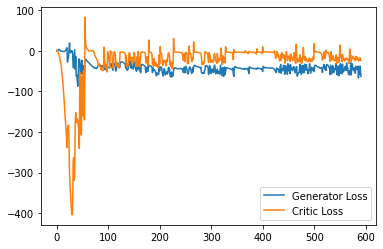

Step 11900: Generator loss: -48.32511207580566, critic loss: -20.014897641420358


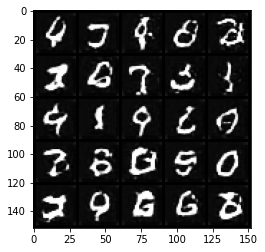

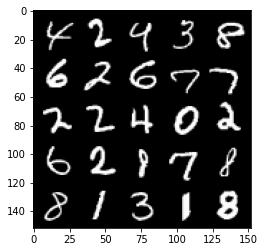

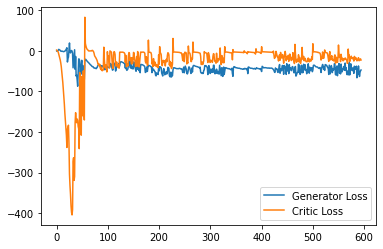

Step 11950: Generator loss: -47.05489479064941, critic loss: -5.621815354347229


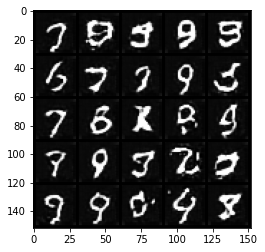

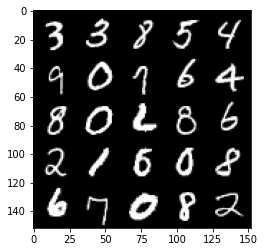

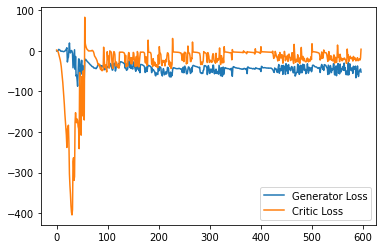

Step 12000: Generator loss: -39.969034881591796, critic loss: -3.028613067626952


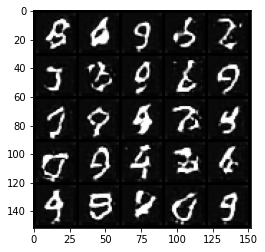

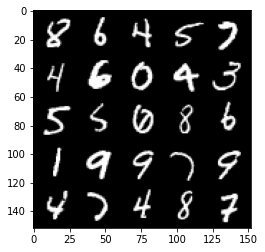

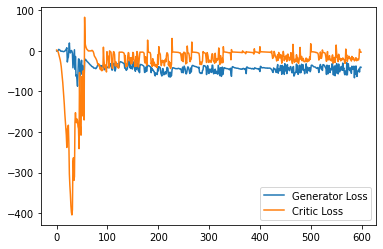

Step 12050: Generator loss: -41.742256546020506, critic loss: -3.0495319361686692


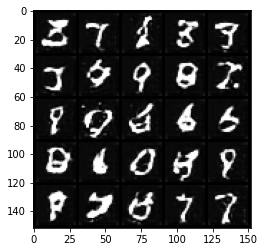

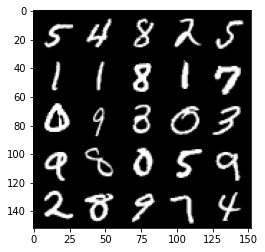

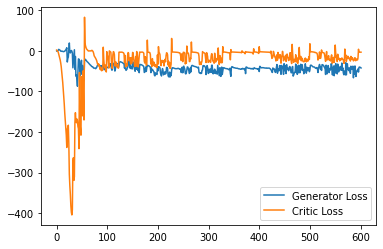

Step 12100: Generator loss: -48.02092506408692, critic loss: -6.725123547554017


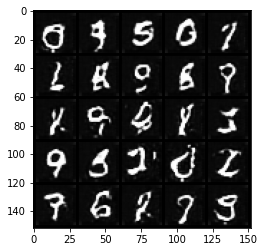

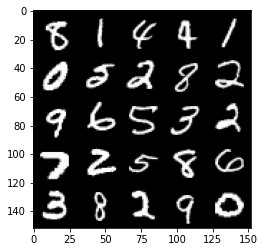

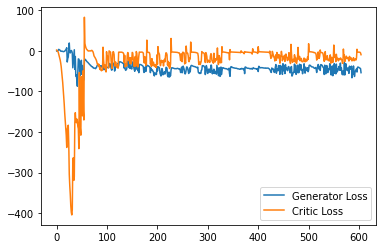

Step 12150: Generator loss: -45.798740768432616, critic loss: -4.450759669542313


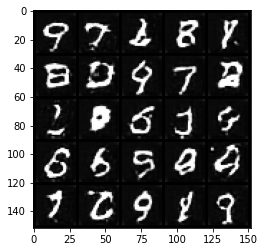

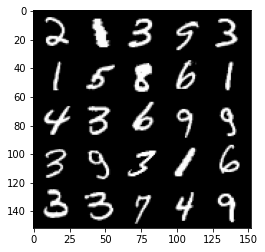

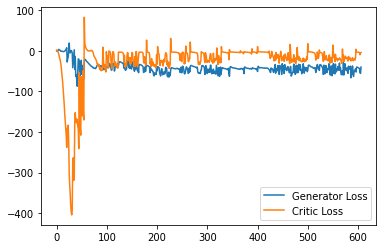

Step 12200: Generator loss: -50.89497787475586, critic loss: -17.949625798225405


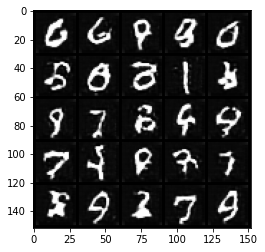

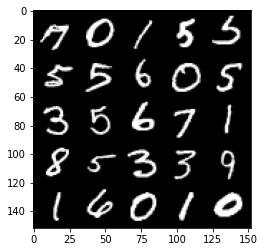

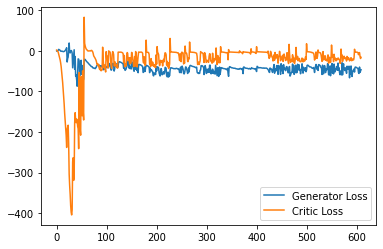

Step 12250: Generator loss: -54.21014247894287, critic loss: -19.105561202049255


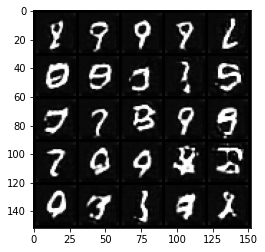

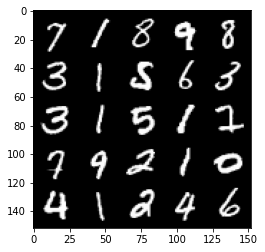

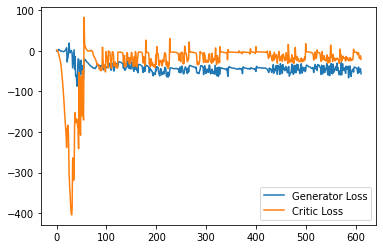

Step 12300: Generator loss: -43.7122998046875, critic loss: 2.061106310367586


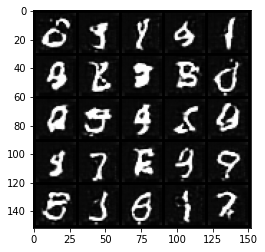

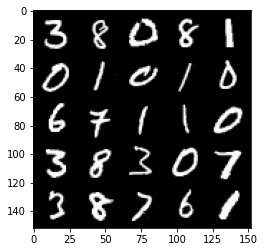

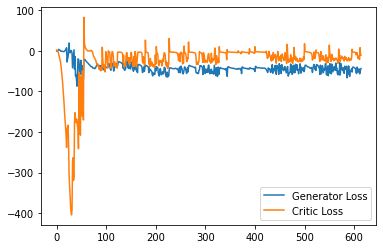

Step 12350: Generator loss: -60.94531181335449, critic loss: -22.22378093767166


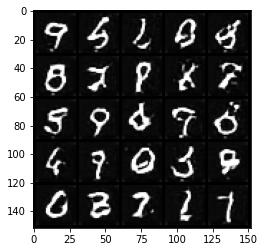

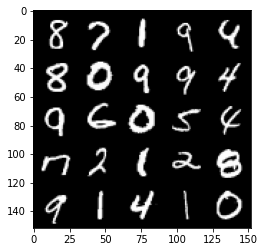

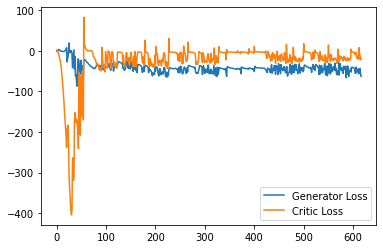

Step 12400: Generator loss: -39.80302940368652, critic loss: -14.823735803604125


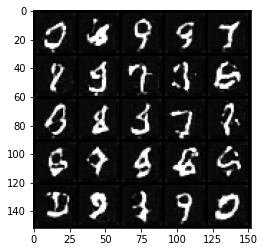

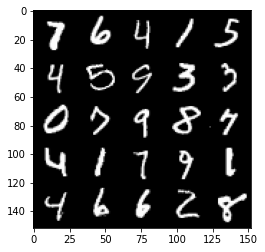

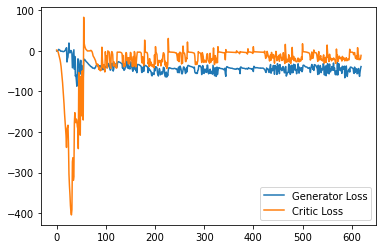

Step 12450: Generator loss: -44.852843284606934, critic loss: -15.377164797544479


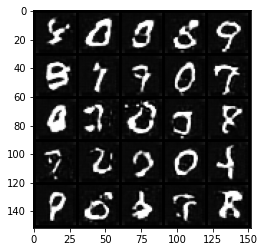

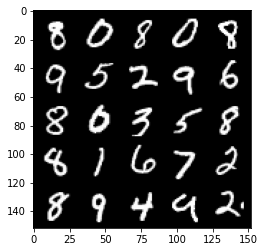

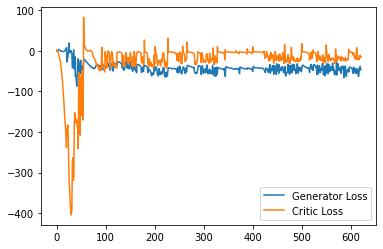

Step 12500: Generator loss: -56.23538917541504, critic loss: -24.27339959168434


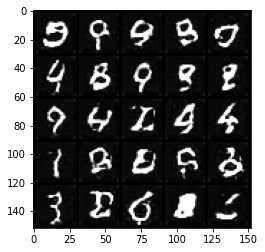

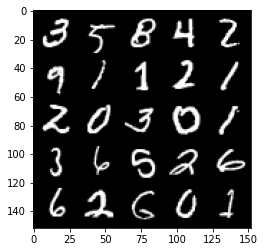

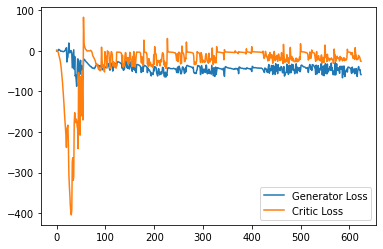

Step 12550: Generator loss: -43.96385876655579, critic loss: -20.527066376209255


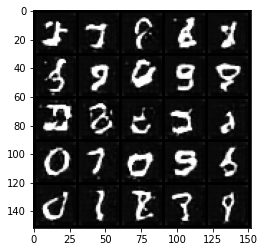

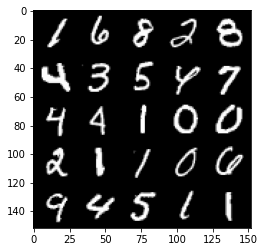

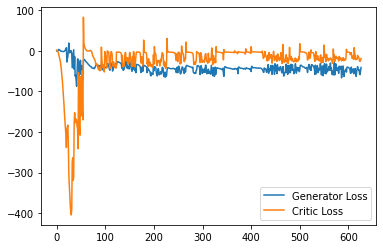

Step 12600: Generator loss: -53.54959091186524, critic loss: -20.505933250427244


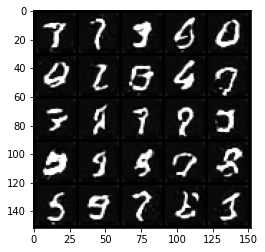

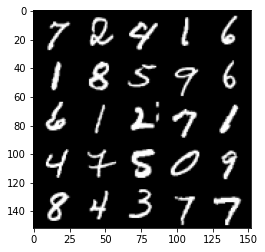

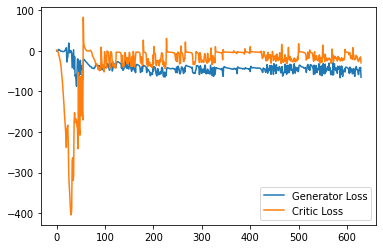

Step 12650: Generator loss: -52.01396335601807, critic loss: -21.214120332717897


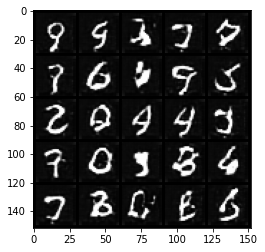

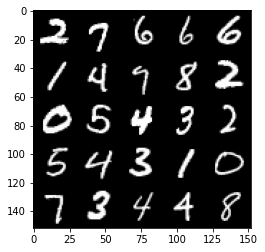

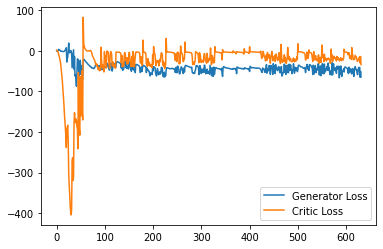

Step 12700: Generator loss: -44.50901636600494, critic loss: -16.254459357023244


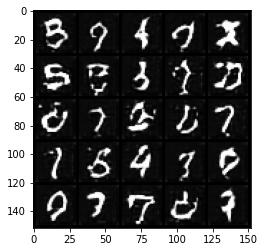

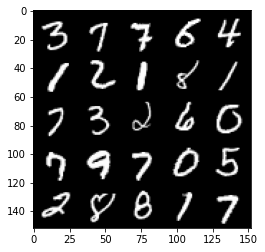

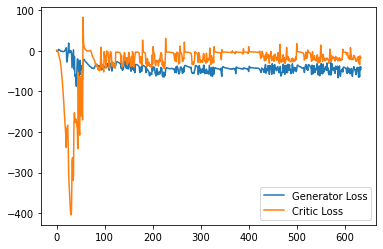

Step 12750: Generator loss: -45.70107566833496, critic loss: -13.417801462650305


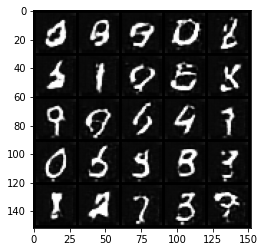

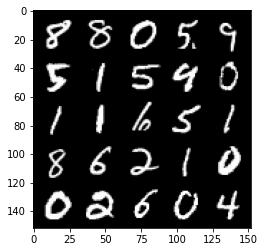

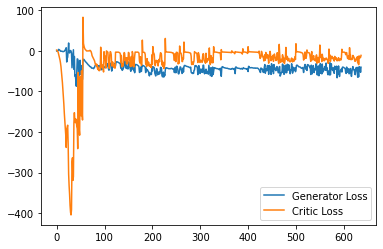

Step 12800: Generator loss: -57.98760983079672, critic loss: -25.327014939785


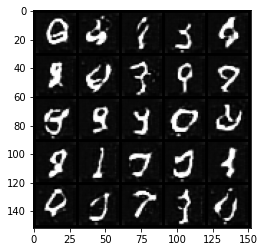

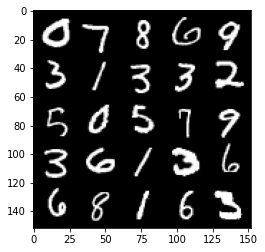

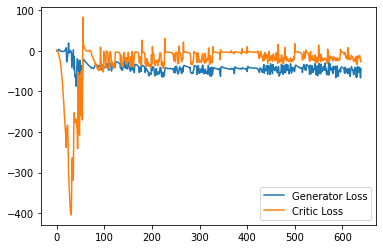

Step 12850: Generator loss: -58.858854579925534, critic loss: -23.642415997028355


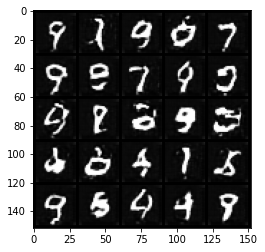

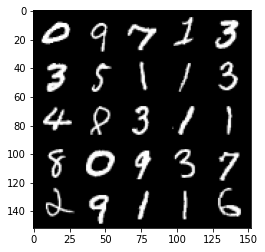

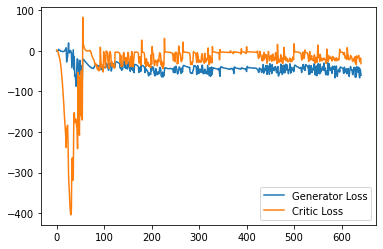

Step 12900: Generator loss: -43.620398378372194, critic loss: -6.849658658266066


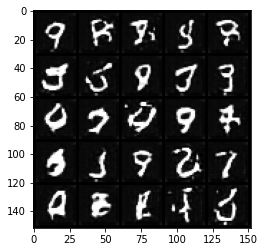

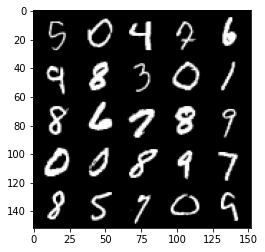

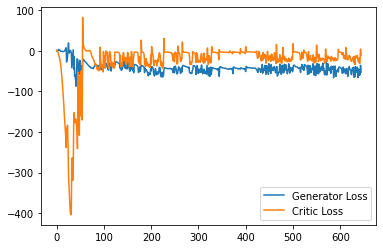

Step 12950: Generator loss: -52.84101734161377, critic loss: -17.422956704378134


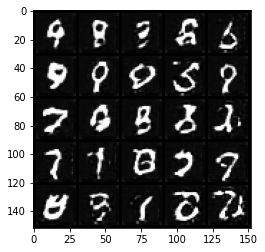

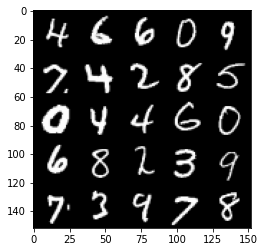

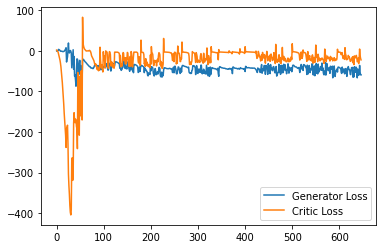

Step 13000: Generator loss: -48.07821720123291, critic loss: -20.43465731191635


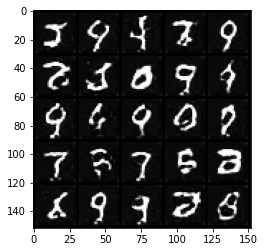

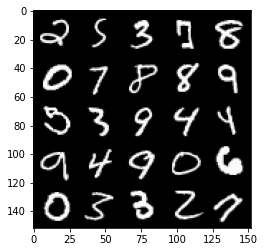

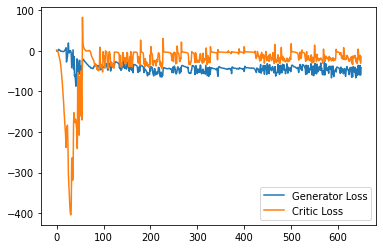

Step 13050: Generator loss: -57.65955402374268, critic loss: -18.08708313846588


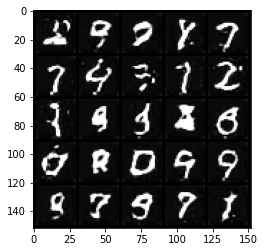

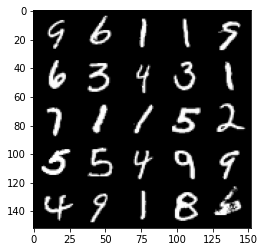

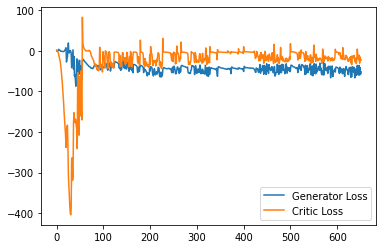

Step 13100: Generator loss: -49.06181162834167, critic loss: -15.59221449899673


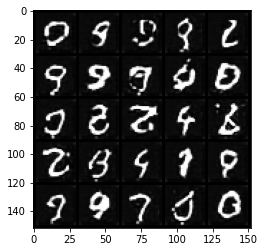

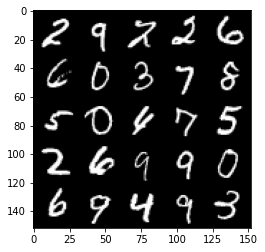

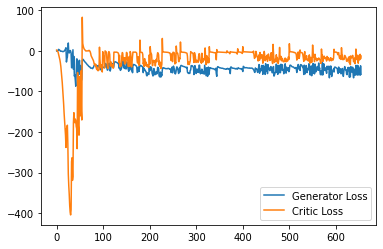

Step 13150: Generator loss: -50.204754762649536, critic loss: -17.805734380722043


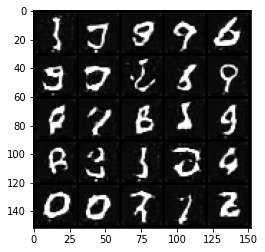

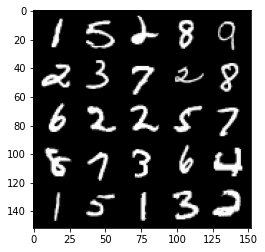

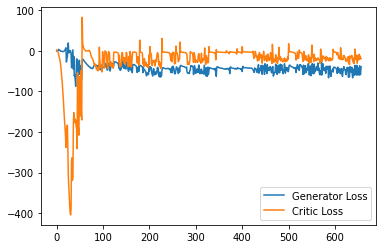

Step 13200: Generator loss: -61.82220775604248, critic loss: -23.892953548431397


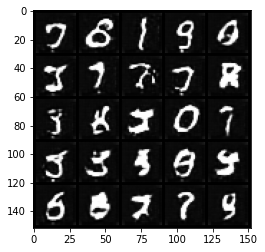

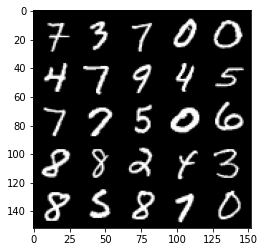

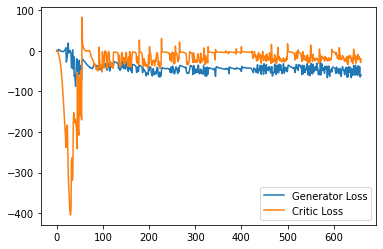

Step 13250: Generator loss: -40.61086313247681, critic loss: -19.814182288169867


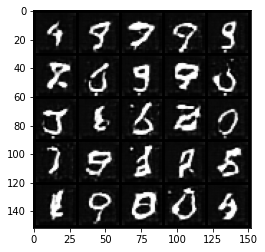

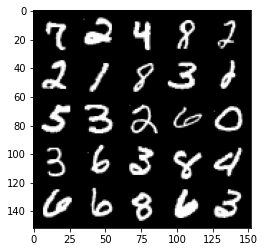

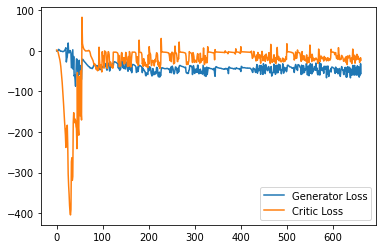

Step 13300: Generator loss: -63.04276695251465, critic loss: -25.38692304396629


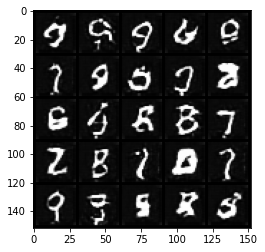

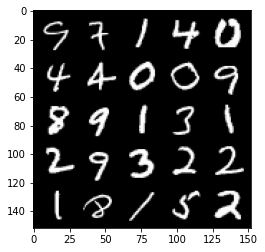

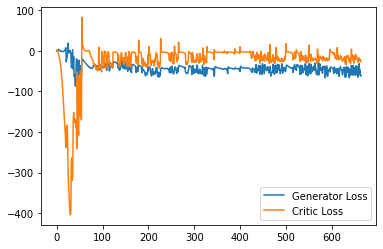

Step 13350: Generator loss: -45.26986276626587, critic loss: -6.10467271089554


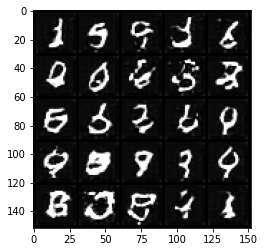

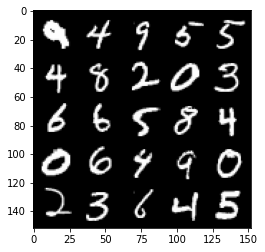

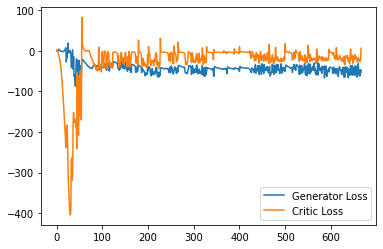

Step 13400: Generator loss: -53.21632064819336, critic loss: -21.221222103118894


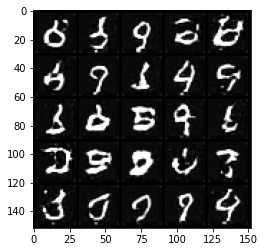

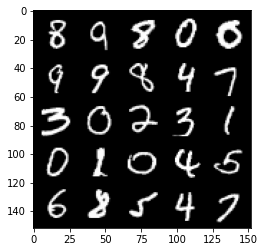

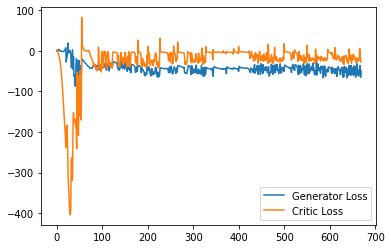

Step 13450: Generator loss: -55.37419731140137, critic loss: -20.669387294769287


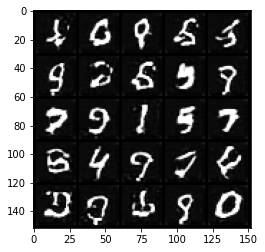

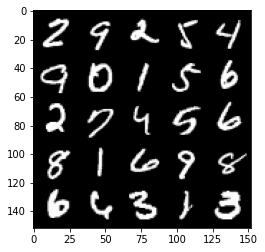

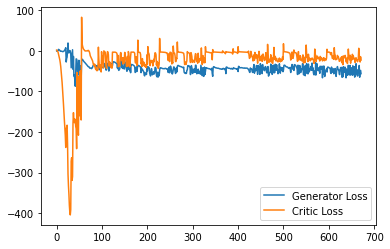

Step 13500: Generator loss: -45.24657709121704, critic loss: -17.46509154462814


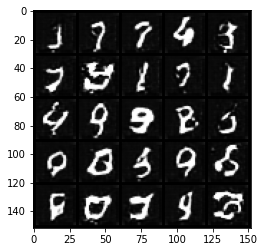

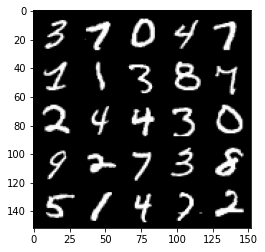

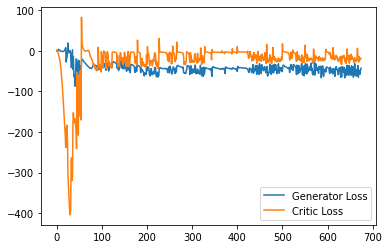

Step 13550: Generator loss: -51.247464714050295, critic loss: -18.465395891189573


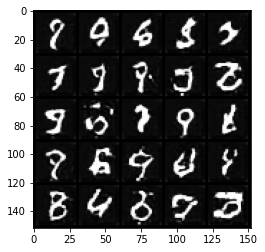

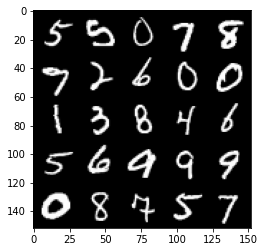

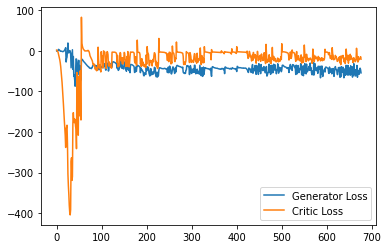

Step 13600: Generator loss: -50.381585655212405, critic loss: -15.802188222885134


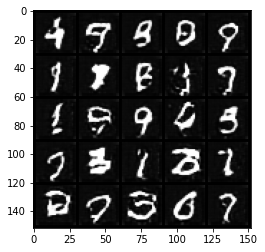

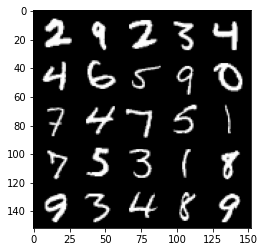

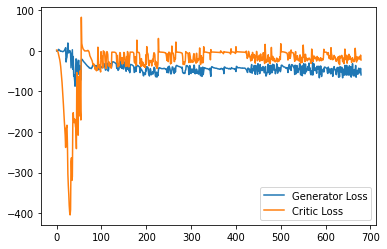

Step 13650: Generator loss: -53.903389320373535, critic loss: -12.875111401319502


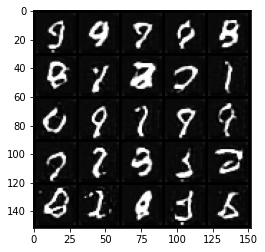

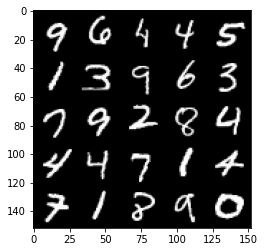

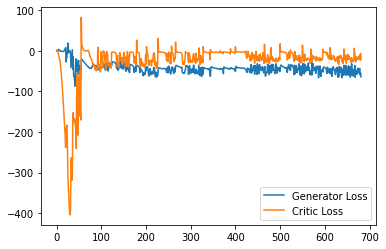

Step 13700: Generator loss: -44.042211074829105, critic loss: -17.52773496294021


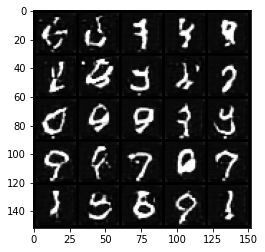

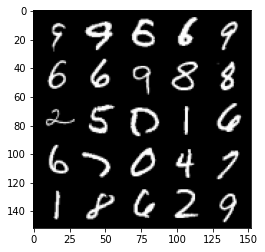

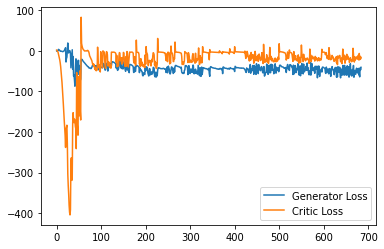

Step 13750: Generator loss: -51.45450054168701, critic loss: -15.860712921619417


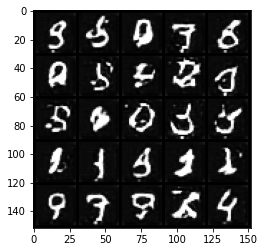

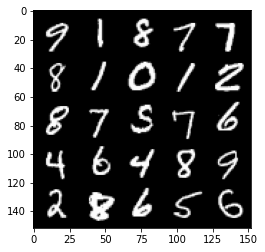

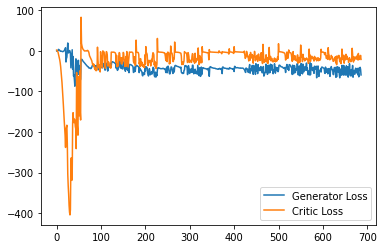

Step 13800: Generator loss: -50.23339378356933, critic loss: -19.86060443639755


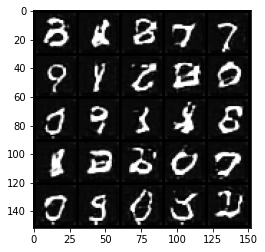

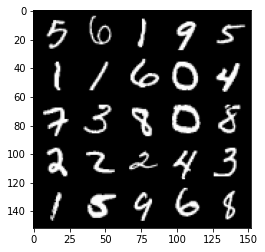

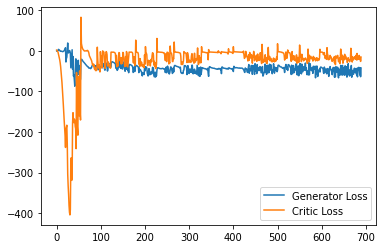

Step 13850: Generator loss: -54.00754871368408, critic loss: -20.24532806873322


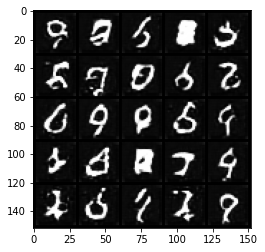

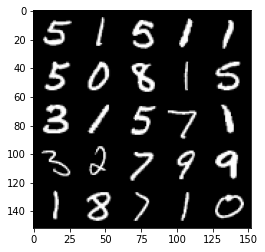

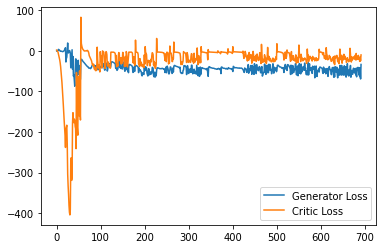

Step 13900: Generator loss: -51.981605796813966, critic loss: -21.31438953161239


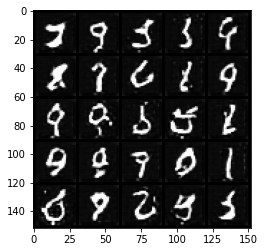

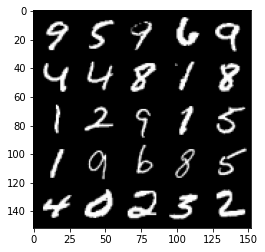

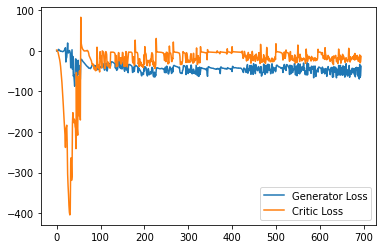

Step 13950: Generator loss: -44.56015263557434, critic loss: -16.85108821773529


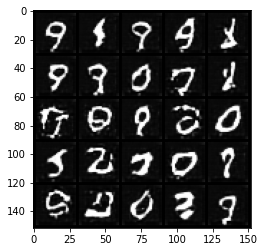

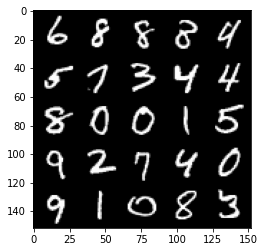

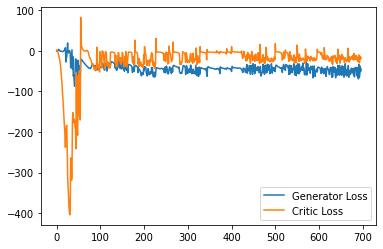

Step 14000: Generator loss: -54.406243572235105, critic loss: -23.206081590890886


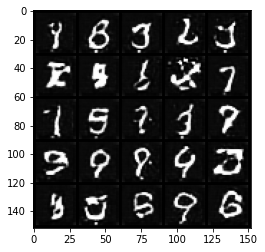

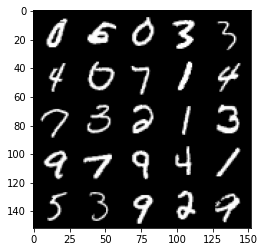

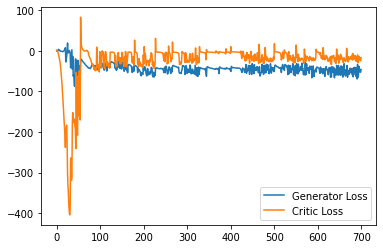

Step 14050: Generator loss: -52.42380218505859, critic loss: -1.6148218448162093


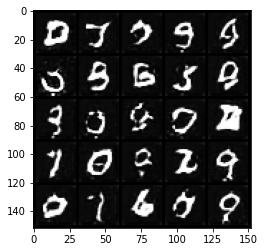

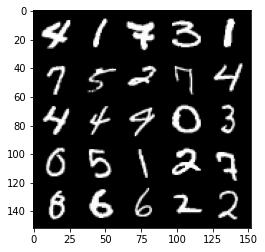

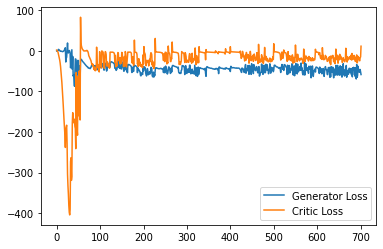

Step 14100: Generator loss: -56.50761734008789, critic loss: -16.48987971067429


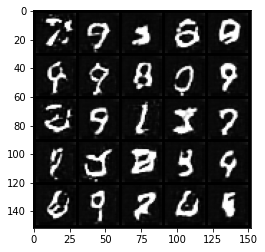

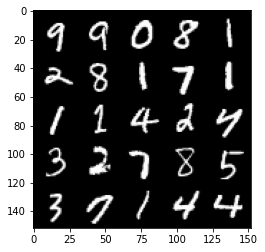

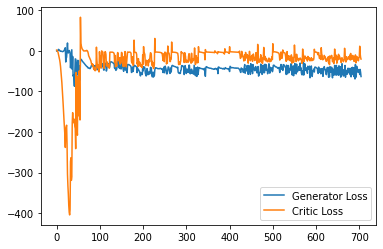

Step 14150: Generator loss: -45.314774627685544, critic loss: -15.869842256784441


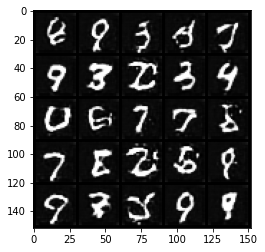

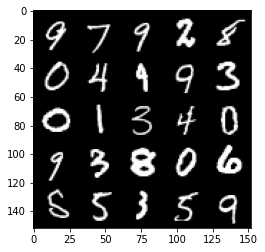

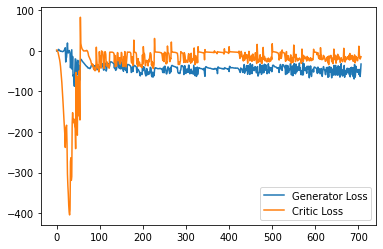

Step 14200: Generator loss: -57.69677017211914, critic loss: -19.925618527650833


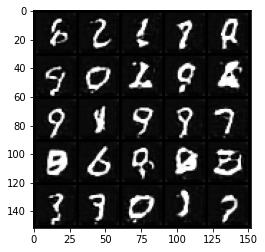

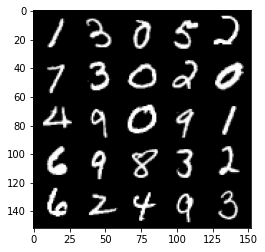

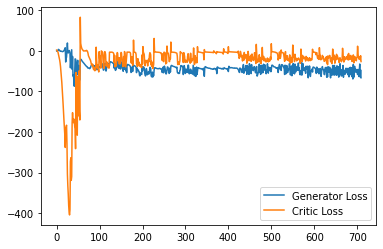

Step 14250: Generator loss: -48.53125846862793, critic loss: -17.30247762441635


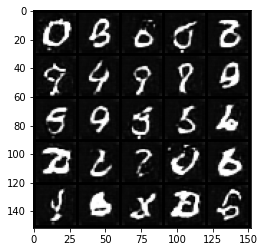

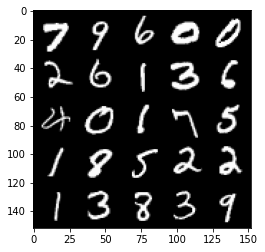

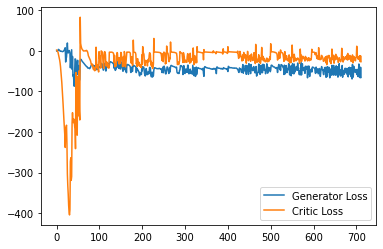

Step 14300: Generator loss: -50.66161945343018, critic loss: -17.113937782049177


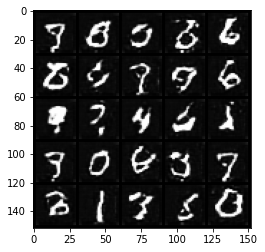

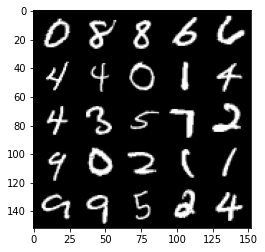

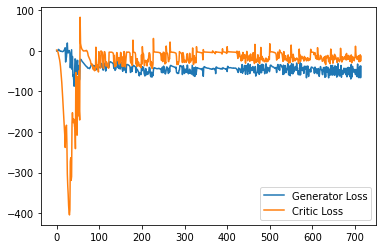

Step 14350: Generator loss: -50.34209915161133, critic loss: -16.624984532356258


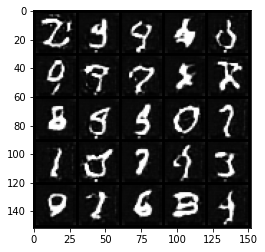

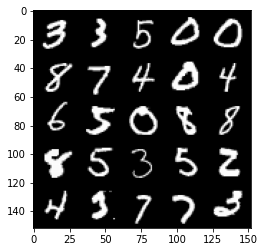

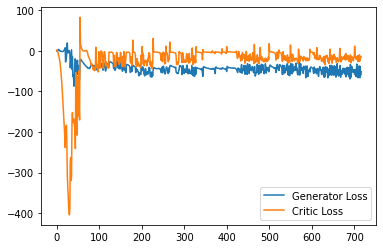

Step 14400: Generator loss: -47.99476516723633, critic loss: -18.27206455516815


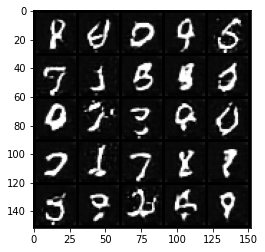

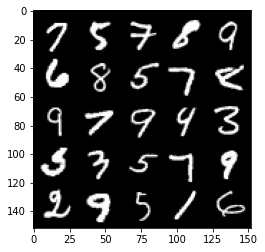

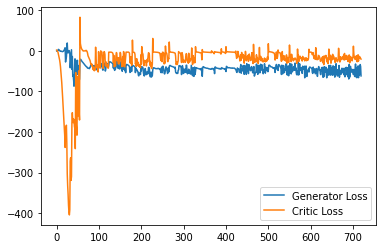

Step 14450: Generator loss: -50.87048519134522, critic loss: -17.005130866527555


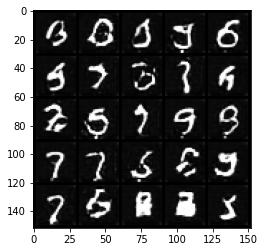

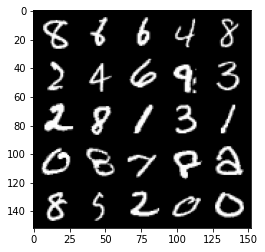

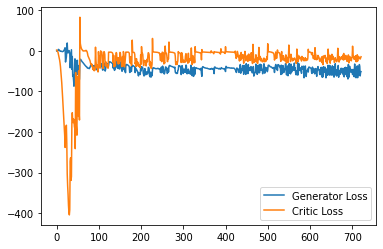

Step 14500: Generator loss: -59.444250087738034, critic loss: -8.013158646583559


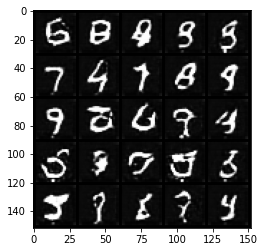

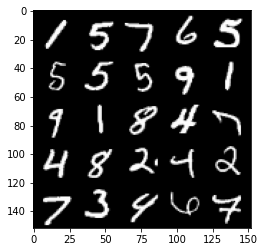

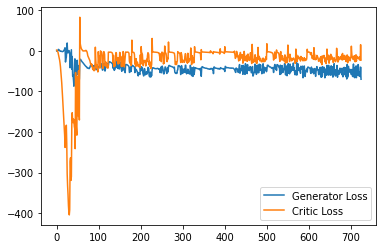

Step 14550: Generator loss: -44.07346782684326, critic loss: -13.245531494617461


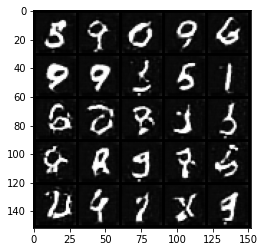

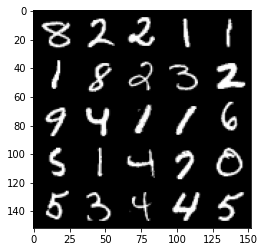

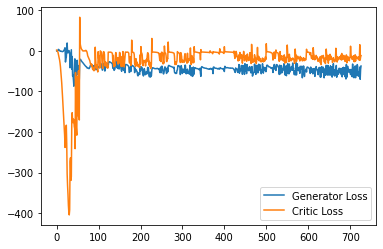

Step 14600: Generator loss: -54.57300855636597, critic loss: -19.759897165775303


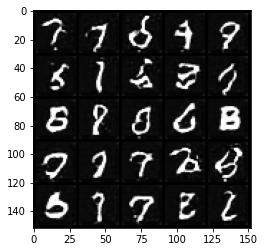

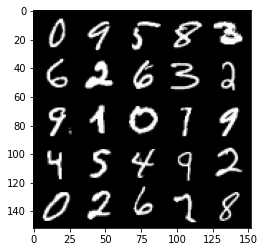

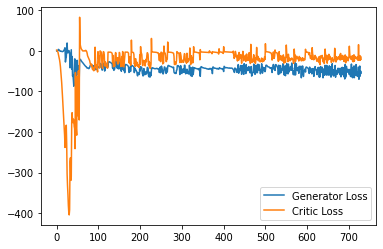

Step 14650: Generator loss: -47.668553047180175, critic loss: -17.53169717979431


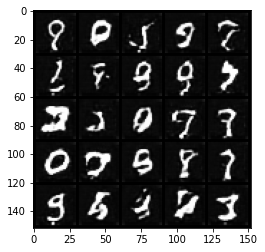

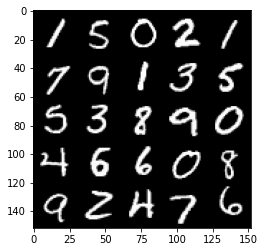

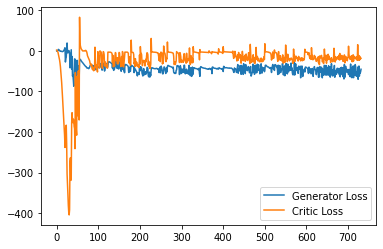

Step 14700: Generator loss: -52.325231175422665, critic loss: -19.70210463809967


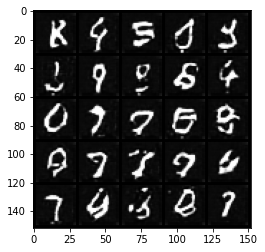

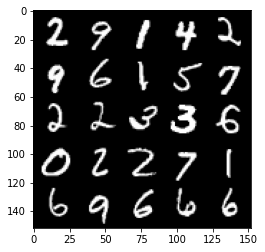

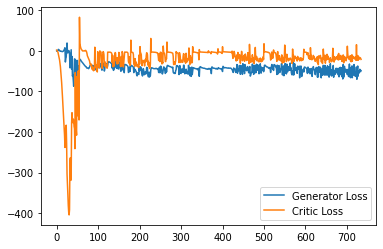

Step 14750: Generator loss: -54.5450895690918, critic loss: -20.965768589973454


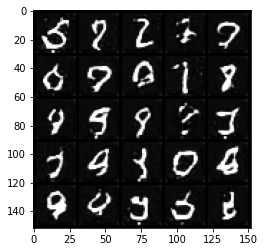

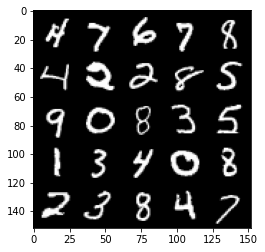

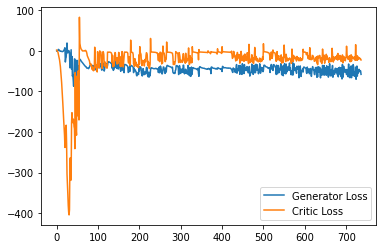

Step 14800: Generator loss: -49.53336597442627, critic loss: -11.59109680342674


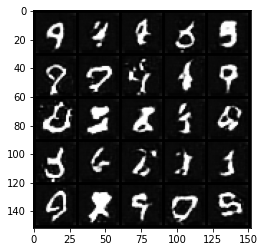

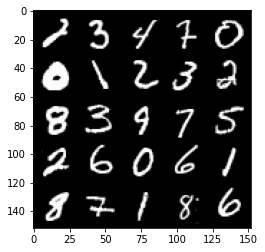

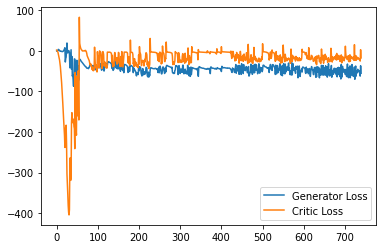

Step 14850: Generator loss: -58.12885051727295, critic loss: -21.884014859676363


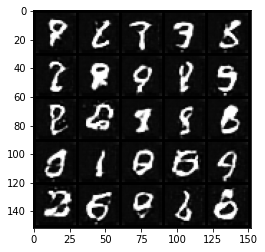

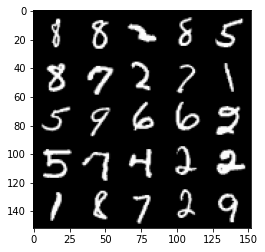

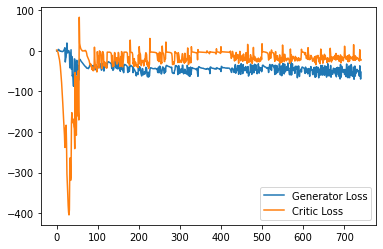

Step 14900: Generator loss: -52.71613758087158, critic loss: -20.487545863866806


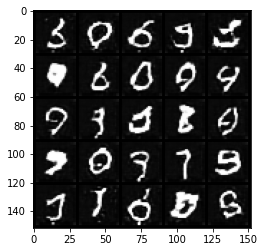

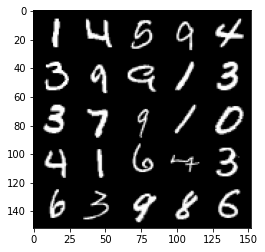

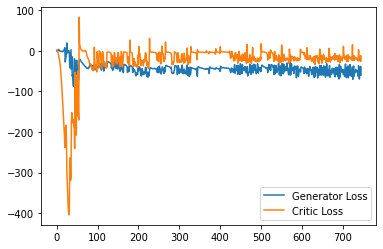

Step 14950: Generator loss: -38.91074780762196, critic loss: -18.8901090798378


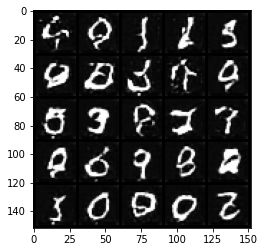

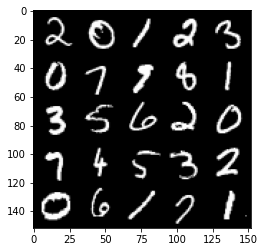

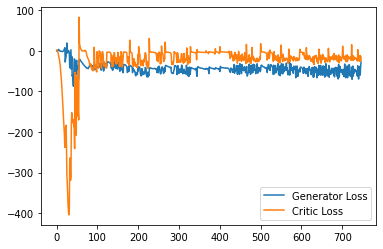

Step 15000: Generator loss: -55.085246810913084, critic loss: -22.585898864269257


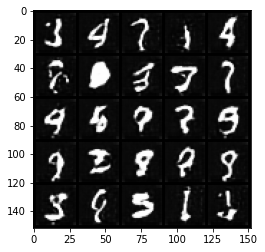

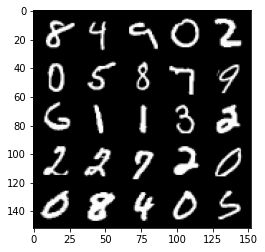

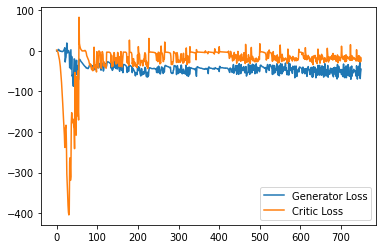

Step 15050: Generator loss: -65.60034271240234, critic loss: -23.22631791782379


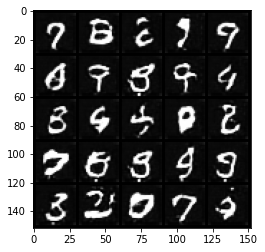

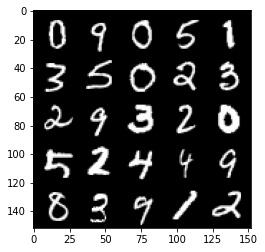

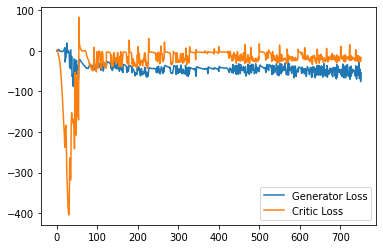

Step 15100: Generator loss: -47.138413200378416, critic loss: -11.146725600242611


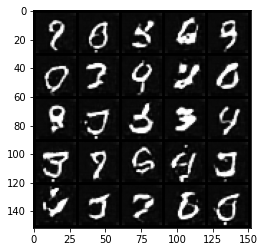

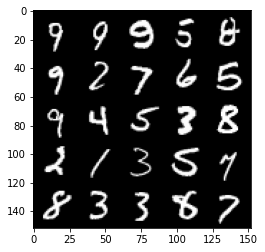

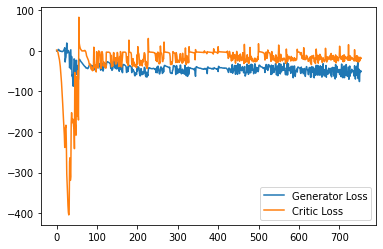

Step 15150: Generator loss: -55.024845123291016, critic loss: -12.07512856268883


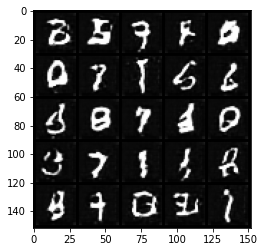

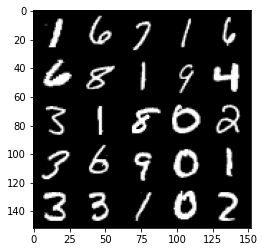

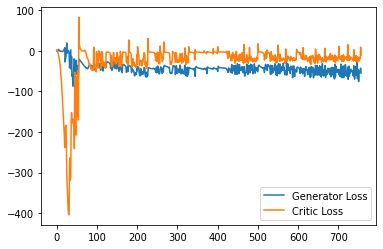

Step 15200: Generator loss: -50.72045539855957, critic loss: -19.957818292140963


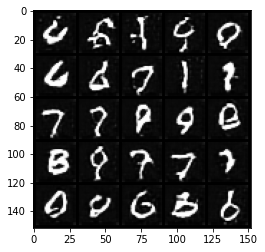

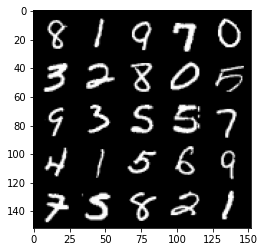

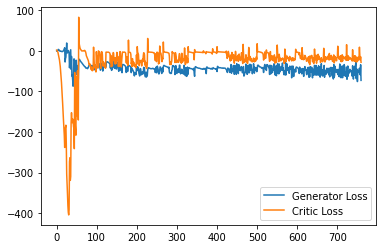

Step 15250: Generator loss: -51.75401767730713, critic loss: -16.28595523118973


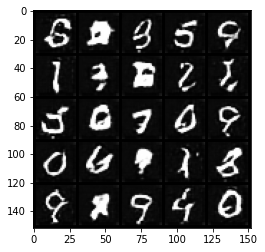

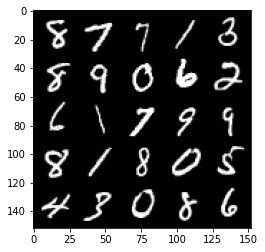

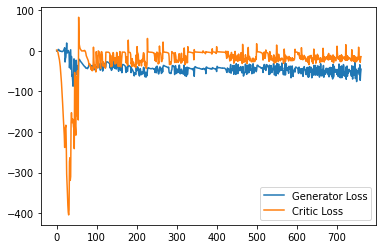

Step 15300: Generator loss: -43.87447238922119, critic loss: -17.367872254133218


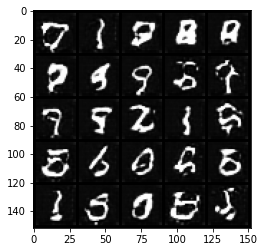

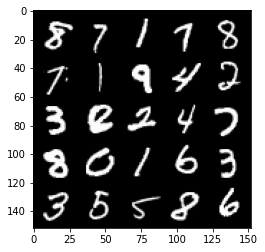

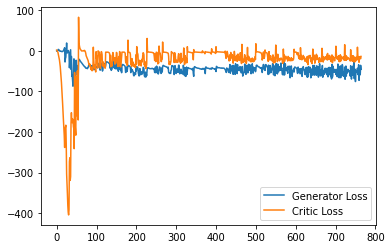

Step 15350: Generator loss: -50.942238883972166, critic loss: -7.826339283943174


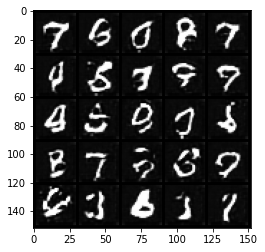

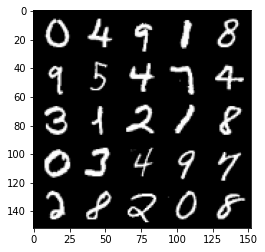

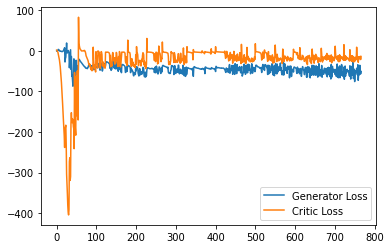

Step 15400: Generator loss: -49.502823944091794, critic loss: -15.988441416740418


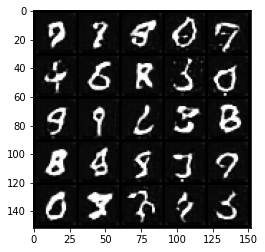

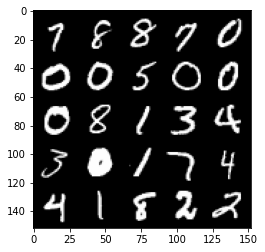

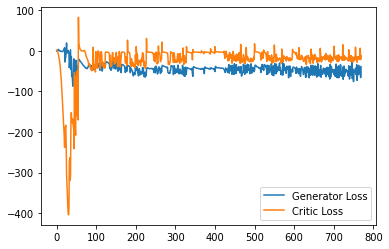

Step 15450: Generator loss: -55.864178848266604, critic loss: -21.82447426462173


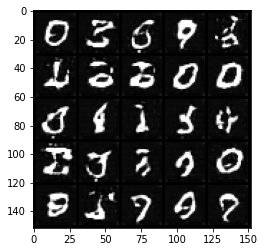

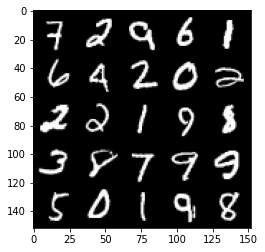

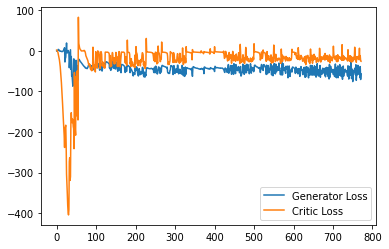

Step 15500: Generator loss: -55.921494846344, critic loss: -15.597778156280516


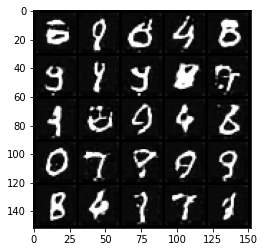

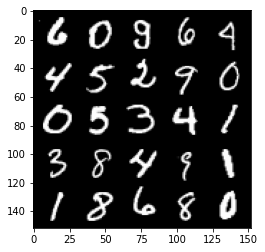

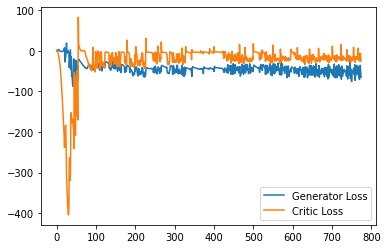

Step 15550: Generator loss: -52.24708526611328, critic loss: -19.019035211324695


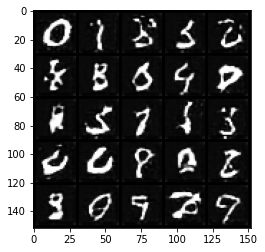

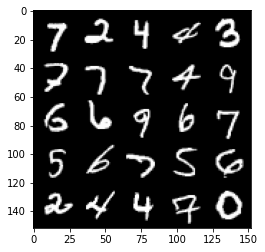

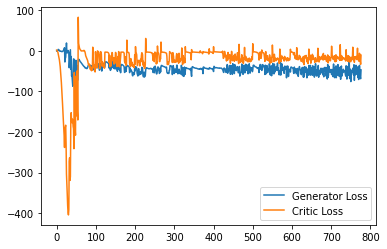

Step 15600: Generator loss: -56.51283615112305, critic loss: -19.93835930550098


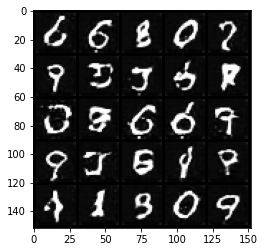

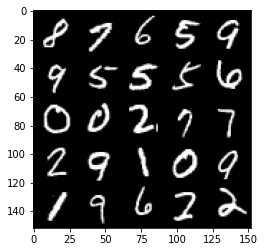

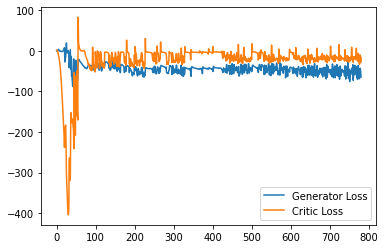

Step 15650: Generator loss: -49.55506023406983, critic loss: -15.805544322967533


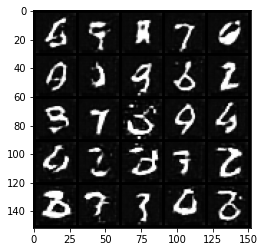

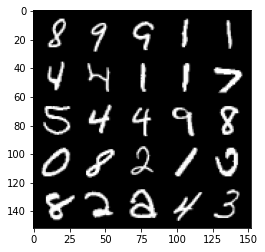

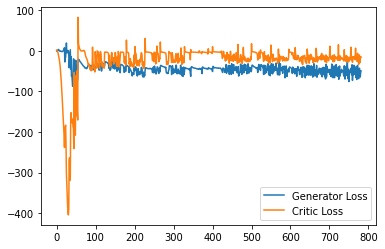

Step 15700: Generator loss: -60.46470706939697, critic loss: -25.151146884441374


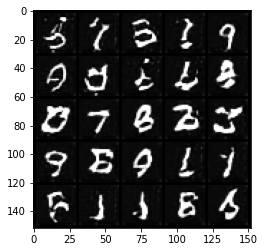

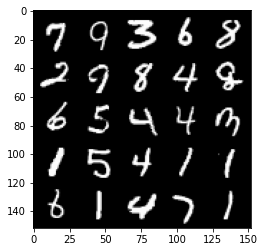

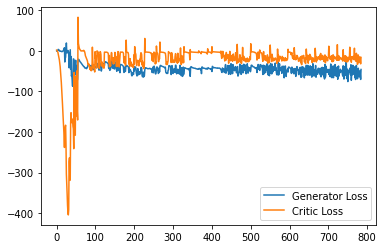

Step 15750: Generator loss: -63.69324882507324, critic loss: -26.600888246774677


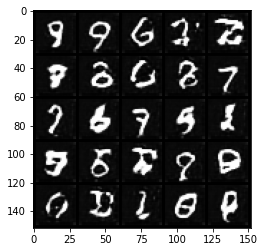

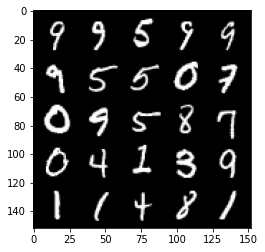

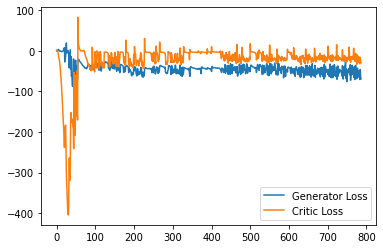

Step 15800: Generator loss: -58.74203182220459, critic loss: -7.397374861896038


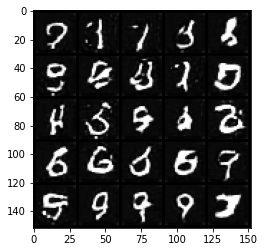

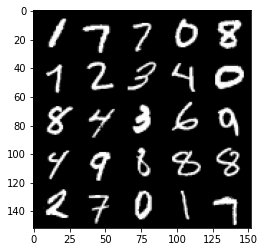

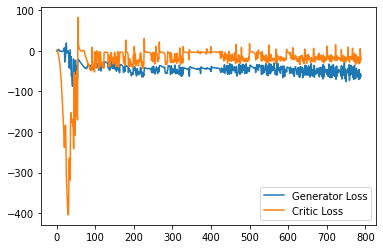

Step 15850: Generator loss: -51.04231567382813, critic loss: -17.200394013404843


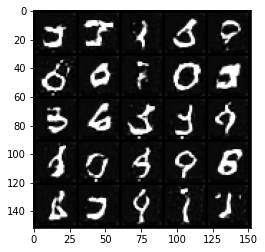

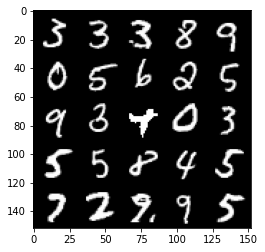

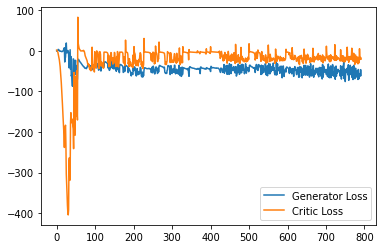

Step 15900: Generator loss: -58.94948440551758, critic loss: -18.653394121527676


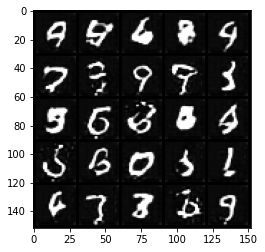

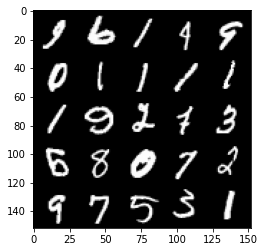

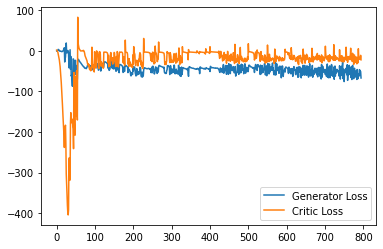

Step 15950: Generator loss: -54.43613151550293, critic loss: -15.527092054843902


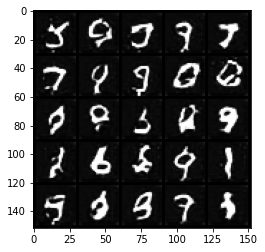

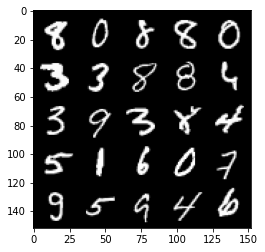

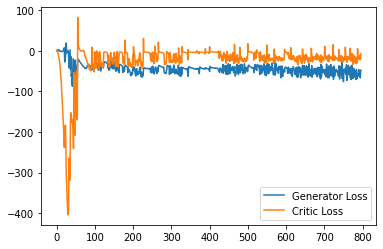

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
